In [43]:
import numpy as np
import random
# import to do training
from tpg.trainer import Trainer
# import to run an agent (always needed)
from tpg.agent import Agent
# faster training
import multiprocessing as mp
# visual tools
from IPython.display import clear_output
import time
import matplotlib.pyplot as plt
# for writing
import csv
from datetime import date

In [50]:
class GridWorld_fig11:
    def __init__ (self, rows, cols, win_state, start_state):
        self.memory = []
        self.memory_position = 0
        self.memory_limit = 20
        self.rows = rows
        self.cols = cols
        self.start_state = start_state
        self.win_state = win_state
        self.current_state = self.start_state
        
    def sample_action (self):
        rand = random.uniform(0, 1)
        if (rand >= 0) and (rand < 0.25):
            return 0
        elif (rand >= 0.25) and (rand < 0.5):
            return 1
        elif (rand >= 0.5) and (rand < 0.75):
            return 2
        else:
            return 3
        
    def reset (self):
        self.current_state = self.start_state
        return self.current_state
        
    # just reset for now...
    def close (self):
        self.current_state = self.start_state
        return 1
    
    def check_win (self):
        if self.current_state == self.win_state:
            return True
        return False
    
    def step (self, action):
        # north
        if action == 0:
            next = (self.current_state[0] - 1, self.current_state[1])
        # south
        elif action == 1:
            next = (self.current_state[0] + 1, self.current_state[1])
        # east
        elif action == 2:
            next = (self.current_state[0], self.current_state[1] + 1)
        # west
        else:
            next = (self.current_state[0], self.current_state[1] - 1)

        terminate = False
        reward = 0
        # check if move is legal
        if (next[0] >= 0 and next[0] <= (self.rows-1)) and (next[1] >= 0 and next[1] <= (self.cols-1)):            
            illegal = 0
            if (next == (1, 2)) or (next == (1, 3)) or (next == (2, 2)) or (next == (2, 3)):
                illegal = 1
                    
            if (illegal == 0):
                self.current_state = next
                reward -= 0.01
            else:
                reward -= 1
        else:
            reward -= 1
            
        # punish repeat states within last 20 states
        if self.current_state in self.memory:
            reward -= 1
        
        if self.check_win():
            reward += 100
            terminate = True
        
        # add new state to memory
        if len(self.memory) <= self.memory_limit:
            (self.memory).append(self.current_state)
        # after memory is full, begin overriding it
        else:
            if self.memory_position < self.memory_limit:
                self.memory[self.memory_position] = self.current_state
                self.memory_position += 1
            else:
                self.memory_position = 0
                self.memory[self.memory_position] = self.current_state
        
        return self.current_state, reward, terminate

In [51]:
def runAgent(args):
    agent = args[0]
    envName = args[1]
    scoreList = args[2]
    numEpisodes = args[3] # number of times to repeat game
    numFrames = args[4] 
    gen = args[5]
    
    # skip if task already done by agent
    if agent.taskDone(envName):
        print('Agent #' + str(agent.agentNum) + ' can skip.')
        scoreList.append((agent.team.id, agent.team.outcomes))
        return
    
    env = GridWorld_fig11(5, 5, (0, 4), (4, 0))
    valActs = 4
    
    # create environment object from above
    scoreTotal = 0
    for ep in range(numEpisodes):
        state = env.reset()
        scoreEp = 0
        states = []
        step_map = np.zeros((10, 10))
        if numEpisodes > 1:
            for i in range(numFrames): # frame loop           
                # action selection
                act = agent.act(state)
                
                state, reward, isDone = env.step(act)
                # for heatmap
                step_map[state] = step_map[state] + 1
                states.append(state)
                #print('State: ' + str(state))
                scoreEp += reward
                
                # win
                if isDone:
                    print('win!')
                    print(states)
                    break
                    
            print('Agent #' + str(agent.agentNum) + 
              ' | Ep #' + str(ep) + ' | Score: ' + str(scoreEp))
            
        scoreTotal += scoreEp
    scoreTotal /= numEpisodes
    env.close()
    agent.reward(scoreTotal, envName)
    scoreList.append((agent.team.id, agent.team.outcomes))
    if isDone:
        return states
    else:
        return 0

In [52]:
# NOTES:
# pAtomic equal to 1 so teams are single nodes
    # starting off, teams don't reference teams
# if the maxTeamSize is set, we can try to maximize the use of actually useful learners.
    # this might help with the consistency of success...
trainer = Trainer(actions=4, teamPopSize=50, pActAtom=1.0, 
                  nRegisters=4, initMaxActProgSize=48, gap=0.5)

envName = 'fig11'
allScores = []
champions = []
for gen in range(500):
    scoreList = []

    agents = trainer.getAgents()

    agent_track = 0
    best_score = -200.0
    curr_champion = []
    for agent in agents:
        run = runAgent([agent, envName, scoreList, 10, 100, gen])
        if (scoreList[agent_track][1][envName] > best_score) and (run != 0):
            best_score = scoreList[agent_track][1][envName]
            curr_champion = run
            print(run)
        agent_track += 1

    champions.append(curr_champion)

    # apply scores, must do this when multiprocessing
    # because agents can't refer to trainer
    teams = trainer.applyScores(scoreList)

    trainer.evolve(tasks=[envName]) # go into next gen

    # an easier way to track stats than the above example
    scoreStats = trainer.fitnessStats

    allScores.append((scoreStats['min'], scoreStats['max'], scoreStats['average']))

    print('Gen: ' + str(gen))
    print('Results so far: ' + str(allScores))

print('Results:\nMin, Max, Avg')
for score in allScores:
    print(score[0],score[1],score[2])

Agent #0 | Ep #0 | Score: -199
Agent #0 | Ep #1 | Score: -200
Agent #0 | Ep #2 | Score: -200
Agent #0 | Ep #3 | Score: -200
Agent #0 | Ep #4 | Score: -200
Agent #0 | Ep #5 | Score: -200
Agent #0 | Ep #6 | Score: -200
Agent #0 | Ep #7 | Score: -200
Agent #0 | Ep #8 | Score: -200
Agent #0 | Ep #9 | Score: -200
Agent #1 | Ep #0 | Score: -192.04
Agent #1 | Ep #1 | Score: -199
Agent #1 | Ep #2 | Score: -200
Agent #1 | Ep #3 | Score: -200
Agent #1 | Ep #4 | Score: -200
Agent #1 | Ep #5 | Score: -200
Agent #1 | Ep #6 | Score: -200
Agent #1 | Ep #7 | Score: -200
Agent #1 | Ep #8 | Score: -200
Agent #1 | Ep #9 | Score: -200
Agent #2 | Ep #0 | Score: -196.01999999999998
Agent #2 | Ep #1 | Score: -199
Agent #2 | Ep #2 | Score: -200
Agent #2 | Ep #3 | Score: -198.01
Agent #2 | Ep #4 | Score: -199
Agent #2 | Ep #5 | Score: -200
Agent #2 | Ep #6 | Score: -200
Agent #2 | Ep #7 | Score: -200
Agent #2 | Ep #8 | Score: -200
Agent #2 | Ep #9 | Score: -200
Agent #3 | Ep #0 | Score: -199
Agent #3 | Ep #1 |

Agent #17 | Ep #0 | Score: -192.04
Agent #17 | Ep #1 | Score: -193.04
Agent #17 | Ep #2 | Score: -193.04
Agent #17 | Ep #3 | Score: -193.04
Agent #17 | Ep #4 | Score: -193.04
Agent #17 | Ep #5 | Score: -193.04
Agent #17 | Ep #6 | Score: -193.04
Agent #17 | Ep #7 | Score: -193.04
Agent #17 | Ep #8 | Score: -193.04
Agent #17 | Ep #9 | Score: -193.04
Agent #18 | Ep #0 | Score: -199
Agent #18 | Ep #1 | Score: -200
Agent #18 | Ep #2 | Score: -200
Agent #18 | Ep #3 | Score: -200
Agent #18 | Ep #4 | Score: -200
Agent #18 | Ep #5 | Score: -200
Agent #18 | Ep #6 | Score: -200
Agent #18 | Ep #7 | Score: -200
Agent #18 | Ep #8 | Score: -200
Agent #18 | Ep #9 | Score: -200
Agent #19 | Ep #0 | Score: -199
Agent #19 | Ep #1 | Score: -200
Agent #19 | Ep #2 | Score: -200
Agent #19 | Ep #3 | Score: -200
Agent #19 | Ep #4 | Score: -200
Agent #19 | Ep #5 | Score: -200
Agent #19 | Ep #6 | Score: -200
Agent #19 | Ep #7 | Score: -200
Agent #19 | Ep #8 | Score: -200
Agent #19 | Ep #9 | Score: -200
Agent #20 

Agent #42 | Ep #9 | Score: -200
Agent #43 | Ep #0 | Score: -199
Agent #43 | Ep #1 | Score: -200
Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -200
Agent #43 | Ep #4 | Score: -200
Agent #43 | Ep #5 | Score: -200
Agent #43 | Ep #6 | Score: -200
Agent #43 | Ep #7 | Score: -200
Agent #43 | Ep #8 | Score: -200
Agent #43 | Ep #9 | Score: -200
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -196.01999999999998
Agent #45 | Ep #1 | Score: -199
Agent #45 | Ep #2 | Score: -195.03000000000003
Agent #45 | Ep #3 | Score: -199
Agent #45 | Ep #4 | Score: -200
Agent #45 | Ep #5 | Score: -200
Agent #45 | Ep #6 | Score: -200
Agent #45 | Ep #7 | Score: -200
Agent #45 | 

Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -199
Agent #34 | Ep #1 | Score: -192.04000000000002
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -199
Agent #35 | Ep #1 | Score: -200
Agent #35 | Ep #2 | Score: -200
Agent #35 | Ep #3 | Score: -200
Agent #35 | Ep #4 | Score: -200
Agent #35 | Ep #5 | Score: -200
Agent #35 | Ep #6 | Score: -200
Agent #35 | Ep #7 | Score: -200
Agent #35 | Ep #8 | Score: -200
Agent #35 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0,

Agent #34 | Ep #0 | Score: -199
Agent #34 | Ep #1 | Score: -200
Agent #34 | Ep #2 | Score: -200
Agent #34 | Ep #3 | Score: -200
Agent #34 | Ep #4 | Score: -200
Agent #34 | Ep #5 | Score: -200
Agent #34 | Ep #6 | Score: -200
Agent #34 | Ep #7 | Score: -200
Agent #34 | Ep #8 | Score: -200
Agent #34 | Ep #9 | Score: -200
Agent #35 | Ep #0 | Score: -149.49000000000004
Agent #35 | Ep #1 | Score: -151.49000000000004
Agent #35 | Ep #2 | Score: -151.49000000000004
Agent #35 | Ep #3 | Score: -151.49000000000004
Agent #35 | Ep #4 | Score: -151.49000000000004
Agent #35 | Ep #5 | Score: -151.49000000000004
Agent #35 | Ep #6 | Score: -151.49000000000004
Agent #35 | Ep #7 | Score: -151.49000000000004
Agent #35 | Ep #8 | Score: -151.49000000000004
Agent #35 | Ep #9 | Score: -151.49000000000004
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04


Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -185.07999999999996
Agent #30 | Ep #5 | Score: -200
Agent #30 | Ep #6 | Score: -200
Agent #30 | Ep #7 | Score: -200
Agent #30 | Ep #8 | Score: -200
Agent #30 | Ep #9 | Score: -200
Agent #31 | Ep #0 | Score: -199
Agent #31 | Ep #1 | Score: -200
Agent #31 | Ep #2 | Score: -200
Agent #31 | Ep #3 | Score: -200
Agent #31 | Ep #4 | Score: -200
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: 

Agent #29 | Ep #2 | Score: -192.04000000000002
Agent #29 | Ep #3 | Score: -192.04000000000002
Agent #29 | Ep #4 | Score: -192.04000000000002
Agent #29 | Ep #5 | Score: -192.04000000000002
Agent #29 | Ep #6 | Score: -192.04000000000002
Agent #29 | Ep #7 | Score: -192.04000000000002
Agent #29 | Ep #8 | Score: -192.04000000000002
Agent #29 | Ep #9 | Score: -192.04000000000002
Agent #30 | Ep #0 | Score: -149.49000000000004
Agent #30 | Ep #1 | Score: -151.49000000000004
Agent #30 | Ep #2 | Score: -151.49000000000004
Agent #30 | Ep #3 | Score: -151.49000000000004
Agent #30 | Ep #4 | Score: -151.49000000000004
Agent #30 | Ep #5 | Score: -151.49000000000004
Agent #30 | Ep #6 | Score: -151.49000000000004
Agent #30 | Ep #7 | Score: -151.49000000000004
Agent #30 | Ep #8 | Score: -151.49000000000004
Agent #30 | Ep #9 | Score: -151.49000000000004
Agent #31 | Ep #0 | Score: -199
Agent #31 | Ep #1 | Score: -200
Agent #31 | Ep #2 | Score: -200
Agent #31 | Ep #3 | Score: -200
Agent #31 | Ep #4 | Score:

Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -199
Agent #45 | Ep #7 | Score: -200
Agent #45 | Ep #8 | Score: -200
Agent #45 | Ep #9 | Score: -200
Agent #46 | Ep #0 | Score: -199
Agent #46 | Ep #1 | Score: -200
Agent #46 | Ep #2 | Score: -200
Agent #46 | Ep #3 | Score: -200
Agent #46 | Ep #4 | Score: -200
Agent #46 | Ep #5 | Score: -200
Agent #46 | Ep #6 | Score: -200
Agent #46 | Ep #7 | Score: -200
Agent #46 | Ep #8 | Score: -200
Agent #46 | Ep #9 | Score: -200
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -199
Agent #48 | Ep #1 | Score: -20

Agent #35 | Ep #8 | Score: -103.97000000000016
Agent #35 | Ep #9 | Score: -103.97000000000016
Agent #36 | Ep #0 | Score: -199
Agent #36 | Ep #1 | Score: -200
Agent #36 | Ep #2 | Score: -200
Agent #36 | Ep #3 | Score: -200
Agent #36 | Ep #4 | Score: -200
Agent #36 | Ep #5 | Score: -200
Agent #36 | Ep #6 | Score: -200
Agent #36 | Ep #7 | Score: -200
Agent #36 | Ep #8 | Score: -200
Agent #36 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
A

Gen: 6
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002)]
Agent #0 can skip.
None
Agent #1 can skip.
None
Agent #2 can skip.
None
Agent #3 can skip.
None
Agent #4 can skip.
Agent #5 can skip.
Agent #6 can skip.
None
Agent #7 can skip.
Agent #8 can skip.
Agent #9 can skip.
Agent #10 can skip.
Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
Agent #25 | Ep #0 | Score: -199
Agent #25 | Ep #1 | Score: -192.04000000000002
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -200


Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -132.6600000000001
Agent #43 | Ep #1 | Score: -134.6600000000001
Agent #43 | Ep #2 | Score: -133.67000000000013
Agent #43 | Ep #3 | Score: -134.6600000000001
Agent #43 | Ep #4 | Score: -134.6600000000001
Agent #43 | Ep #5 | Score: -133.67000000000013
Agent #43 | Ep #6 | Score: -134.6600000000001
Agent #43 | Ep #7 | Score: -134.6600000000001
Agent #43 | Ep #8 | Score: -133.67000000000013
Agent #43 | Ep #9 | Score: -134.6600000000001
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -192.04000000000002


Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (

Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent 

Agent #33 | Ep #0 | Score: -191.04
Agent #33 | Ep #1 | Score: -192.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -192.04
Agent #33 | Ep #4 | Score: -192.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -192.04
Agent #34 | Ep #0 | Score: -199
Agent #34 | Ep #1 | Score: -200
Agent #34 | Ep #2 | Score: -200
Agent #34 | Ep #3 | Score: -142.57000000000008
Agent #34 | Ep #4 | Score: -101.99000000000015
Agent #34 | Ep #5 | Score: -101.99000000000015
Agent #34 | Ep #6 | Score: -101.99000000000015
Agent #34 | Ep #7 | Score: -101.99000000000015
Agent #34 | Ep #8 | Score: -101.99000000000015
Agent #34 | Ep #9 | Score: -101.99000000000015
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | 

Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -177.15999999999988
Agent #33 | Ep #4 | Score: -150.5
Agent #33 | Ep #5 | Score: -150.5
Agent #33 | Ep #6 | Score: -138.54000000000008
Agent #33 | Ep #7 | Score: -138.54000000000005
Agent #33 | Ep #8 | S

Agent #43 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 84.92
win!
[(3

Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | 

Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1,

Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Ag

Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -192.04
Agent #41 | Ep #4 | Score: -147.49000000000007
Agent #41 | Ep #5 | Score: -131.67000000000013
Agent #41 | Ep #6 | Score: -135.65000000000012
Agent #41 | Ep #7 | Score: -134.6600000000001
Agent #41 | Ep #8 | Score: -133.67000000000013
Agent #41 | Ep #9 | Score: -135.65000000000012
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4),

Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -199
Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (

Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -192.04
Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 14
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.6

Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -127.68000000000013
Agent #36 | Ep #1 | Score: -126.70000000000014
Agent #36 | Ep #2 | Score: -128.70000000000013
Agent #36 | Ep #3 | Score: -129.68000000000015
Agent #36 | Ep #4 | Score: -132.6600000000001
Agent #36 | Ep #5 | Score: -133.67000000000013
Agent #36 | Ep #6 | Score: -135.65000000000012
Agent #36 | Ep #7 | Score: -134.6600000000001
Agent #36 | Ep #8 | Score: -133.67000000000013
Agent #36 | Ep #9 | Score: -135.65000000000012
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0

Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -199
Agent #28 | Ep #1 | Score: -200
Agent #28 | Ep #2 | Score: -200
Agent #28 | Ep #3 | Score: -200
Agent #28 | Ep #4 | Score: -200
Agent #28 | Ep #5 | Score: -200
Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (

Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Sco

Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #27 | Ep #3 | Score: -185.07999999999998
Agent #27 | Ep #4 | Score: -200
Agent #27 | Ep #5 | Score: -200
Agent #27 | Ep #6 | Score: -200
Agent #27 | Ep #7 | Score: -200
Agent #27 | Ep #8 | Score: -200
Agent #27 | Ep #9 | Score: -200
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 30.919999999999987
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1

Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -143.5000000000001
Agent #32 | Ep #4 | Score: -134.6600000000001
Agent #32 | Ep #5 | Score: -133.67000000000013
Agent #32 | Ep #6 | Score: -134.6600000000001
Agent #32 | Ep #7 | Score: -134.6600000000001
Agent #32 | Ep #8 | Score: -133.67000000000013
Agent #32 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3),

Agent #41 | Ep #3 | Score: -101.00000000000014
Agent #41 | Ep #4 | Score: -101.00000000000014
Agent #41 | Ep #5 | Score: -101.00000000000014
Agent #41 | Ep #6 | Score: -101.00000000000014
Agent #41 | Ep #7 | Score: -101.00000000000014
Agent #41 | Ep #8 | Score: -101.00000000000014
Agent #41 | Ep #9 | Score: -101.00000000000014
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4

Agent #29 | Ep #5 | Score: -134.6600000000001
Agent #29 | Ep #6 | Score: -133.67000000000013
Agent #29 | Ep #7 | Score: -134.6600000000001
Agent #29 | Ep #8 | Score: -134.6600000000001
Agent #29 | Ep #9 | Score: -133.67000000000013
Agent #30 | Ep #0 | Score: -190.05
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -132.6600000000001
Agent #40 | Ep #1 | Score: -134.6600000000001
Agent #40 | Ep #2 | Score: -133.67000000000013
Agent #40 | Ep #3 | Score: -134.6600000000001
Agent #40 | Ep #4 | Score: -134.6600000000001
Agent #40 | Ep #5 | Score: -133.67000000000013
Agent #40 | Ep #6 | Score: -134.6600000000001
Agent #40 | Ep #7 | Score: -134.6600000000001
Agent #40 | Ep #8 | Score: -133.67000000000013
Agent #40 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1

Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -132.6600000000001
Agent #28 | Ep #1 | Score: -134.6600000000001
Agent #28 | Ep #2 | Score: -133.67000000000013
Agent #28 | Ep #3 | Score: -134.6600000000001
Agent #28 | Ep #4 | Score: -134.6600000000001
Agent #28 | Ep #5 | Score: -133.67000000000013
Agent #28 | Ep #6 | Score: -134.6600000000001
Agent #28 | Ep #7 | Score: -134.6600000000001
Agent #28 | Ep #8 | Score: -133.67000000000013
Agent #28 | Ep #9 | Score: -134.6600000000001
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | 

Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 66.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 88.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 

Agent #28 | Ep #2 | Score: -187.06999999999996
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -199
Agent #28 | Ep #5 | Score: -200
Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1

Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4),

Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 30.92
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score:

Gen: 23
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1

Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -185.07999999999998
Agent #39 | Ep #4 | Score: -200
Agent #39 | Ep #5 | Score: -200
Agent #39 | Ep #6 | Score: -200
Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -191.04
Agent #41 | Ep #1 | Score:

Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
A

Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -192.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 84.92
wi

Agent #43 | Ep #7 | Score: -192.04000000000002
Agent #43 | Ep #8 | Score: -192.04000000000002
Agent #43 | Ep #9 | Score: -192.04000000000002
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: -5.0800000000000125
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 88.92
win!
[(3

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1,

Agent #38 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score:

Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 28
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (

Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -189.07000000000002
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -194.03999999999996
Agent #43 | Ep #3 | Score: -185.07999999999998
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0,

Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: -7.0800000000000125
Agent #27 | Ep #3 | Score: -192.04
Agent #27 | Ep #4 | Score: -188.07999999999996
Agent #27 | Ep #5 | Score: -149.48000000000005
Agent #27 | Ep 

Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 66.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 94.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 84.92
win!
[(3

Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 63.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4

Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 18.919999999999987
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 89.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 85.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0,

Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0,

Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 81.86
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 69.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1),

Gen: 33
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

Agent #41 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 84.92
win!
[(3

Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | 

Agent #39 | Ep #6 | Score: -135.65000000000012
Agent #39 | Ep #7 | Score: -134.6600000000001
Agent #39 | Ep #8 | Score: -133.67000000000013
Agent #39 | Ep #9 | Score: -135.65000000000012
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -192.04
Agent #40 | Ep #3 | Score: -192.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -192.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -192.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #4

Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -132.6600000000001
Agent #30 | Ep #1 | Score: -134.6600000000001
Agent #30 | Ep #2 | Score: -133.67000000000013
Agent #30 | Ep #3 | Score: -134.6600000000001
Agent #30 | Ep #4 | Score: -134.6600000000001
Agent #30 | Ep #5 | Score: -133.67000000000013
Agent #30 | Ep #6 | Score: -134.6600000000001
Agent #30 | Ep #7 | Score: -134.6600000000001
Agent #30 | Ep #8 | Score: -133.67000000000013
Agent #30 | Ep #9 | Score: -134.6600000000001
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -143.5000000000001
Agent #31 | Ep #6 | Score: -134.6600000000001
Agent #31 | Ep #7 | Score: -133.67000000000013
Agent #31 | Ep #8 | Score: -134.6600000000001
Agent #31 | Ep #9 | Score: -134.6600000000001
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score:

Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #25 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 

Agent #39 | Ep #1 | Score: -192.04
Agent #39 | Ep #2 | Score: -192.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -192.04
Agent #39 | Ep #5 | Score: -192.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -192.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2),

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (

Agent #41 | Ep #4 | Score: -134.6600000000001
Agent #41 | Ep #5 | Score: -133.67000000000013
Agent #41 | Ep #6 | Score: -134.6600000000001
Agent #41 | Ep #7 | Score: -134.6600000000001
Agent #41 | Ep #8 | Score: -133.67000000000013
Agent #41 | Ep #9 | Score: -134.6600000000001
Agent #42 | Ep #0 | Score: -123.67000000000013
Agent #42 | Ep #1 | Score: -127.67000000000014
Agent #42 | Ep #2 | Score: -124.68000000000013
Agent #42 | Ep #3 | Score: -126.67000000000014
Agent #42 | Ep #4 | Score: -127.67000000000014
Agent #42 | Ep #5 | Score: -124.68000000000013
Agent #42 | Ep #6 | Score: -126.67000000000014
Agent #42 | Ep #7 | Score: -126.67000000000013
Agent #42 | Ep #8 | Score: -123.68000000000013
Agent #42 | Ep #9 | Score: -126.67000000000014
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 91.91999999999999


Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 83.9

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]


Agent #42 | Ep #7 | Score: -192.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -192.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0,

Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: -73.07999999999997
win!
[(4, 1), (3, 1),

Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2

Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -99.99000000000014
Agent #27 | Ep #1 | Score: -101.99000000000015
Agent #27 | Ep #2 | Score: -101.99000000000015
Agent #27 | Ep #3 | Score: -113.84000000000007
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 65.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 64.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4

Agent #41 | Ep #6 | Score: -134.6600000000001
Agent #41 | Ep #7 | Score: -134.6600000000001
Agent #41 | Ep #8 | Score: -133.67000000000013
Agent #41 | Ep #9 | Score: -134.6600000000001
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 

Gen: 43
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2,

Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -133.65000000000012
Agent #48 | Ep #1 | Score: -134.6600000000001
Agent #48 | Ep #2 | Score: -133.67000000000013
Agent #48 | Ep #3 | Score: -134.6600000000001
Agent #48 | Ep #4 | Score: -134.6600000000001
Agent #48 | Ep #5 | Score: -133.67000000000013
Agent #48 | Ep #6 | Score: -134.6600000000001
Agent #48 | Ep #7 | Score: -134.6600000000001
Agent #48 | Ep #8 | Score: -133.67000000000013
Agent #48 | Ep #9 | Score: -134.6600000000001
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -192.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 |

Agent #33 | Ep #4 | Score: -192.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4

Agent #45 | Ep #0 | Score: -199
Agent #45 | Ep #1 | Score: -200
Agent #45 | Ep #2 | Score: -200
Agent #45 | Ep #3 | Score: -200
Agent #45 | Ep #4 | Score: -200
Agent #45 | Ep #5 | Score: -154.45000000000005
Agent #45 | Ep #6 | Score: -134.6600000000001
Agent #45 | Ep #7 | Score: -134.6600000000001
Agent #45 | Ep #8 | Score: -133.67000000000013
Agent #45 | Ep #9 | Score: -134.6600000000001
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47

Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -192.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3,

Agent #25 | Ep #4 | Score: -192.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -192.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4

Agent #39 | Ep #4 | Score: -200
Agent #39 | Ep #5 | Score: -200
Agent #39 | Ep #6 | Score: -200
Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Age

Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 83.92

Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #30 | Ep #2 | Score: -133.67000000000013
Agent #30 | Ep #3 | Score: -134.6600000000001
Agent #30 | Ep #4 | Score: -134.6600000000001
Agent #30 | Ep #5 | Score: -133.67000000000013
Agent #30 | Ep #6 | Score: -134.6600000000001
Agent #30 | Ep #7 | Score: -134.6600000000001
Agent #30 | Ep #8 | Score: -133.67000000000013
Agent #30 | Ep #9 | Score: -134.6600000000001
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score:

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score: 83.92
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 83.92
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 

Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -186.09999999999994
Agent #26 | Ep #7 | Score: -178.2
Agent #26 | Ep #8 | Score: -178.2
Agent #26 | Ep #9 | Score: -177.19999999999996
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent

Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 84.92
win!
[(4

Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -199
Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (

Agent #45 | Ep #4 | Score: -135.65000000000012
Agent #45 | Ep #5 | Score: -134.6600000000001
Agent #45 | Ep #6 | Score: -133.67000000000013
Agent #45 | Ep #7 | Score: -135.65000000000012
Agent #45 | Ep #8 | Score: -134.6600000000001
Agent #45 | Ep #9 | Score: -133.67000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 

Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
Agent #30 | Ep #0 | Score: -199
Agent #30 | Ep #1 | Score: -200
Agent #30 | Ep #2 | Score: -200
Agent #30 | Ep #3 | Score: -200
Agent #30 | Ep #4 | Score: -200
Agent #30 | Ep #5 | Score: -200
Agent #30 | Ep #6 | Score: -200
Agent #30 | Ep #7 | Score: -200
Agent #30 | Ep #8 | Score: -200
Agent #30 | Ep #9 | Score: -200
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (

Agent #45 | Ep #0 | Score: -186.07
Agent #45 | Ep #1 | Score: -192.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -199
Agent #47 | Ep #1 | Score: -200
Agent #47 | Ep #2 | Score: -196.01999999999998
Agent #47 | Ep #3 | Score: -106.92000000000017
Agent #47 | Ep #4 | Score: -100.99000000000015
Agent #47 | Ep #5 | Score: -122.77000000000012
Agent #47 | Ep #6 | Score: -134.6600000000001
Ag

Agent #32 | Ep #7 | Score: -192.04000000000002
Agent #32 | Ep #8 | Score: -192.04000000000002
Agent #32 | Ep #9 | Score: -192.04000000000002
Agent #33 | Ep #0 | Score: -191.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -192.04
Agent #33 | Ep #3 | Score: -192.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -192.04
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -192.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0

Agent #43 | Ep #6 | Score: -124.68000000000013
Agent #43 | Ep #7 | Score: -126.67000000000014
Agent #43 | Ep #8 | Score: -127.67000000000014
Agent #43 | Ep #9 | Score: -123.68000000000013
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -192.04
Agent #44 | Ep #3 | Score: -192.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -192.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -192.04
Agent #44 | Ep #9 | Score: -192.04
Agent #45 | Ep #0 | Score: -199
Agent #45 | Ep #1 | Score: -200
Agent #45 | Ep #2 | Score: -200
Agent #45 | Ep #3 | Score: -200
Agent #45 | Ep #4 | Score: -200
Agent #45 | Ep #5 | Score: -200
Agent #45 | Ep #6 | Score: -200
Agent #45 | Ep #7 | Score: -200
Agent #45 | Ep #8 | Score: -200
Agent #45 | Ep #9 | Score: -200
Agent #46 | Ep #0 | Score: -191.04
Agent #46 | Ep #1 | Score: -192.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -192.04
Ag

Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -121.68000000000013
Agent #35 | Ep #1 | Score: -126.67000000000014
Agent #35 | Ep #2 | Score: -127.67000000000014
Agent #35 | Ep #3 | Score: -124.68000000000013
Agent #35 | Ep #4 | Score: -126.67000000000014
Agent #35 | Ep #5 | Score: -127.67000000000014
Agent #35 | Ep #6 | Score: -124.68000000000013
Agent #35 | Ep #7 | Score: -126.67000000000014
Agent #35 | Ep #8 | Score: -127.67000000000014
Agent #35 | Ep #9 | Score: -123.68000000000013
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 

Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -191.04
Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -192.04
win!
[(4, 0), (4, 1), (4, 1), (4, 1), (4, 2), (4, 2), (4, 2), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 2), (4, 1), (4, 2), (4, 1), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: -1.4000000000000767
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), 

Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1,

Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -191.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -192.04
Agent #45 | Ep #3 | Score: -192.04
Agent #45 | Ep #4 | Score: -160.3499999999999
Agent #45 | Ep #5 | Score: -124.68000000000013
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4)

Agent #28 | Ep #3 | Score: -117.77000000000024
Agent #28 | Ep #4 | Score: -101.98000000000015
Agent #28 | Ep #5 | Score: -102.98000000000016
Agent #28 | Ep #6 | Score: -101.98000000000015
Agent #28 | Ep #7 | Score: -101.98000000000015
Agent #28 | Ep #8 | Score: -102.98000000000016
Agent #28 | Ep #9 | Score: -101.98000000000015
Agent #29 | Ep #0 | Score: -191.04
Agent #29 | Ep #1 | Score: -192.04
Agent #29 | Ep #2 | Score: -192.04
Agent #29 | Ep #3 | Score: -192.04
Agent #29 | Ep #4 | Score: -192.04
Agent #29 | Ep #5 | Score: -192.04
Agent #29 | Ep #6 | Score: -192.04
Agent #29 | Ep #7 | Score: -192.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1

Agent #39 | Ep #7 | Score: -134.6600000000001
Agent #39 | Ep #8 | Score: -134.6600000000001
Agent #39 | Ep #9 | Score: -133.67000000000013
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), 

Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
Agent #30 | Ep #0 | Score: -120.70000000000013
Agent #30 | Ep #1 | Score: -120.71000000000014
Agent #30 | Ep #2 | Score: -124.69000000000013
Agent #30 | Ep #3 | Score: -121.70000000000013
Agent #30 | Ep #4 | Score: -119.71000000000014
Agent #30 | Ep #5 | Score: -123.69000000000013
Agent #30 | Ep #6 | Score: -121.70000000000013
Agent #30 | Ep #7 | Score: -120.71000000000014
Agent #30 | Ep #8 | Score: -123.69000000000013
Agent #30 | Ep #9 | Score: -120.70000000000013
Agent #31 | Ep #0 | Score: -199
Agent #31 | Ep #1 | Score: -200
Agent #31 | Ep #2 | Score: -200
Agent #31 | Ep #3 | Score: -200
Agent #31 | Ep #4 | Score: -200
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 

Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 22.919999999999987
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 88.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1

Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #46 | Ep #7 | Score: -200
Agent #46 | Ep #8 | Score: -200
Agent #46 | Ep #9 | Score: -200
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 

Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2,

Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 66.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #7 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #9 | Score: 84.91999999999999


Agent #26 | Ep #5 | Score: -200
Agent #26 | Ep #6 | Score: -200
Agent #26 | Ep #7 | Score: -200
Agent #26 | Ep #8 | Score: -200
Agent #26 | Ep #9 | Score: -200
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4),

Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -182.1399999999999
Agent #39 | Ep #7 | Score: -127.70000000000014
Agent #39 | Ep #8 | Score: -128.69000000000014
Agent #39 | Ep #9 | Score: -128.70000000000013
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), 

Agent #49 | Ep #1 | Score: -126.71000000000014
Agent #49 | Ep #2 | Score: -129.69000000000014
Agent #49 | Ep #3 | Score: -127.70000000000014
Agent #49 | Ep #4 | Score: -126.71000000000014
Agent #49 | Ep #5 | Score: -129.69000000000014
Agent #49 | Ep #6 | Score: -127.70000000000014
Agent #49 | Ep #7 | Score: -126.71000000000014
Agent #49 | Ep #8 | Score: -129.69000000000014
Agent #49 | Ep #9 | Score: -127.70000000000014
Gen: 62
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.9229200

Agent #34 | Ep #4 | Score: -192.04
Agent #34 | Ep #5 | Score: -192.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -192.04
Agent #34 | Ep #8 | Score: -192.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0

Agent #48 | Ep #8 | Score: -192.04
Agent #48 | Ep #9 | Score: -192.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 63
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.9229200000

Agent #31 | Ep #6 | Score: -133.67000000000013
Agent #31 | Ep #7 | Score: -134.6600000000001
Agent #31 | Ep #8 | Score: -134.6600000000001
Agent #31 | Ep #9 | Score: -133.67000000000013
Agent #32 | Ep #0 | Score: -199
Agent #32 | Ep #1 | Score: -200
Agent #32 | Ep #2 | Score: -200
Agent #32 | Ep #3 | Score: -200
Agent #32 | Ep #4 | Score: -200
Agent #32 | Ep #5 | Score: -200
Agent #32 | Ep #6 | Score: -200
Agent #32 | Ep #7 | Score: -200
Agent #32 | Ep #8 | Score: -200
Agent #32 | Ep #9 | Score: -200
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -191.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -185.07999999999996
Agent #34 | Ep #3 | Score: 

Agent #46 | Ep #7 | Score: -124.70000000000013
Agent #46 | Ep #8 | Score: -121.71000000000014
Agent #46 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3),

Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -188.08
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -192.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -192.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -192.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0)

Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3,

Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 65
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.

Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]


win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (

Agent #26 | Ep #1 | Score: -192.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -192.04
Agent #26 | Ep #4 | Score: -192.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -192.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -192.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -121.68000000000013
Agent #28 | Ep #1 | Score: -126.67000000000014
Agent #28 | Ep #2 | Score: -127.67000000000014
Agent #28 | Ep #3 | Score: -124.68000000000013
Agent #28 | Ep #4 | Score: -126.67000000000014
Agent #28 | Ep #5 | Score: -127.67000000000014
Agent #28 | Ep #6 | Score: -124.68000000000013
Agent 

Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 8.919999999999987
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0,

Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -192.04
Agent #30 | Ep #4 | Score: -192.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -192.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -192.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2)

Agent #40 | Ep #6 | Score: -126.67000000000014
Agent #40 | Ep #7 | Score: -126.67000000000013
Agent #40 | Ep #8 | Score: -123.68000000000013
Agent #40 | Ep #9 | Score: -126.67000000000014
Agent #41 | Ep #0 | Score: -191.04
Agent #41 | Ep #1 | Score: -192.04
Agent #41 | Ep #2 | Score: -192.04
Agent #41 | Ep #3 | Score: -100.96000000000015
Agent #41 | Ep #4 | Score: -97.99000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 

Gen: 68
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

Agent #32 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score: 83.92
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -189.05999999999997
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -199
Agent #33 | Ep #5 | Score: -193.04000000000002
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1)

Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 26.919999999999987
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (

Agent #31 | Ep #3 | Score: -200
Agent #31 | Ep #4 | Score: -200
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -149.4699999999999
Agent #32 | Ep #3 | Score: -97.00000000000014
Agent #32 | Ep #4 | Score: -101.00000000000014
Agent #32 | Ep #5 | Score: -101.00000000000014
Agent #32 | Ep #6 | Score: -101.00000000000014
Agent #32 | Ep #7 | Score: -101.00000000000014
Agent #32 | Ep #8 | Score: -101.00000000000014
Agent #32 | Ep #9 | Score: -101.00000000000014
Agent #33 | Ep #0 | Score: -191.04000000000002
Agent #33 | Ep #1 | Score: -192.04000000000002
Agent #33 | Ep #2 | Score: -192.04000000000002
Agent #33 | Ep #3 | Score: -192.04000000000002
Agent #33 | Ep #4 | Score: -192.04000000000002
Agent #33 | Ep #5 | Score: -192.04000000000002
Agent #33 | Ep #6 | Score: -192.04000000000002
Age

Agent #27 | Ep #4 | Score: -192.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -192.04
Agent #27 | Ep #7 | Score: -192.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -192.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 

Agent #40 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep

Agent #30 | Ep #8 | Score: -127.67000000000014
Agent #30 | Ep #9 | Score: -123.68000000000013
Agent #31 | Ep #0 | Score: -120.70000000000012
Agent #31 | Ep #1 | Score: -122.71000000000014
Agent #31 | Ep #2 | Score: -124.69000000000013
Agent #31 | Ep #3 | Score: -122.70000000000013
Agent #31 | Ep #4 | Score: -122.71000000000014
Agent #31 | Ep #5 | Score: -123.69000000000013
Agent #31 | Ep #6 | Score: -122.70000000000013
Agent #31 | Ep #7 | Score: -122.71000000000014
Agent #31 | Ep #8 | Score: -124.69000000000013
Agent #31 | Ep #9 | Score: -122.70000000000013
Agent #32 | Ep #0 | Score: -124.67000000000013
Agent #32 | Ep #1 | Score: -124.68000000000013
Agent #32 | Ep #2 | Score: -126.67000000000014
Agent #32 | Ep #3 | Score: -127.67000000000014
Agent #32 | Ep #4 | Score: -124.68000000000013
Agent #32 | Ep #5 | Score: -126.67000000000014
Agent #32 | Ep #6 | Score: -127.67000000000014
Agent #32 | Ep #7 | Score: -124.68000000000013
Agent #32 | Ep #8 | Score: -126.67000000000014
Agent #32 | E

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 90.91999999999999
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 72
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.618479999999

Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -97.98000000000013
Agent #29 | Ep #1 | Score: -101.98000000000015
Agent #29 | Ep #2 | Score: -101.98000000000015
Agent #29 | Ep #3 | Score: -100.98000000000015
Agent #29 | Ep #4 | Score: -101.98000000000016
Agent #29 | Ep #5 | Score: -100.98000000000015
Agent #29 | Ep #6 | Score: -100.98000000000015
Agent #29 | Ep #7 | Score: -101.98000000000015
Agent #29 | Ep #8 | Score: -100.98000000000015
Agent #29 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4)

Agent #40 | Ep #3 | Score: -188.07999999999998
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -192.04
Agent #42 | Ep #2 | Score: -192.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -192.04
Agent #42 | Ep #5 | Score: -192.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -192.04
Agent #42 | Ep #8 | Score: -192.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -192.04
Agent #4

Agent #27 | Ep #9 | Score: -200
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 

Agent #44 | Ep #9 | Score: -101.99000000000015
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -192.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -192.04
Agent #45 | Ep #6 | Score: -192.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -192.04
Agent #45 | Ep #9 | Score: -192.04
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1),

Agent #26 | Ep #0 | Score: -98.98000000000013
Agent #26 | Ep #1 | Score: -101.98000000000015
Agent #26 | Ep #2 | Score: -102.98000000000016
Agent #26 | Ep #3 | Score: -101.98000000000015
Agent #26 | Ep #4 | Score: -101.98000000000015
Agent #26 | Ep #5 | Score: -102.98000000000016
Agent #26 | Ep #6 | Score: -101.98000000000015
Agent #26 | Ep #7 | Score: -101.98000000000015
Agent #26 | Ep #8 | Score: -102.98000000000016
Agent #26 | Ep #9 | Score: -101.98000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 75.919999999

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (

Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -192.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -192.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 83.919999999999

Agent #37 | Ep #0 | Score: -191.04000000000002
Agent #37 | Ep #1 | Score: -192.04000000000002
Agent #37 | Ep #2 | Score: -192.04000000000002
Agent #37 | Ep #3 | Score: -192.04000000000002
Agent #37 | Ep #4 | Score: -192.04000000000002
Agent #37 | Ep #5 | Score: -192.04000000000002
Agent #37 | Ep #6 | Score: -192.04000000000002
Agent #37 | Ep #7 | Score: -192.04000000000002
Agent #37 | Ep #8 | Score: -192.04000000000002
Agent #37 | Ep #9 | Score: -192.04000000000002
Agent #38 | Ep #0 | Score: -131.67000000000013
Agent #38 | Ep #1 | Score: -134.6600000000001
Agent #38 | Ep #2 | Score: -134.6600000000001
Agent #38 | Ep #3 | Score: -133.67000000000013
Agent #38 | Ep #4 | Score: -134.6600000000001
Agent #38 | Ep #5 | Score: -134.6600000000001
Agent #38 | Ep #6 | Score: -133.67000000000013
Agent #38 | Ep #7 | Score: -134.6600000000001
Agent #38 | Ep #8 | Score: -134.6600000000001
Agent #38 | Ep #9 | Score: -133.67000000000013
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Agent #45 | Ep #1 | Score: -124.68000000000013
Agent #45 | Ep #2 | Score: -126.67000000000014
Agent #45 | Ep #3 | Score: -127.67000000000014
Agent #45 | Ep #4 | Score: -124.68000000000013
Agent #45 | Ep #5 | Score: -126.67000000000014
Agent #45 | Ep #6 | Score: -127.67000000000014
Agent #45 | Ep #7 | Score: -124.68000000000013
Agent #45 | Ep #8 | Score: -126.67000000000014
Agent #45 | Ep #9 | Score: -127.67000000000014
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2,

Agent #27 | Ep #7 | Score: -151.49000000000004
Agent #27 | Ep #8 | Score: -151.49000000000004
Agent #27 | Ep #9 | Score: -151.49000000000004
Agent #28 | Ep #0 | Score: -99.00000000000014
Agent #28 | Ep #1 | Score: -101.00000000000014
Agent #28 | Ep #2 | Score: -101.00000000000014
Agent #28 | Ep #3 | Score: -101.00000000000014
Agent #28 | Ep #4 | Score: -101.00000000000014
Agent #28 | Ep #5 | Score: -101.00000000000014
Agent #28 | Ep #6 | Score: -101.00000000000014
Agent #28 | Ep #7 | Score: -101.00000000000014
Agent #28 | Ep #8 | Score: -101.00000000000014
Agent #28 | Ep #9 | Score: -101.00000000000014
Agent #29 | Ep #0 | Score: -188.06
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent

Agent #39 | Ep #9 | Score: -192.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -192.04
Agent #40 | Ep #2 | Score: -192.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -192.04
Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -192.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1

Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -192.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -192.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4)

Agent #31 | Ep #5 | Score: -192.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -192.04
Agent #31 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4),

Agent #42 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 20.919999999999987
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 84.

Agent #31 | Ep #4 | Score: -200
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
Agent #32 | Ep #0 | Score: -199
Agent #32 | Ep #1 | Score: -200
Agent #32 | Ep #2 | Score: -200
Agent #32 | Ep #3 | Score: -200
Agent #32 | Ep #4 | Score: -200
Agent #32 | Ep #5 | Score: -200
Agent #32 | Ep #6 | Score: -200
Agent #32 | Ep #7 | Score: -200
Agent #32 | Ep #8 | Score: -200
Agent #32 | Ep #9 | Score: -200
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (

Gen: 79
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

Agent #32 | Ep #2 | Score: -121.70000000000013
Agent #32 | Ep #3 | Score: -120.71000000000014
Agent #32 | Ep #4 | Score: -121.69000000000013
Agent #32 | Ep #5 | Score: -119.70000000000012
Agent #32 | Ep #6 | Score: -119.71000000000012
Agent #32 | Ep #7 | Score: -124.69000000000013
Agent #32 | Ep #8 | Score: -121.70000000000013
Agent #32 | Ep #9 | Score: -119.71000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4)

Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -187.06999999999996
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 65.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 64.91999999999999
Gen: 80
Results so far: [(-199.9, -41.664, -187.2

Agent #29 | Ep #4 | Score: -101.00000000000014
Agent #29 | Ep #5 | Score: -101.00000000000014
Agent #29 | Ep #6 | Score: -101.00000000000014
Agent #29 | Ep #7 | Score: -101.00000000000014
Agent #29 | Ep #8 | Score: -101.00000000000014
Agent #29 | Ep #9 | Score: -101.00000000000014
Agent #30 | Ep #0 | Score: -190.05
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 

Agent #42 | Ep #6 | Score: -124.69000000000014
Agent #42 | Ep #7 | Score: -126.67000000000013
Agent #42 | Ep #8 | Score: -123.68000000000013
Agent #42 | Ep #9 | Score: -124.69000000000014
Agent #43 | Ep #0 | Score: -99.00000000000014
Agent #43 | Ep #1 | Score: -101.00000000000014
Agent #43 | Ep #2 | Score: -101.00000000000014
Agent #43 | Ep #3 | Score: -101.00000000000014
Agent #43 | Ep #4 | Score: -101.00000000000014
Agent #43 | Ep #5 | Score: -101.00000000000014
Agent #43 | Ep #6 | Score: -101.00000000000014
Agent #43 | Ep #7 | Score: -101.00000000000014
Agent #43 | Ep #8 | Score: -101.00000000000014
Agent #43 | Ep #9 | Score: -101.00000000000014
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0,

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -192.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 85.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (

Agent #39 | Ep #6 | Score: -101.99000000000015
Agent #39 | Ep #7 | Score: -101.99000000000015
Agent #39 | Ep #8 | Score: -101.99000000000015
Agent #39 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Sco

Agent #49 | Ep #1 | Score: -192.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 | Ep #3 | Score: -192.04
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -181.1399999999999
Agent #49 | Ep #8 | Score: -157.37
Agent #49 | Ep #9 | Score: -158.36
Gen: 82
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.46092

Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), 

Agent #46 | Ep #6 | Score: -192.03999999999996
Agent #46 | Ep #7 | Score: -196.04000000000002
Agent #46 | Ep #8 | Score: -193.04000000000002
Agent #46 | Ep #9 | Score: -193.04000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
wi

Agent #27 | Ep #5 | Score: -124.68000000000013
Agent #27 | Ep #6 | Score: -126.67000000000014
Agent #27 | Ep #7 | Score: -126.67000000000013
Agent #27 | Ep #8 | Score: -123.68000000000013
Agent #27 | Ep #9 | Score: -126.67000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 

Agent #39 | Ep #9 | Score: -122.70000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 84.92


Agent #26 | Ep #3 | Score: -192.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -187.07999999999996
Agent #26 | Ep #7 | Score: -176.2
Agent #26 | Ep #8 | Score: -176.2
Agent #26 | Ep #9 | Score: -171.21999999999997
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 

Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -191.04
Agent #35 | Ep #1 | Score: -192.04
Agent #35 | Ep #2 | Score: -192.04
Agent #35 | Ep #3 | Score: -192.04
Agent #35 | Ep #4 | Score: -157.36
Agent #35 | Ep #5 | Score: -156.38
Agent #35 | Ep #6 | Score: -157.37
Agent #35 | Ep #7 | Score: -158.36
Agent #35 | Ep #8 | Score: -156.38
Agent #35 | Ep #9 | Score: -157.37
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4),

Gen: 85
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.21

Agent #33 | Ep #3 | Score: -200
Agent #33 | Ep #4 | Score: -200
Agent #33 | Ep #5 | Score: -192.03999999999996
Agent #33 | Ep #6 | Score: -139.53000000000006
Agent #33 | Ep #7 | Score: -140.54000000000008
Agent #33 | Ep #8 | Score: -140.54000000000002
Agent #33 | Ep #9 | Score: -141.53000000000006
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -134.61000000000013
Agent #34 | Ep #6 | Score: -124.68000000000013
Agent #34 | Ep #7 | Score: -124.69000000000014
Agent #34 | Ep #8 | Score: -127.67000000000014
Agent #34 | Ep #9 | Score: -124.68000000000013
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 83.91999999999999
win!
[(3,

Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 50.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 

Agent #26 | Ep #2 | Score: -200
Agent #26 | Ep #3 | Score: -200
Agent #26 | Ep #4 | Score: -200
Agent #26 | Ep #5 | Score: -200
Agent #26 | Ep #6 | Score: -200
Agent #26 | Ep #7 | Score: -200
Agent #26 | Ep #8 | Score: -200
Agent #26 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1,

Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -199
Agent #34 | Ep #1 | Score: -200
Agent #34 | Ep #2 | Score: -192.04000000000002
Agent #34 | Ep #3 | Score: -185.10999999999993
Agent #34 | Ep #4 | Score: -100.00000000000014
Agent #34 | Ep #5 | Score: -138.62000000000003
Agent #34 | Ep #6 | Score: -167.32999999999998
Agent #34 | Ep #7 | Score: -168.32
Agent #34 | Ep #8 | Score: -166.33999999999997
Agent #34 | Ep #9 | Score: -167.32999999999998
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -192.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -155.38
Agent #35 | Ep #5 | Score: -157.38
Agent #35 | Ep #6 | Score: -160.36
Agent #35 | Ep #7 | Score: -156.38
Agent #35 | Ep #8 | Score: -157.38
Agent #35 | Ep #9 | Score: -160.36
win!
[(4, 1)

Agent #40 | Ep #6 | Score: -124.69000000000013
Agent #40 | Ep #7 | Score: -122.70000000000013
Agent #40 | Ep #8 | Score: -122.71000000000014
Agent #40 | Ep #9 | Score: -124.69000000000013
Agent #41 | Ep #0 | Score: -120.70000000000012
Agent #41 | Ep #1 | Score: -122.71000000000014
Agent #41 | Ep #2 | Score: -124.69000000000013
Agent #41 | Ep #3 | Score: -122.70000000000013
Agent #41 | Ep #4 | Score: -122.71000000000014
Agent #41 | Ep #5 | Score: -123.69000000000013
Agent #41 | Ep #6 | Score: -122.70000000000013
Agent #41 | Ep #7 | Score: -122.71000000000014
Agent #41 | Ep #8 | Score: -124.69000000000013
Agent #41 | Ep #9 | Score: -122.70000000000013
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4

Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score

Agent #38 | Ep #0 | Score: -125.70000000000013
Agent #38 | Ep #1 | Score: -129.68000000000015
Agent #38 | Ep #2 | Score: -127.70000000000014
Agent #38 | Ep #3 | Score: -100.98000000000015
Agent #38 | Ep #4 | Score: -99.99000000000014
Agent #38 | Ep #5 | Score: -101.99000000000015
Agent #38 | Ep #6 | Score: -101.99000000000015
Agent #38 | Ep #7 | Score: -101.99000000000015
Agent #38 | Ep #8 | Score: -101.99000000000015
Agent #38 | Ep #9 | Score: -101.99000000000015
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #3

Agent #49 | Ep #9 | Score: -157.37
Gen: 88
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 2

Agent #30 | Ep #7 | Score: -158.36
Agent #30 | Ep #8 | Score: -156.38
Agent #30 | Ep #9 | Score: -157.37
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2,

Agent #48 | Ep #7 | Score: -124.68000000000013
Agent #48 | Ep #8 | Score: -124.69000000000014
Agent #48 | Ep #9 | Score: -127.67000000000014
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3,

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
Agent #29 | Ep #0 | Score: -149.49000000000004
Agent #29 | Ep #1 | Score: -151.49000000000004
Agent #29 | Ep #2 | Score: -151.49000000000004
Agent #29 | Ep #3 | Score: -151.49000000000004
Agent #29 | Ep #4 | Score: -151.49000000000004
Agent #29 | Ep #5 | Score: -151.49000000000004
Agent #29 | Ep #6 | Score: -151.49000000000004
Agent #29 | Ep #7 | Score: -151.49000000000004
Agent #29 | Ep #8 | Score: -151.49000000000004
Agent #29 | Ep #9 | Score: -151.49000

Agent #43 | Ep #5 | Score: -101.00000000000014
Agent #43 | Ep #6 | Score: -101.00000000000014
Agent #43 | Ep #7 | Score: -101.00000000000014
Agent #43 | Ep #8 | Score: -101.00000000000014
Agent #43 | Ep #9 | Score: -101.00000000000014
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 

Agent #25 | Ep #8 | Score: -192.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -121.68000000000013
Agent #26 | Ep #1 | Score: -126.67000000000014
Agent #26 | Ep #2 | Score: -127.67000000000014
Agent #26 | Ep #3 | Score: -124.68000000000013
Agent #26 | Ep #4 | Score: -126.67000000000014
Agent #26 | Ep #5 | Score: -127.67000000000014
Agent #26 | Ep #6 | Score: -124.68000000000013
Agent #26 | Ep #7 | Score: -126.67000000000014
Agent #26 | Ep #8 | Score: -127.67000000000014
Agent #26 | Ep #9 | Score: -123.68000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 76.83999999999999
win!
[(3, 0), (2, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 |

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 30.92
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 |

win!
[(4, 1), (4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 75.83999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 72.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 72.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 72.85999999999999
win!
[(4, 0), (3, 0)

win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 73.83999999999999
win!
[(3, 0), (2, 0), (2, 1)

Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -185.07999999999998
Agent #39 | Ep #3 | Score: -200
Agent #39 | Ep #4 | Score: -200
Agent #39 | Ep #5 | Score: -200
Agent #39 | Ep #6 | Score: -200
Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3

Agent #28 | Ep #8 | Score: -127.67000000000014
Agent #28 | Ep #9 | Score: -123.68000000000013
Agent #29 | Ep #0 | Score: -136.54000000000008
Agent #29 | Ep #1 | Score: -138.54000000000005
Agent #29 | Ep #2 | Score: -138.54000000000005
Agent #29 | Ep #3 | Score: -137.54000000000005
Agent #29 | Ep #4 | Score: -139.52000000000007
Agent #29 | Ep #5 | Score: -139.52000000000007
Agent #29 | Ep #6 | Score: -141.52000000000007
Agent #29 | Ep #7 | Score: -137.54000000000005
Agent #29 | Ep #8 | Score: -139.52000000000007
Agent #29 | Ep #9 | Score: -140.52000000000007
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(3, 0), (

Agent #38 | Ep #4 | Score: -121.71000000000014
Agent #38 | Ep #5 | Score: -124.70000000000014
Agent #38 | Ep #6 | Score: -124.70000000000013
Agent #38 | Ep #7 | Score: -121.71000000000014
Agent #38 | Ep #8 | Score: -124.70000000000014
Agent #38 | Ep #9 | Score: -123.70000000000013
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4),

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (

Agent #35 | Ep #4 | Score: -192.04000000000002
Agent #35 | Ep #5 | Score: -192.04000000000002
Agent #35 | Ep #6 | Score: -192.04000000000002
Agent #35 | Ep #7 | Score: -192.04000000000002
Agent #35 | Ep #8 | Score: -192.04000000000002
Agent #35 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4)

Agent #43 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 82.8
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 79.8
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 79.8
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 79.8
win!
[(4, 1), (3, 1), (4, 1), (3,

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #9 | Score: 63.91999999999999
Agent #35 | Ep #0 | Score: -

Agent #47 | Ep #0 | Score: -191.04
Agent #47 | Ep #1 | Score: -192.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -192.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1,

Agent #26 | Ep #9 | Score: -109.91000000000015
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 51.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: -37.0

Agent #41 | Ep #1 | Score: -142.53000000000006
Agent #41 | Ep #2 | Score: -140.53000000000003
Agent #41 | Ep #3 | Score: -143.51000000000002
Agent #41 | Ep #4 | Score: -142.53000000000006
Agent #41 | Ep #5 | Score: -140.53000000000003
Agent #41 | Ep #6 | Score: -143.51000000000002
Agent #41 | Ep #7 | Score: -142.53000000000006
Agent #41 | Ep #8 | Score: -140.53000000000003
Agent #41 | Ep #9 | Score: -143.51000000000002
Agent #42 | Ep #0 | Score: -148.5
Agent #42 | Ep #1 | Score: -150.50000000000003
Agent #42 | Ep #2 | Score: -150.50000000000003
Agent #42 | Ep #3 | Score: -150.50000000000003
Agent #42 | Ep #4 | Score: -150.50000000000003
Agent #42 | Ep #5 | Score: -150.50000000000003
Agent #42 | Ep #6 | Score: -150.50000000000003
Agent #42 | Ep #7 | Score: -150.50000000000003
Agent #42 | Ep #8 | Score: -150.50000000000003
Agent #42 | Ep #9 | Score: -150.50000000000003
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 95.92
w

Agent #49 | Ep #3 | Score: -189.06
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -192.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 96
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.919999

Agent #34 | Ep #1 | Score: -122.70000000000013
Agent #34 | Ep #2 | Score: -120.70000000000013
Agent #34 | Ep #3 | Score: -121.71000000000012
Agent #34 | Ep #4 | Score: -122.70000000000013
Agent #34 | Ep #5 | Score: -121.70000000000013
Agent #34 | Ep #6 | Score: -122.71000000000012
Agent #34 | Ep #7 | Score: -121.70000000000013
Agent #34 | Ep #8 | Score: -120.70000000000013
Agent #34 | Ep #9 | Score: -121.71000000000014
Agent #35 | Ep #0 | Score: -137.54000000000008
Agent #35 | Ep #1 | Score: -141.54000000000005
Agent #35 | Ep #2 | Score: -142.53000000000006
win!
[(4, 0), (3, 0), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4)

Agent #41 | Ep #3 | Score: -192.04
Agent #41 | Ep #4 | Score: -192.04
Agent #41 | Ep #5 | Score: -192.04
Agent #41 | Ep #6 | Score: -192.04
Agent #41 | Ep #7 | Score: -192.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -192.04
Agent #42 | Ep #0 | Score: -191.04
Agent #42 | Ep #1 | Score: -192.04
Agent #42 | Ep #2 | Score: -192.04
Agent #42 | Ep #3 | Score: -192.04
Agent #42 | Ep #4 | Score: -192.04
Agent #42 | Ep #5 | Score: -192.04
Agent #42 | Ep #6 | Score: -192.04
Agent #42 | Ep #7 | Score: -192.04
Agent #42 | Ep #8 | Score: -192.04
Agent #42 | Ep #9 | Score: -192.04
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (

Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3),

Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), 

Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -192.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -192.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -167.27999999999986
win!
[(4, 1), (4, 0), (4, 1), (4, 0), (3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (2, 1), (2, 1), (2, 0), (2, 1), (2, 0), (2, 1), (2, 1), (2, 1), (2, 0), (2, 1), (2, 0), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 60.65999999999999
win!
[(4, 0), (4, 1), (4, 0), (3, 0), (3, 1), (3, 2), (3, 1), (3, 2), (3, 1), (3, 2), (3, 3), (3, 4), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (3, 4), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (3, 4), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4)

Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -147.50000000000006
Agent #37 | Ep #7 | Score: -143.54000000000002
Agent #37 | Ep #8 | Score: -143.54000000000002
Agent #37 | Ep #9 | Score: -143.54000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4

Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -192.04
Agent #47 | Ep #9 | Score: -192.04
Agent #48 | Ep #0 | Score: -192.04
Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 86.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 86.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 

Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: -37.08
Agent #40 | Ep #3 | Score: -187.07
Agent #40 | Ep #4 | Score: -192.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4

Agent #30 | Ep #7 | Score: -151.49000000000004
Agent #30 | Ep #8 | Score: -151.49000000000004
Agent #30 | Ep #9 | Score: -151.49000000000004
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 83.89999999999999
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0

Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -191.05
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3

Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -186.07999999999998
Agent #33 | Ep #6 | Score: -200
Agent #33 | Ep #7 | Score: -200
Agent #33 | Ep #8 | Score: -200
Agent #33 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 

Gen: 102
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agen

Agent #48 | Ep #6 | Score: -200
Agent #48 | Ep #7 | Score: -200
Agent #48 | Ep #8 | Score: -200
Agent #48 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 75.91999999

Agent #31 | Ep #5 | Score: -101.00000000000014
Agent #31 | Ep #6 | Score: -101.00000000000014
Agent #31 | Ep #7 | Score: -101.00000000000014
Agent #31 | Ep #8 | Score: -101.00000000000014
Agent #31 | Ep #9 | Score: -101.00000000000014
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -192.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -192.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -192.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.9

Agent #41 | Ep #7 | Score: -140.54000000000005
Agent #41 | Ep #8 | Score: -140.54000000000005
Agent #41 | Ep #9 | Score: -140.54000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3,

Gen: 104
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 12.919999999999987
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), 

Agent #46 | Ep #0 | Score: -121.68000000000013
Agent #46 | Ep #1 | Score: -123.69000000000014
Agent #46 | Ep #2 | Score: -127.67000000000014
Agent #46 | Ep #3 | Score: -124.68000000000013
Agent #46 | Ep #4 | Score: -147.46000000000004
Agent #46 | Ep #5 | Score: -158.37
Agent #46 | Ep #6 | Score: -161.36
Agent #46 | Ep #7 | Score: -157.38
Agent #46 | Ep #8 | Score: -158.37
Agent #46 | Ep #9 | Score: -161.36
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #9 | Score: 83.92
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -190.06
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | 

Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -120.70000000000012
Agent #48 | Ep #1 | Score: -122.71000000000014
Agent #48 | Ep #2 | Score: -124.69000000000013
Agent #48 | Ep #3 | Score: -122.70000000000013
Agent #48 | Ep #4 | Score: -122.71000000000014
Agent #48 | Ep #5 | Score: -123.69000000000013
Agent #48 | Ep #6 | Score: -122.70000000000013
Agent #48 | Ep #7 | Score: -122.71000000000014
Agent #48 | Ep #8 | Score: -124.69000000000013
Agent #48 | Ep #9 | Score: -122.70000000000013
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 75.91999999999999
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
Agent #33 | Ep #0 | Score: -199
Agent #33 | Ep #1 | Score: -200
Agent #33 | Ep #2 | Score: -200
Agent #33 | Ep #3

Agent #39 | Ep #8 | Score: -120.70000000000013
Agent #39 | Ep #9 | Score: -121.70000000000012
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (

Agent #48 | Ep #1 | Score: -200
Agent #48 | Ep #2 | Score: -200
Agent #48 | Ep #3 | Score: -200
Agent #48 | Ep #4 | Score: -200
Agent #48 | Ep #5 | Score: -200
Agent #48 | Ep #6 | Score: -200
Agent #48 | Ep #7 | Score: -200
Agent #48 | Ep #8 | Score: -200
Agent #48 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2),

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #8 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #9 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Gen: 108
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: -59.07999999999997
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)

Agent #42 | Ep #1 | Score: -122.71000000000014
Agent #42 | Ep #2 | Score: -124.69000000000013
Agent #42 | Ep #3 | Score: -122.70000000000013
Agent #42 | Ep #4 | Score: -122.71000000000014
Agent #42 | Ep #5 | Score: -123.69000000000013
Agent #42 | Ep #6 | Score: -122.70000000000013
Agent #42 | Ep #7 | Score: -122.71000000000014
Agent #42 | Ep #8 | Score: -124.69000000000013
Agent #42 | Ep #9 | Score: -122.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4

Agent #25 | Ep #0 | Score: -191.04
Agent #25 | Ep #1 | Score: -192.04
Agent #25 | Ep #2 | Score: -192.04
Agent #25 | Ep #3 | Score: -192.04
Agent #25 | Ep #4 | Score: -192.04
Agent #25 | Ep #5 | Score: -192.04
Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -192.04
Agent #25 | Ep #8 | Score: -192.04
Agent #25 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 85.92
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 84.91999999999999

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 83.92
Gen: 110
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.6

Agent #27 | Ep #6 | Score: -136.5600000000001
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 73.79999999999998
Agent #27 | Ep #8 | Score: -141.54000000000008
Agent #27 | Ep #9 | Score: -136.5600000000001
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -121.68000000000013
Agent #29 | Ep #1 | Score: -125.64000000000013
Agent #29 | Ep #2 | Score: -124.67000000000013
Agent #29 | Ep #3 | Score: -123.68000000000013
Agent #29 | Ep #4 | Score: -113.69000000000008
A

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #30 | Ep #2 | Score: -163.32
Agent #30 | Ep #3 | Score: -149.49000000000004
Agent #30 | Ep #4 | Score: -151.49
Agent #30 | Ep #5 | Score: -151.49
Agent #30 | Ep #6 | Score: -151.49000000000004
Agent #30 | Ep #7 | Score: -151.49
Agent #30 | Ep #8 | Score: -151.49
Agent #30 | Ep #9 | Score: -151.49000000000004
Agent #31 | Ep #0 | Score: -141.54000000000008
Agent #31 | Ep #1 | Score: -143.54000000000002
Agent #31 | Ep #2 | Score: -185.12
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3

[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2

Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -153.40000000000003
Agent #49 | Ep #3 | Score: -150.50000000000003
Agent #49 | Ep #4 | Score: -150.50000000000003
Agent #49 | Ep #5 | Score: -150.50000000000003
Agent #49 | Ep #6 | Score: -150.50000000000003
Agent #49 | Ep #7 | Score: -150.50000000000003
Agent #49 | Ep #8 | Score: -150.50000000000003
Agent #49 | Ep #9 | Score: -150.50000000000003
Gen: 112
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #

Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | S

Agent #48 | Ep #3 | Score: -124.68000000000013
Agent #48 | Ep #4 | Score: -124.69000000000014
Agent #48 | Ep #5 | Score: -127.67000000000014
Agent #48 | Ep #6 | Score: -124.68000000000013
Agent #48 | Ep #7 | Score: -124.69000000000014
Agent #48 | Ep #8 | Score: -127.67000000000014
Agent #48 | Ep #9 | Score: -124.68000000000013
Agent #49 | Ep #0 | Score: -99.00000000000014
Agent #49 | Ep #1 | Score: -101.00000000000014
Agent #49 | Ep #2 | Score: -101.00000000000014
Agent #49 | Ep #3 | Score: -101.00000000000014
Agent #49 | Ep #4 | Score: -101.00000000000014
Agent #49 | Ep #5 | Score: -101.00000000000014
Agent #49 | Ep #6 | Score: -101.00000000000014
Agent #49 | Ep #7 | Score: -101.00000000000014
Agent #49 | Ep #8 | Score: -101.00000000000014
Agent #49 | Ep #9 | Score: -101.00000000000014
Gen: 113
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84

Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3,

Agent #44 | Ep #5 | Score: -122.71000000000014
Agent #44 | Ep #6 | Score: -124.69000000000013
Agent #44 | Ep #7 | Score: -122.70000000000013
Agent #44 | Ep #8 | Score: -122.71000000000014
Agent #44 | Ep #9 | Score: -124.69000000000013
Agent #45 | Ep #0 | Score: -191.04
Agent #45 | Ep #1 | Score: -192.04
Agent #45 | Ep #2 | Score: -192.04
Agent #45 | Ep #3 | Score: -192.04
Agent #45 | Ep #4 | Score: -192.04
Agent #45 | Ep #5 | Score: -169.26
Agent #45 | Ep #6 | Score: -159.38
Agent #45 | Ep #7 | Score: -161.35999999999999
Agent #45 | Ep #8 | Score: -161.36
Agent #45 | Ep #9 | Score: -159.38
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4),

Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
Agent #38 | Ep #0 | Score: -120.71000000000012
Agent #38 | Ep #1 | Score: -125.69000000000014
Agent #38 | Ep #2 | Score: -122.70000000000013
win!
[(4, 1), (3, 1), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Sc

Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 115
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.4693600

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1

Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 26.919999999999987
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4

Agent #46 | Ep #7 | Score: -192.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #26 | Ep #0 | Score: -148.50000000000006
Agent #26 | Ep #1 | Score: -150.50000000000003
Agent #26 | Ep #2 | Score: -150.50000000000003
Agent #26 | Ep #3 | Score: -150.50000000000003
Agent #26 | Ep #4 | Score: -150.50000000000003
Agent #26 | Ep #5 | Score: -150.50000000000003
Agent #26 | Ep #6 | Score: -150.50000000000003
Agent #26 | Ep #7 | Score: -150.50000000000003
Agent #26 | Ep #8 | Score: -150.50000000000003
Agent #26 | Ep #9 | Score: -150.50000000000003
Agent #27 | Ep #0 | Score: -123.67000000000013
Agent #27 | Ep #1 | Score: -127.67000000000014
Agent #27 | Ep #2 | Score: -124.68000000000013
Agent #27 | Ep #3 | Score: -126.67000000000014
Agent #27 | Ep #4 | Score: -127.67000000000014
Agent #27 | Ep #5 | Score: -124.68000000000013
Agent #27 | Ep #6 | Score: -126.67000000000014
Agent #27 | Ep #7 | Score: -126.67000000000013
Agent #27 | Ep #8 | Score: -123.68000000000013
Agent #27 | Ep #9 | Score: -126.67000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4)

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3

Agent #48 | Ep #6 | Score: -162.36
Agent #48 | Ep #7 | Score: -160.38
Agent #48 | Ep #8 | Score: -160.37999999999997
Agent #48 | Ep #9 | Score: -162.36
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 72.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score: 77.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 |

Agent #43 | Ep #4 | Score: -192.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -192.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -192.04
Agent #44 | Ep #0 | Score: -192.04000000000002
Agent #44 | Ep #1 | Score: -193.04000000000002
Agent #44 | Ep #2 | Score: -193.04000000000002
Agent #44 | Ep #3 | Score: -193.04000000000002
Agent #44 | Ep #4 | Score: -193.04000000000002
Agent #44 | Ep #5 | Score: -193.04000000000002
Agent #44 | Ep #6 | Score: -193.04000000000002
Agent #44 | Ep #7 | Score: -193.04000000000002
Agent #44 | Ep #8 | Score: -193.04000000000002
Agent #44 | Ep #9 | Score: -193.04000000000002
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 92.92
win!
[(4, 1), (4, 2), (3, 2), (3, 

Agent #30 | Ep #5 | Score: -192.04000000000002
Agent #30 | Ep #6 | Score: -192.04000000000002
Agent #30 | Ep #7 | Score: -192.04000000000002
Agent #30 | Ep #8 | Score: -192.04000000000002
Agent #30 | Ep #9 | Score: -192.04000000000002
Agent #31 | Ep #0 | Score: -188.06
Agent #31 | Ep #1 | Score: -192.04
Agent #31 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 3.9199999999999875
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2,

Agent #44 | Ep #1 | Score: -100.95000000000013
Agent #44 | Ep #2 | Score: -101.95000000000017
Agent #44 | Ep #3 | Score: -103.93000000000013
Agent #44 | Ep #4 | Score: -105.93000000000013
Agent #44 | Ep #5 | Score: -103.94000000000015
Agent #44 | Ep #6 | Score: -100.96000000000016
Agent #44 | Ep #7 | Score: -102.94000000000014
Agent #44 | Ep #8 | Score: -106.92000000000014
Agent #44 | Ep #9 | Score: -105.92000000000014
Agent #45 | Ep #0 | Score: -191.04
Agent #45 | Ep #1 | Score: -192.04
Agent #45 | Ep #2 | Score: -165.31999999999996
Agent #45 | Ep #3 | Score: -159.37
Agent #45 | Ep #4 | Score: -160.37
Agent #45 | Ep #5 | Score: -162.35999999999999
Agent #45 | Ep #6 | Score: -160.37
Agent #45 | Ep #7 | Score: -160.37
Agent #45 | Ep #8 | Score: -162.35999999999999
Agent #45 | Ep #9 | Score: -159.37
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1)

Agent #32 | Ep #4 | Score: -101.00000000000014
Agent #32 | Ep #5 | Score: -101.00000000000014
Agent #32 | Ep #6 | Score: -101.00000000000014
Agent #32 | Ep #7 | Score: -101.00000000000014
Agent #32 | Ep #8 | Score: -101.00000000000014
Agent #32 | Ep #9 | Score: -101.00000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 93.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (

win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 71.85999999999999
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 71.85999999999999
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 71.85999999999999
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score: 71.85999999999999
win!
[(4, 1), (4, 2), (3, 2)

Gen: 121
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -199
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
Agent #32 | Ep #0 | Score: -158.36
Agent #32 | Ep #1 | Score: -156.37
Agent #32 | Ep #2 | Score: -157.37
Agent #32 | Ep #3 | Score: -160.36
Agent #32 | Ep #4 | Score: -156.37
Agent #32 | Ep #5 | Score: -157.37
Agent #32 | Ep #6 | Score: -160.36
Agent #32 | Ep #7 | Score: -156.37
Agent #32 | Ep #8 | Score: -157.37
Agent #32 | Ep #9 | Score: -160.36
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


Agent #41 | Ep #1 | Score: -101.99000000000015
Agent #41 | Ep #2 | Score: -101.99000000000015
Agent #41 | Ep #3 | Score: -101.99000000000015
Agent #41 | Ep #4 | Score: -101.99000000000015
Agent #41 | Ep #5 | Score: -101.99000000000015
Agent #41 | Ep #6 | Score: -101.99000000000015
Agent #41 | Ep #7 | Score: -101.99000000000015
Agent #41 | Ep #8 | Score: -101.99000000000015
Agent #41 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3

Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -191.06
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 75.91999999999999
win!

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #41 | Ep #3 | Score: -200
Agent #41 | Ep #4 | Score: -200
Agent #41 | Ep #5 | Score: -200
Agent #41 | Ep #6 | Score: -192.03999999999996
Agent #41 | Ep #7 | Score: -196.04000000000002
Agent #41 | Ep #8 | Score: -193.04000000000002
Agent #41 | Ep #9 | Score: -193.04000000000002
Agent #42 | Ep #0 | Score: -191.04000000000002
Agent #42 | Ep #1 | Score: -192.04000000000002
Agent #42 | Ep #2 | Score: -192.04000000000002
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1

Agent #49 | Ep #0 | Score: -149.49000000000004
Agent #49 | Ep #1 | Score: -151.49000000000004
Agent #49 | Ep #2 | Score: -151.49000000000004
Agent #49 | Ep #3 | Score: -151.49000000000004
Agent #49 | Ep #4 | Score: -151.49000000000004
Agent #49 | Ep #5 | Score: -151.49000000000004
Agent #49 | Ep #6 | Score: -151.49000000000004
Agent #49 | Ep #7 | Score: -151.49000000000004
Agent #49 | Ep #8 | Score: -151.49000000000004
Agent #49 | Ep #9 | Score: -151.49000000000004
Gen: 123
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.05049999999

Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -182.1399999999999
Agent #27 | Ep #7 | Score: -143.54000000000002
Agent #27 | Ep #8 | Score: -143.54000000000002
Agent #27 | Ep #9 | Score: -143.54000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (

Agent #33 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: -65.07999999999997
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), 

Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1,

Agent #49 | Ep #7 | Score: -134.6600000000001
Agent #49 | Ep #8 | Score: -134.6600000000001
Agent #49 | Ep #9 | Score: -133.67000000000013
Gen: 124
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.919999999999

Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -187.06999999999996
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 65.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 

Agent #33 | Ep #9 | Score: -127.67000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 83.92
win!
[(4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #25 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3,

Agent #32 | Ep #5 | Score: -200
Agent #32 | Ep #6 | Score: -200
Agent #32 | Ep #7 | Score: -200
Agent #32 | Ep #8 | Score: -200
Agent #32 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), 

Agent #43 | Ep #5 | Score: -200
Agent #43 | Ep #6 | Score: -200
Agent #43 | Ep #7 | Score: -200
Agent #43 | Ep #8 | Score: -200
Agent #43 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -192.04
Agent #26 | Ep #5 | Score: -192.04
Agent #26 | Ep #6 | Score: -183.11999999999992
Agent #26 | Ep #7 | Score: -149.49000000000004
Agent #26 | Ep #8 | Score: -151.49
Agent #26 | Ep #9 | Score: -151.49
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1),

Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -192.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 

Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -192.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -192.04
Agent #44 | Ep #4 | Score: -192.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -192.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 

Agent #26 | Ep #6 | Score: -138.54000000000008
Agent #26 | Ep #7 | Score: -139.54000000000008
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (4, 2), (3, 2), (3, 3), (4, 3), (4, 3), (3, 3), (4, 3), (4, 3), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 78.82
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (

Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 83.91999999999999
Agent #34 | Ep #0 | Score: -122.70000000000013
Agent #34 | Ep #1 | Score: -120.71000000000012
Agent #34 | Ep #2 | Score: -124.70000000000014
Agent #34 | Ep #3 | Score: -124.70000000000013
Agent #34 | Ep #4 | Score: -121.71000000000014
Agent #34 | Ep #5 | Score: -124.70000000000014
Agent #34 | Ep #6 | Score: -124.70000000000013
Agent #34 | Ep #7 | Score: -121.71000000000014
Agent #34 | Ep #8 | Score: -124.7000

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 18.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 18.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 

Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 83.91999

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #

Agent #42 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), 

Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Sc

Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -192.04
Agent #34 | Ep #4 | Score: -192.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -192.04
Agent #34 | Ep #7 | Score: -192.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3,

Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 69.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2

Agent #27 | Ep #1 | Score: -185.07999999999996
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: -27.08000000000004
Agent #27 | Ep #3 | Score: -192.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -149.48000000000002
Agent #27 | Ep #8 | Score: -144.54000000000005
Agent #27 | Ep #9 | Score: -144.54000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4)

Agent #34 | Ep #4 | Score: -141.53000000000006
Agent #34 | Ep #5 | Score: -142.52000000000004
Agent #34 | Ep #6 | Score: -142.52000000000007
Agent #34 | Ep #7 | Score: -141.53000000000006
Agent #34 | Ep #8 | Score: -142.52000000000004
Agent #34 | Ep #9 | Score: -142.52000000000007
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -199
Agent #36 | Ep #1 | Score: -200
Agent #36 | Ep #2 | Score: -200
Agent #36 | Ep #3 | Score: -200
Agent #36 | Ep #4 | Score: -200
Agent #36 | Ep #5 | Score: -200
Agent #36 | Ep #6 | Score: -200
Agent #36 | Ep #7 | Score: -200
Agent #36 | Ep #8 | Score: -200
Agent #36 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2

Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -140.55000000000007
Agent #46 | Ep #5 | Score: -128.70000000000013
Agent #46 | Ep #6 | Score: -127.70000000000014
Agent #46 | Ep #7 | Score: -128.69000000000014
Agent #46 | Ep #8 | Score: -128.70000000000013
Agent #46 | Ep #9 | Score: -127.70000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), 

Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #3

Agent #41 | Ep #2 | Score: -133.67000000000013
Agent #41 | Ep #3 | Score: -134.6600000000001
Agent #41 | Ep #4 | Score: -134.6600000000001
Agent #41 | Ep #5 | Score: -133.67000000000013
Agent #41 | Ep #6 | Score: -134.6600000000001
Agent #41 | Ep #7 | Score: -134.6600000000001
Agent #41 | Ep #8 | Score: -133.67000000000013
Agent #41 | Ep #9 | Score: -134.6600000000001
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 80.86
win!
[(3, 0), (2, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #41 | Ep #0 | Score: -120.70000000000012
Agent #41 | Ep #1 | Score: -122.71000000000014
Agent #41 | Ep #2 | Score: -124.69000000000013
Agent #41 | Ep #3 | Score: -122.70000000000013
Agent #41 | Ep #4 | Score: -122.71000000000014
Agent #41 | Ep #5 | Score: -123.69000000000013
Agent #41 | Ep #6 | Score: -122.70000000000013
Agent #41 | Ep #7 | Score: -122.71000000000014
Agent #41 | Ep #8 | Score: -124.69000000000013
Agent #41 | Ep #9 | Score: -122.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Sco

Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -130.68000000000012
Agent #48 | Ep #1 | Score: -134.6600000000001
Agent #48 | Ep #2 | Score: -134.66000000000014
Agent #48 | Ep #3 | Score: -131.6700000000001
Agent #48 | Ep #4 | Score: -133.66000000000014
Agent #48 | Ep #5 | Score: -134.66000000000014
Agent #48 | Ep #6 | Score: -132.67000000000013
Agent #48 | Ep #7 | Score: -133.6600000000001
Agent #48 | Ep #8 | Score: -134.66000000000014
Agent #48 | Ep #9 | Score: -133.67000000000013
Agent #49 | Ep #0 | Score: -199
Agent #49 | Ep #1 | Score: -200
Agent #49 | Ep #2 | Score: -192.03999999999996
Agent #49 | Ep #3 | Score: -196.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 134
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), 

Agent #33 | Ep #3 | Score: -192.04
Agent #33 | Ep #4 | Score: -192.04
Agent #33 | Ep #5 | Score: -192.04
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -192.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4)

Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -192.04
Agent #45 | Ep #7 | Score: -192.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win

win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
Agent #37 | Ep #0 | Score: -191.04
Agent #37 | Ep #1 | Score: -192.04
Agent #37 | Ep #2 | Score: -192.04
Agent #37 | Ep #3 | Score: -192.04
Agent #37 | Ep #4 | Score: -192.04
Agent #37 | Ep #5 | Score: -192.04
Agent #37 | Ep #6 | Score: -192.04
Agent #37 | Ep #7 | Score: -192.04
Agent #37 | Ep #8 | Score: -192.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | E

Agent #29 | Ep #4 | Score: -192.04
Agent #29 | Ep #5 | Score: -192.04
Agent #29 | Ep #6 | Score: -192.04
Agent #29 | Ep #7 | Score: -192.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #42 | Ep #3 | Score: -200
Agent #42 | Ep #4 | Score: -200
Agent #42 | Ep #5 | Score: -200
Agent #42 | Ep #6 | Score: -200
Agent #42 | Ep #7 | Score: -200
Agent #42 | Ep #8 | Score: -200
Agent #42 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1,

Agent #28 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: -37.07999999999997
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
Agent #28 | Ep #5 |

win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 13.599999999999966
win!
[(4, 0), (3, 0), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 58.69999999999999
win!
[(4, 0), (3, 0), (3, 0), (3,

Agent #44 | Ep #1 | Score: -192.04000000000002
Agent #44 | Ep #2 | Score: -192.04000000000002
Agent #44 | Ep #3 | Score: -192.04000000000002
Agent #44 | Ep #4 | Score: -192.04000000000002
Agent #44 | Ep #5 | Score: -192.04000000000002
Agent #44 | Ep #6 | Score: -192.04000000000002
Agent #44 | Ep #7 | Score: -192.04000000000002
Agent #44 | Ep #8 | Score: -192.04000000000002
Agent #44 | Ep #9 | Score: -192.04000000000002
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 24.919999999999987
win!
[(4, 1), (3, 1), (3,

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
Agent #29 | Ep #0 | Score: -191.04000000000002
Agent #2

Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -192.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 78.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4

Agent #32 | Ep #0 | Score: -157.36
Agent #32 | Ep #1 | Score: -157.38
Agent #32 | Ep #2 | Score: -157.37
Agent #32 | Ep #3 | Score: -159.35999999999999
Agent #32 | Ep #4 | Score: -157.38
Agent #32 | Ep #5 | Score: -157.37
Agent #32 | Ep #6 | Score: -159.35999999999999
Agent #32 | Ep #7 | Score: -157.38
Agent #32 | Ep #8 | Score: -157.37
Agent #32 | Ep #9 | Score: -159.35999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4),

Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4)

Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -192.04
Agent #31 | Ep #9 | Score: -192.04
Agent #32 | Ep #0 | Score: -120.70000000000012
Agent #32 | Ep #1 | Score: -122.71000000000014
Agent #32 | Ep #2 | Score: -124.69000000000013
Agent #32 | Ep #3 | Score: -122.70000000000013
Agent #32 | Ep #4 | Score: -122.71000000000014
Agent #32 | Ep #5 | Score: -123.69000000000013
Agent #32 | Ep #6 | Score: -122.70000000000013
Agent #32 | Ep #7 | Score: -122.71000000000014
Agent #32 | Ep #8 | Score: -124.69000000000013
Agent #32 | Ep #9 | Score: -122.70000000000013
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1,

Agent #27 | Ep #2 | Score: -100.00000000000014
Agent #27 | Ep #3 | Score: -100.98000000000015
Agent #27 | Ep #4 | Score: -100.98000000000015
Agent #27 | Ep #5 | Score: -100.00000000000014
Agent #27 | Ep #6 | Score: -100.98000000000015
Agent #27 | Ep #7 | Score: -101.98000000000015
Agent #27 | Ep #8 | Score: -100.00000000000014
Agent #27 | Ep #9 | Score: -100.98000000000015
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (

Agent #43 | Ep #0 | Score: -129.66000000000014
Agent #43 | Ep #1 | Score: -129.68000000000015
Agent #43 | Ep #2 | Score: -133.65000000000012
Agent #43 | Ep #3 | Score: -129.68000000000012
Agent #43 | Ep #4 | Score: -128.69000000000014
Agent #43 | Ep #5 | Score: -135.63000000000008
Agent #43 | Ep #6 | Score: -129.68000000000012
Agent #43 | Ep #7 | Score: -130.67000000000013
Agent #43 | Ep #8 | Score: -133.65000000000012
Agent #43 | Ep #9 | Score: -131.6600000000001
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (

Agent #33 | Ep #8 | Score: -192.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #7 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #9 | Score: 90.92
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 89.92

Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 

Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent

Agent #44 | Ep #7 | Score: -156.38
Agent #44 | Ep #8 | Score: -151.42
Agent #44 | Ep #9 | Score: -154.39000000000004
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 75.919

Gen: 144
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 65.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #48 | Ep #6 | Score: -103.92000000000016
Agent #48 | Ep #7 | Score: -100.96000000000014
Agent #48 | Ep #8 | Score: -103.94000000000014
Agent #48 | Ep #9 | Score: -103.92000000000016
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -192.04
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 145
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.9199999999

Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -97.98000000000013
Agent #29 | Ep #1 | Score: -101.98000000000015
Agent #29 | Ep #2 | Score: -101.98000000000015
Agent #29 | Ep #3 | Score: -100.98000000000015
Agent #29 | Ep #4 | Score: -101.98000000000016
Agent #29 | Ep #5 | Score: -100.98000000000015
Agent #29 | Ep #6 | Score: -100.98000000000015
Agent #29 | Ep #7 | Score: -101.98000000000015
Agent #29 | Ep #8 | Score: -100.98000000000015
Agent #29 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4),

Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -192.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 

Gen: 146
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 84.91999999999999
win!
[(3, 0), (2, 0), (

Agent #47 | Ep #8 | Score: -175.20999999999998
Agent #47 | Ep #9 | Score: -177.2
Agent #48 | Ep #0 | Score: -191.04
Agent #48 | Ep #1 | Score: -192.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -192.04
Agent #48 | Ep #4 | Score: -192.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -192.04
Agent #48 | Ep #7 | Score: -192.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -192.04
Agent #49 | Ep #0 | Score: -148.50000000000003
Agent #49 | Ep #1 | Score: -150.5
Agent #49 | Ep #2 | Score: -150.5
Agent #49 | Ep #3 | Score: -150.5
Agent #49 | Ep #4 | Score: -150.5
Agent #49 | Ep #5 | Score: -150.5
Agent #49 | Ep #6 | Score: -150.5
Agent #49 | Ep #7 | Score: -150.5
Agent #49 | Ep #8 | Score: -150.5
Agent #49 | Ep #9 | Score: -150.5
Gen: 147
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.9199999999999

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #6 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Age

Gen: 148
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4

Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 149
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016,

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4),

[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), 

Gen: 151
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -192.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4

Agent #45 | Ep #2 | Score: -193.04000000000002
Agent #45 | Ep #3 | Score: -193.04000000000002
Agent #45 | Ep #4 | Score: -193.04000000000002
Agent #45 | Ep #5 | Score: -193.04000000000002
Agent #45 | Ep #6 | Score: -193.04000000000002
Agent #45 | Ep #7 | Score: -193.04000000000002
Agent #45 | Ep #8 | Score: -193.04000000000002
Agent #45 | Ep #9 | Score: -193.04000000000002
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 90.89999999999999
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 75.89999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (

Agent #28 | Ep #8 | Score: -144.54000000000005
Agent #28 | Ep #9 | Score: -144.54000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1

Agent #40 | Ep #0 | Score: -99.99000000000014
Agent #40 | Ep #1 | Score: -101.99000000000015
Agent #40 | Ep #2 | Score: -101.99000000000015
Agent #40 | Ep #3 | Score: -101.99000000000015
Agent #40 | Ep #4 | Score: -101.99000000000015
Agent #40 | Ep #5 | Score: -101.99000000000015
Agent #40 | Ep #6 | Score: -101.99000000000015
Agent #40 | Ep #7 | Score: -101.99000000000015
Agent #40 | Ep #8 | Score: -101.99000000000015
Agent #40 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 93.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | 

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #29 | Ep #1 | Score: -192.04000000000002
Agent #29 | Ep #2 | Score: -192.04000000000002
Agent #29 | Ep #3 | Score: -192.04000000000002
Agent #29 | Ep #4 | Score: -192.04000000000002
Agent #29 | Ep #5 | Score: -192.04000000000002
Agent #29 | Ep #6 | Score: -192.04000000000002
Agent #29 | Ep #7 | Score: -192.04000000000002
Agent #29 | Ep #8 | Score: -192.04000000000002
Agent #29 | Ep #9 | Score: -192.04000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.91999999999999
w

Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -191.04
Agent #48 | Ep #1 | Score: -192.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -192.04
Agent #48 | Ep #4 | Score: -192.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -192.04
Agent #48 | Ep #7 | Score: -192.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | 

Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 88.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 86.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #9 | Score: 83.92
Agent #35 | Ep #0 | Score: -98.97000000000014
Agent #35 | Ep #1 | Score: -100

Gen: 155
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 75.91999999999999
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -192.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -192.04
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -192.04
Agent #32 | Ep #9 | Score: -192.04
Agent #33 | Ep #0 | Score: -191.04000000000002
Agent #33 | Ep #1 | Score: -192.04000000000002
Agent #33 | Ep #2 | Score: -192.04000000000002
Agent #33 | Ep #3 | Score: -192.04000000000002
Agent #33 | Ep #4 | Score: -192.04000000000002
Agent #33 | Ep #5 | Score: -192.04000000000002
Agent #33 

Agent #47 | Ep #1 | Score: -192.04000000000002
Agent #47 | Ep #2 | Score: -192.04000000000002
Agent #47 | Ep #3 | Score: -192.04000000000002
Agent #47 | Ep #4 | Score: -192.04000000000002
Agent #47 | Ep #5 | Score: -192.04000000000002
Agent #47 | Ep #6 | Score: -192.04000000000002
Agent #47 | Ep #7 | Score: -192.04000000000002
Agent #47 | Ep #8 | Score: -192.04000000000002
Agent #47 | Ep #9 | Score: -192.04000000000002
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1),

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 83.91999999999999
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2,

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
Agent #37 | Ep #0 | Score: -191.04
Agent #37 | Ep #1 | 

Agent #46 | Ep #5 | Score: -102.98000000000016
Agent #46 | Ep #6 | Score: -102.98000000000016
Agent #46 | Ep #7 | Score: -102.98000000000016
Agent #46 | Ep #8 | Score: -102.98000000000016
Agent #46 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 

Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2,

Agent #46 | Ep #2 | Score: -102.98000000000016
Agent #46 | Ep #3 | Score: -102.98000000000016
Agent #46 | Ep #4 | Score: -102.98000000000016
Agent #46 | Ep #5 | Score: -102.98000000000016
Agent #46 | Ep #6 | Score: -102.98000000000016
Agent #46 | Ep #7 | Score: -102.98000000000016
Agent #46 | Ep #8 | Score: -102.98000000000016
Agent #46 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 80.91999999999999
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Scor

Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -199
Agent #46 | Ep #1 | Score: -200
Agent #46 | Ep #2 | Score: -200
Agent #46 | Ep #3 | Score: -200
Agent #46 | Ep #4 | Score: -200
Agent #46 | Ep #5 | Score: -200
Agent #46 | Ep #6 | Score: -200
Agent #46 | Ep #7 | Score: -200
Agent #46 | Ep #8 | Score: -200
Agent #46 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4

Agent #31 | Ep #6 | Score: -142.51000000000005
Agent #31 | Ep #7 | Score: -140.53000000000006
Agent #31 | Ep #8 | Score: -142.53000000000006
Agent #31 | Ep #9 | Score: -142.51000000000005
win!
[(4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 81.89999999999999
win!
[(3, 0), (3, 1), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 77.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 72.85999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 92.92
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3)

Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score: 84.92
win!
[(4

Gen: 160
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #0 | Score: 77.86
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 72.8399999999

Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Ag

Agent #49 | Ep #0 | Score: -191.04000000000002
Agent #49 | Ep #1 | Score: -192.04000000000002
Agent #49 | Ep #2 | Score: -192.04000000000002
Agent #49 | Ep #3 | Score: -192.04000000000002
Agent #49 | Ep #4 | Score: -192.04000000000002
Agent #49 | Ep #5 | Score: -192.04000000000002
Agent #49 | Ep #6 | Score: -192.04000000000002
Agent #49 | Ep #7 | Score: -192.04000000000002
Agent #49 | Ep #8 | Score: -192.04000000000002
Agent #49 | Ep #9 | Score: -192.04000000000002
Gen: 161
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.05049999999

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -192.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -192.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0)

[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 75.91999999999999
Gen: 162
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-19

Agent #29 | Ep #5 | Score: -192.04000000000002
Agent #29 | Ep #6 | Score: -192.04000000000002
Agent #29 | Ep #7 | Score: -192.04000000000002
Agent #29 | Ep #8 | Score: -192.04000000000002
Agent #29 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), 

Agent #37 | Ep #0 | Score: -131.67000000000013
Agent #37 | Ep #1 | Score: -131.67000000000013
Agent #37 | Ep #2 | Score: -133.66000000000014
Agent #37 | Ep #3 | Score: -130.68000000000012
Agent #37 | Ep #4 | Score: -170.26
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -186.09999999999994
Agent #37 | Ep #7 | Score: -162.36
Agent #37 | Ep #8 | Score: -160.37
Agent #37 | Ep #9 | Score: -160.38
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 

Gen: 163
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 84.92
win!
[(4, 

Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -185.10999999999993
Agent #33 | Ep #4 | Score: -129.69000000000014
Agent #33 | Ep #5 | Score: -126.70000000000014
Agent #33 | Ep #6 | Score: -126.71000000000014
Agent #33 | Ep #7 | Score: -129.69000000000014
Agent #33 | Ep #8 | Score: -127.70000000000014
Agent #33 | Ep #9 | Score: -126.71000000000014
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 62.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4

Agent #42 | Ep #3 | Score: -102.98000000000016
Agent #42 | Ep #4 | Score: -102.98000000000016
Agent #42 | Ep #5 | Score: -102.98000000000016
Agent #42 | Ep #6 | Score: -102.98000000000016
Agent #42 | Ep #7 | Score: -102.98000000000016
Agent #42 | Ep #8 | Score: -102.98000000000016
Agent #42 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


Agent #25 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score: 84

Agent #34 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), 

Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -191.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -192.04
Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -192.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -192.04
Agent #43 | Ep #9 | Score: -192.04
Agent #44 | Ep #0 | Score: -149.49000000000004
Agent #44 | Ep #1 | Score: -151.49000000000004
Agent #44 | Ep #2 | Score: -151.49000000000004
Agent #44 | Ep #3 | Score: -151.49000000000004
Agent #44 | Ep #4 | Score: -151.49000000000004
Agent #44 | Ep #5 | Score: -151.49000000000004
Agent #44 | Ep #6 

Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -192.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -192.04
Agent #30 | Ep #5 | Score: -192.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -192.04
Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4)

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 85.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (

win!
[(4, 0), (3, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 48.879999999999995
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score: 64.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #9 | Score: 64.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (

[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 95.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 91.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3

Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4),

win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #6 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #7 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #8 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #9 | Score: 8

Gen: 167
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #7 | Score: -192.04000000000002
Agent #28 | Ep #8 | Score: -192.04000000000002
Agent #28 | Ep #9 | Score: -192.04000000000002
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -98.98000000000013
Agent #30 | Ep #1 | Score: -101.00000000000014
Agent #30 | Ep #2 | Score: -101.98000000000015
Agent #30 | Ep #3 | Score: -102.98000000000016
Agent #30 | Ep #4 | Score: -101.00000000000014
Agent #30 | Ep #5 | Score: -101.98000000000015
Agent #30 | Ep #6 | Score: -102.98000000000016
Agent #30 | Ep #7 | Score: -101.00000000000014
Agent #30 | Ep #8 | Score: -101.98000000000015
Agent #30 | Ep #9 | Score: -102.98000000000016
Agent #31 | Ep #0 | Score: -96.000000000

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #25 | Ep #7 | Score: -200
Agent #25 | Ep #8 | Score: -200
Agent #25 | Ep #9 | Score: -200
Agent #26 | Ep #0 | Score: -192.04000000000002
Agent #26 | Ep #1 | Score: -193.04000000000002
Agent #26 | Ep #2 | Score: -193.04000000000002
Agent #26 | Ep #3 | Score: -193.04000000000002
Agent #26 | Ep #4 | Score: -193.04000000000002
Agent #26 | Ep #5 | Score: -193.04000000000002
Agent #26 | Ep #6 | Score: -193.04000000000002
Agent #26 | Ep #7 | Score: -193.04000000000002
Agent #26 | Ep #8 | Score: -193.04000000000002
Agent #26 | Ep #9 | Score: -193.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4,

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #8 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 90.91999999999999
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0),

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 63.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4

Agent #25 | Ep #8 | Score: -126.67000000000014
Agent #25 | Ep #9 | Score: -127.67000000000014
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #47 | Ep #6 | Score: -150.50000000000003
Agent #47 | Ep #7 | Score: -150.50000000000003
Agent #47 | Ep #8 | Score: -150.50000000000003
Agent #47 | Ep #9 | Score: -150.50000000000003
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 |

Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3,

Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 44.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 73.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 86.91999999999999
Gen: 171
Results so far: [(-199.9, -41.664, -187.267

Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | 

Agent #48 | Ep #5 | Score: -133.67000000000013
Agent #48 | Ep #6 | Score: -134.6600000000001
Agent #48 | Ep #7 | Score: -134.6600000000001
Agent #48 | Ep #8 | Score: -133.67000000000013
Agent #48 | Ep #9 | Score: -134.6600000000001
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -192.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 172
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, 

Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3,

Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 

Agent #25 | Ep #5 | Score: -102.98000000000016
Agent #25 | Ep #6 | Score: -101.98000000000015
Agent #25 | Ep #7 | Score: -101.98000000000015
Agent #25 | Ep #8 | Score: -102.98000000000016
Agent #25 | Ep #9 | Score: -101.98000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3,

Agent #38 | Ep #2 | Score: -192.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -192.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3,

Agent #48 | Ep #5 | Score: -192.04
Agent #48 | Ep #6 | Score: -192.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -192.04
Agent #48 | Ep #9 | Score: -192.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 174
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.9301

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 70.86
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 70.86
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 70.86
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 71.86
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1)

Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -192.04
Agent #35 | Ep #4 | Score: -192.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -192.04
Agent #35 | Ep #7 | Score: -192.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2),

Agent #43 | Ep #3 | Score: -138.5300000000001
Agent #43 | Ep #4 | Score: -139.53000000000006
Agent #43 | Ep #5 | Score: -137.5300000000001
Agent #43 | Ep #6 | Score: -138.5300000000001
Agent #43 | Ep #7 | Score: -139.53000000000006
Agent #43 | Ep #8 | Score: -138.5300000000001
Agent #43 | Ep #9 | Score: -138.5300000000001
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -192.04
Agent #44 | Ep #3 | Score: -192.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -192.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -192.04
Agent #44 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2)

Agent #37 | Ep #6 | Score: -140.53000000000003
Agent #37 | Ep #7 | Score: -140.53000000000003
Agent #37 | Ep #8 | Score: -140.53000000000003
Agent #37 | Ep #9 | Score: -140.53000000000003
Agent #38 | Ep #0 | Score: -191.04
Agent #38 | Ep #1 | Score: -192.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
Agent #39 | Ep #0 | Score: -138.5300000000001
Agent #39 | Ep #1 | Score: -140.53000000000003
Agent #39 | Ep #2 | Score: -140.53000000000003
Agent #39 | Ep #3 | Score: -140.53000000000003
Agent #39 | Ep #4 | Score: -140.53000000000003
Agent #39 | Ep #5 | Score: -140.53000000000003
Agent #39 | Ep #6 | Score: -140.53000000000003
Agent #39 | Ep #7 | Score: -140.53000000000003
Agent #39 | Ep #8 | Score: -140.53000000000003
Agent #39 | Ep #9 | Score: -140.53000000

Gen: 176
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (

Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 

Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -132.6600000000001
Agent #26 | Ep #1 | Score: -134.6600000000001
Agent #26 | Ep #2 | Score: -133.67000000000013
Agent #26 | Ep #3 | Score: -134.6600000000001
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -133.67000000000013
Agent #26 | Ep #6 | Score: -134.6600000000001
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3)

Agent #38 | Ep #6 | Score: -127.69000000000017
Agent #38 | Ep #7 | Score: -130.70000000000013
Agent #38 | Ep #8 | Score: -128.69000000000014
Agent #38 | Ep #9 | Score: -129.69000000000014
Agent #39 | Ep #0 | Score: -149.49000000000004
Agent #39 | Ep #1 | Score: -151.49000000000004
Agent #39 | Ep #2 | Score: -151.49000000000004
Agent #39 | Ep #3 | Score: -151.49000000000004
Agent #39 | Ep #4 | Score: -151.49000000000004
Agent #39 | Ep #5 | Score: -151.49000000000004
Agent #39 | Ep #6 | Score: -151.49000000000004
Agent #39 | Ep #7 | Score: -151.49000000000004
Agent #39 | Ep #8 | Score: -151.49000000000004
Agent #39 | Ep #9 | Score: -151.49000000000004
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 75

Agent #47 | Ep #5 | Score: -174.21999999999997
Agent #47 | Ep #6 | Score: -170.23
Agent #47 | Ep #7 | Score: -174.22
Agent #47 | Ep #8 | Score: -174.22
Agent #47 | Ep #9 | Score: -170.22999999999996
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: -10.260000000000048
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1)

Agent #28 | Ep #4 | Score: -102.98000000000016
Agent #28 | Ep #5 | Score: -102.98000000000016
Agent #28 | Ep #6 | Score: -102.98000000000016
Agent #28 | Ep #7 | Score: -102.98000000000016
Agent #28 | Ep #8 | Score: -102.98000000000016
Agent #28 | Ep #9 | Score: -102.98000000000016
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -192.04
Agent #30 | Ep #3 | Score: -192.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -192.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -192.04
Agent #31 | Ep #0 

Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #39 | Ep #2 | Score: -192.04
Agent #39 | Ep #3 | Score: -192.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -192.04
Agent #39 | Ep #6 | Score: -192.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -192.04
Agent #39 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4

Gen: 180
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -132.66000000000014
Agent #35 | Ep #1 | Score: -133.67000000000013
Agent #35 | Ep #2 | Score: -134.6600000000001
Agent #35 | Ep #3 | Score: -134.6600000000001
Agent #35 | Ep #4 | Score: -133.67000000000013
Agent #35 | Ep #5 | Score: -134.6600000000001
Agent #35 | Ep #6 | Score: -134.6600000000001
Agent #35 | Ep #7 | Score: -133.67000000000013
Agent #35 | Ep #8 | Score: -134.6600000000001
Agent #35 | Ep #9 | Score: -134.6600000000001
Agent #36 | Ep #0 | Score: -191.04000000000002
Agent #36 | Ep #1 | Score: -192.04000000000002
Agent #36 | Ep #2 | Score: -192.04000000000002
Agent #36 | Ep #3 | Score: -192.0400000000000

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -192.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -192.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 

Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
Agent #39 | Ep #0 | Score: -191.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -192.04
Agent #39 | Ep #3 | Score: -192.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -192.04
Agent #39 | Ep #6 | Score: -192.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -192.04
Agent #39 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1)

Gen: 182
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0)

Agent #39 | Ep #2 | Score: -133.67000000000013
Agent #39 | Ep #3 | Score: -134.6600000000001
Agent #39 | Ep #4 | Score: -134.6600000000001
Agent #39 | Ep #5 | Score: -133.67000000000013
Agent #39 | Ep #6 | Score: -134.6600000000001
Agent #39 | Ep #7 | Score: -134.6600000000001
Agent #39 | Ep #8 | Score: -133.67000000000013
Agent #39 | Ep #9 | Score: -134.6600000000001
Agent #40 | Ep #0 | Score: -191.04000000000002
Agent #40 | Ep #1 | Score: -192.04000000000002
Agent #40 | Ep #2 | Score: -192.04000000000002
Agent #40 | Ep #3 | Score: -192.04000000000002
Agent #40 | Ep #4 | Score: -192.04000000000002
Agent #40 | Ep #5 | Score: -192.04000000000002
Agent #40 | Ep #6 | Score: -192.04000000000002
Agent #40 | Ep #7 | Score: -192.04000000000002
Agent #40 | Ep #8 | Score: -192.04000000000002
Agent #40 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 90.92
Gen: 183
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 79.89999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 81.89999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 77.89

Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1),

Agent #49 | Ep #1 | Score: -122.70000000000013
Agent #49 | Ep #2 | Score: -118.71000000000012
Agent #49 | Ep #3 | Score: -123.70000000000014
Agent #49 | Ep #4 | Score: -124.70000000000013
Agent #49 | Ep #5 | Score: -121.71000000000014
Agent #49 | Ep #6 | Score: -124.70000000000014
Agent #49 | Ep #7 | Score: -123.70000000000013
Agent #49 | Ep #8 | Score: -121.71000000000014
Agent #49 | Ep #9 | Score: -124.70000000000014
Gen: 184
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #43 | Ep #6 | Score: -134.6600000000001
Agent #43 | Ep #7 | Score: -134.6600000000001
Agent #43 | Ep #8 | Score: -133.67000000000013
Agent #43 | Ep #9 | Score: -134.6600000000001
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (

Gen: 185
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #35 | Ep #3 | Score: -192.04
Agent #35 | Ep #4 | Score: -192.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -192.04
Agent #35 | Ep #7 | Score: -192.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #26 | Ep #4 | Score: -102.98000000000016
Agent #26 | Ep #5 | Score: -102.98000000000016
Agent #26 | Ep #6 | Score: -102.98000000000016
Agent #26 | Ep #7 | Score: -102.98000000000016
Agent #26 | Ep #8 | Score: -102.98000000000016
Agent #26 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 75.91999999999999
wi

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | 

Agent #46 | Ep #2 | Score: -134.6600000000001
Agent #46 | Ep #3 | Score: -133.67000000000013
Agent #46 | Ep #4 | Score: -134.6600000000001
Agent #46 | Ep #5 | Score: -134.6600000000001
Agent #46 | Ep #6 | Score: -133.67000000000013
Agent #46 | Ep #7 | Score: -134.6600000000001
Agent #46 | Ep #8 | Score: -134.6600000000001
Agent #46 | Ep #9 | Score: -133.67000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0,

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: -48.26000000000003
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1)

Gen: 188
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0,

Agent #40 | Ep #8 | Score: -101.98000000000015
Agent #40 | Ep #9 | Score: -102.98000000000016
Agent #41 | Ep #0 | Score: -191.04
Agent #41 | Ep #1 | Score: -192.04
Agent #41 | Ep #2 | Score: -192.04
Agent #41 | Ep #3 | Score: -192.04
Agent #41 | Ep #4 | Score: -192.04
Agent #41 | Ep #5 | Score: -169.26
Agent #41 | Ep #6 | Score: -159.38
Agent #41 | Ep #7 | Score: -161.35999999999999
Agent #41 | Ep #8 | Score: -161.36
Agent #41 | Ep #9 | Score: -159.38
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 85.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92


Agent #49 | Ep #1 | Score: -192.04000000000002
Agent #49 | Ep #2 | Score: -192.04000000000002
Agent #49 | Ep #3 | Score: -192.04000000000002
Agent #49 | Ep #4 | Score: -192.04000000000002
Agent #49 | Ep #5 | Score: -192.04000000000002
Agent #49 | Ep #6 | Score: -192.04000000000002
Agent #49 | Ep #7 | Score: -192.04000000000002
Agent #49 | Ep #8 | Score: -192.04000000000002
Agent #49 | Ep #9 | Score: -192.04000000000002
Gen: 189
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920

Agent #28 | Ep #8 | Score: -141.53000000000003
Agent #28 | Ep #9 | Score: -143.53000000000006
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1

Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: -31.07999999999997
Agent #36 | Ep #5 | Score: -192.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -148.49000000000004
Agent #36 | Ep #8 | Score: -145.53000000000006
Agent #36 | Ep #9 | Score: -145.53000000000006
Agent #37 | Ep #0 | Score: -119.71000000000012
A

Gen: 190
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 74.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 74.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 74.83999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 74.83999999999999
win!
[(3, 0), (2, 0), (2, 1)

Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -187.06999999999996
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #9 | Score: 63.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 

Agent #48 | Ep #1 | Score: -102.98000000000016
Agent #48 | Ep #2 | Score: -102.98000000000016
Agent #48 | Ep #3 | Score: -102.98000000000016
Agent #48 | Ep #4 | Score: -102.98000000000016
Agent #48 | Ep #5 | Score: -102.98000000000016
Agent #48 | Ep #6 | Score: -102.98000000000016
Agent #48 | Ep #7 | Score: -102.98000000000016
Agent #48 | Ep #8 | Score: -102.98000000000016
Agent #48 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.91999999999999
w

Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -188.07999999999996
Agent #27 | Ep #7 | Score: -178.2
Agent #27 | Ep #8 | Score: -178.2
Agent #27 | Ep #9 | Score: -175.21999999999997
Agent #28 | Ep #0 | Score: -98.98000000000013
Agent #28 | Ep #1 | Score: -101.98000000000015
Agent #28 | Ep #2 | Score: -102.98000000000016
Agent #28 | Ep #3 | Score: -101.98000000000015
Agent #28 | Ep #4 | Score: -101.98000000000015
Agent #28 | Ep #5 | Score: -102.98000000000016
Agent #28 | Ep #6 | Score: -101.98000000000015
Agent #28 | Ep #7 | Score: -101.98000000000015
Agent #28 | Ep #8 | Score: -102.98000000000016
Agent #28 | Ep #9 | Score: -101.98000000000015
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 |

Agent #45 | Ep #3 | Score: -132.6600000000001
Agent #45 | Ep #4 | Score: -133.6700000000001
Agent #45 | Ep #5 | Score: -135.65000000000012
Agent #45 | Ep #6 | Score: -134.6600000000001
Agent #45 | Ep #7 | Score: -133.6700000000001
Agent #45 | Ep #8 | Score: -135.65000000000012
Agent #45 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score:

Agent #26 | Ep #5 | Score: -192.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -192.04
Agent #26 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | 

Agent #43 | Ep #0 | Score: -191.04
Agent #43 | Ep #1 | Score: -192.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -192.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -192.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 

Agent #26 | Ep #1 | Score: -134.6600000000001
Agent #26 | Ep #2 | Score: -133.67000000000013
Agent #26 | Ep #3 | Score: -134.6600000000001
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -133.67000000000013
Agent #26 | Ep #6 | Score: -134.6600000000001
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
Agent #27 | Ep #0 | Score: -191.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -192.04
Agent #27 | Ep #3 | Score: -192.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -192.04
Agent #27 | Ep #6 | Score: -192.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -192.04
Agent #27 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 

Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4)

Agent #31 | Ep #0 | Score: -191.04000000000002
Agent #31 | Ep #1 | Score: -192.04000000000002
Agent #31 | Ep #2 | Score: -192.04000000000002
Agent #31 | Ep #3 | Score: -192.04000000000002
Agent #31 | Ep #4 | Score: -192.04000000000002
Agent #31 | Ep #5 | Score: -192.04000000000002
Agent #31 | Ep #6 | Score: -192.04000000000002
Agent #31 | Ep #7 | Score: -192.04000000000002
Agent #31 | Ep #8 | Score: -192.04000000000002
Agent #31 | Ep #9 | Score: -192.04000000000002
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -192.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -192.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -192.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -192.04
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -191.04999999999998
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0)

Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: -73.07999999999997
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), 

Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -192.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4

Agent #25 | Ep #9 | Score: -101.98000000000015
Agent #26 | Ep #0 | Score: -199
Agent #26 | Ep #1 | Score: -200
Agent #26 | Ep #2 | Score: -192.04000000000002
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -199
Agent #27 | Ep #1 | Score: -200
Agent #27 | Ep #2 | Score: -200
Agent #27 | Ep #3 | Score: -200
Agent #27 | Ep #4 | Score: -192.04000000000002
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -191.04000000000002
Agent #28 | Ep #1 | Score: -192.04000000000002
Agent #28 | Ep #2 | Score: -192.04000000000002
Agent #28 | Ep #3 | Score: -192.04000000000002
Agent #28 | Ep #4 | Score: -192.04000000000002
Agent #28 | 

Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -120.70000000000013
Agent #39 | Ep #1 | Score: -112.70000000000013
Agent #39 | Ep #2 | Score: -161.37
Agent #39 | Ep #3 | Score: -157.37
Agent #39 | Ep #4 | Score: -160.36
Agent #39 | Ep #5 | Score: -156.37
Agent #39 | Ep #6 | Score: -157.37
Agent #39 | Ep #7 | Score: -160.36
Agent #39 | Ep #8 | Score: -156.37
Agent #39 | Ep #9 | Score: -157.37
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 75.919

Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win

Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: -11.080000000000013
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #8 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 77.91999999999999
Agent #29 | Ep #0 | Score: -199

Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 75.91999999999999
Gen: 197
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000

Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -99.00000000000014
Agent #31 | Ep #3 | Score: -100.99000000000015
Agent #31 | Ep #4 | Score: -101.99000000000015
Agent #31 | Ep #5 | Score: -101.99000000000015
Agent #31 | Ep #6 | Score: -101.99000000000015
Agent #31 | Ep #7 | Score: -101.99000000000015
Agent #31 | Ep #8 | Score: -101.99000000000015
Agent #31 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32

Agent #45 | Ep #5 | Score: -99.99000000000015
Agent #45 | Ep #6 | Score: -102.97000000000016
Agent #45 | Ep #7 | Score: -100.99000000000015
Agent #45 | Ep #8 | Score: -99.99000000000014
Agent #45 | Ep #9 | Score: -102.97000000000016
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 63.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 63.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), 

Agent #30 | Ep #8 | Score: -163.36
Agent #30 | Ep #9 | Score: -162.36
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -187.06999999999996
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 88.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (

Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -138.53000000000006
Agent #39 | Ep #1 | Score: -142.53000000000006
Agent #39 | Ep #2 | Score: -142.51000000000005
Agent #39 | Ep #3 | Score: -140.53000000000006
Agent #39 | Ep #4 | Score: -142.53000000000006
Agent #39 | Ep #5 | Score: -142.51000000000005
Agent #39 | Ep #6 | Score: -140.53000000000006
Agent #39 | Ep #7 | Score: -142.53000000000006
Agent #39 | Ep #8 | Score: -142.51000000000005
Agent #39 | Ep #9 | Score: -140.53000000000006
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep

Agent #45 | Ep #6 | Score: -105.86000000000013
Agent #45 | Ep #7 | Score: -108.86000000000014
Agent #45 | Ep #8 | Score: -105.87000000000012
Agent #45 | Ep #9 | Score: -105.86000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]

Agent #37 | Ep #2 | Score: -184.08
Agent #37 | Ep #3 | Score: -200
Agent #37 | Ep #4 | Score: -200
Agent #37 | Ep #5 | Score: -200
Agent #37 | Ep #6 | Score: -200
Agent #37 | Ep #7 | Score: -200
Agent #37 | Ep #8 | Score: -200
Agent #37 | Ep #9 | Score: -200
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3,

Gen: 200
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), 

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #

Agent #47 | Ep #4 | Score: -102.98000000000016
Agent #47 | Ep #5 | Score: -102.98000000000016
Agent #47 | Ep #6 | Score: -102.98000000000016
Agent #47 | Ep #7 | Score: -102.98000000000016
Agent #47 | Ep #8 | Score: -102.98000000000016
Agent #47 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 75.91999999999999
wi

Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), 

Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 85.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 85.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1),

win!
[(4, 0), (3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 9.559999999999945
win!
[(3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1),

Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 97.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 79.91999999999999
w

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (

Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -191.04
Agent #46 | Ep #1 | Score: -192.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -192.04
Agent #46 | Ep #4 | Score: -192.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -192.04
Agent #46 | Ep #7 | Score: -192.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3,

Agent #42 | Ep #0 | Score: -123.67000000000013
Agent #42 | Ep #1 | Score: -127.67000000000014
Agent #42 | Ep #2 | Score: -124.68000000000013
Agent #42 | Ep #3 | Score: -126.67000000000014
Agent #42 | Ep #4 | Score: -153.39999999999998
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: -26.280000000000044
Agent #42 | Ep #6 | Score: -161.32
Agent #42 | Ep #7 | S

Agent #26 | Ep #6 | Score: -124.68000000000013
Agent #26 | Ep #7 | Score: -126.67000000000014
Agent #26 | Ep #8 | Score: -127.67000000000014
Agent #26 | Ep #9 | Score: -123.68000000000013
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -192.04
Agent #27 | Ep #8 | Score: -192.04
Agent #27 | Ep #9 | Score: -192.04
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 80.85999999999999
win!
[(3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 72.88
win!
[(4, 0), (3, 0), (3, 1), (3, 2)

[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #9 | Score: 83.92
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -192.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(3, 0

Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 75.91999999999999
Agent #42 | Ep #0 | Score: -199
Agent #42 | Ep #1 | Score: -200
Agent #42 | Ep #2 | Score: -192.04000000000002
Agent #42 | Ep #3 | Score: -193.04000000000002
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04000000000002
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (

Agent #26 | Ep #0 | Score: -191.04
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: -41.07999999999997
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 88.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 85.91999999999999

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.91999999999999
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 75.86
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 54.65999999999999
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1

Agent #45 | Ep #8 | Score: -122.70000000000013
Agent #45 | Ep #9 | Score: -121.71000000000014
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4

Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -192.04
Agent #30 | Ep #4 | Score: -192.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -192.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4

Agent #40 | Ep #4 | Score: -151.49000000000004
Agent #40 | Ep #5 | Score: -151.49000000000004
Agent #40 | Ep #6 | Score: -151.49000000000004
Agent #40 | Ep #7 | Score: -151.49000000000004
Agent #40 | Ep #8 | Score: -151.49000000000004
Agent #40 | Ep #9 | Score: -151.49000000000004
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (

Agent #27 | Ep #0 | Score: -191.04000000000002
Agent #27 | Ep #1 | Score: -192.04000000000002
Agent #27 | Ep #2 | Score: -192.04000000000002
Agent #27 | Ep #3 | Score: -192.04000000000002
Agent #27 | Ep #4 | Score: -192.04000000000002
Agent #27 | Ep #5 | Score: -158.38
Agent #27 | Ep #6 | Score: -149.49
Agent #27 | Ep #7 | Score: -151.49
Agent #27 | Ep #8 | Score: -151.49000000000004
Agent #27 | Ep #9 | Score: -151.49
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 67.

Agent #33 | Ep #2 | Score: -122.70000000000013
Agent #33 | Ep #3 | Score: -122.71000000000014
Agent #33 | Ep #4 | Score: -152.42000000000002
Agent #33 | Ep #5 | Score: -160.36
Agent #33 | Ep #6 | Score: -155.38999999999993
Agent #33 | Ep #7 | Score: -152.46000000000004
Agent #33 | Ep #8 | Score: -156.38
Agent #33 | Ep #9 | Score: -149.49000000000004
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2)

Agent #45 | Ep #9 | Score: -134.6600000000001
Agent #46 | Ep #0 | Score: -98.98000000000013
Agent #46 | Ep #1 | Score: -101.00000000000014
Agent #46 | Ep #2 | Score: -101.98000000000015
Agent #46 | Ep #3 | Score: -102.98000000000016
Agent #46 | Ep #4 | Score: -101.00000000000014
Agent #46 | Ep #5 | Score: -101.98000000000015
Agent #46 | Ep #6 | Score: -102.98000000000016
Agent #46 | Ep #7 | Score: -101.00000000000014
Agent #46 | Ep #8 | Score: -101.98000000000015
Agent #46 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 86.92
win!
[(3, 0)

Agent #26 | Ep #3 | Score: -192.04
Agent #26 | Ep #4 | Score: -192.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -192.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 83.92
Agent #28 | Ep #0 | Score: -191.04
Agent #28 | Ep #1 | Score: -192.04
win!
[(3, 0), (3, 0), (3, 0), (2, 0), (2, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #36 | Ep #

Agent #45 | Ep #3 | Score: -123.76000000000028
Agent #45 | Ep #4 | Score: -101.00000000000014
Agent #45 | Ep #5 | Score: -101.00000000000014
Agent #45 | Ep #6 | Score: -102.95000000000012
Agent #45 | Ep #7 | Score: -147.53000000000003
Agent #45 | Ep #8 | Score: -145.53000000000006
Agent #45 | Ep #9 | Score: -145.53000000000006
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 90.9199999

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 97.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (

Agent #38 | Ep #4 | Score: -132.68000000000012
Agent #38 | Ep #5 | Score: -134.6600000000001
Agent #38 | Ep #6 | Score: -127.71000000000018
Agent #38 | Ep #7 | Score: -101.99000000000015
Agent #38 | Ep #8 | Score: -101.99000000000015
Agent #38 | Ep #9 | Score: -100.99000000000015
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4

Agent #47 | Ep #5 | Score: -133.67000000000013
Agent #47 | Ep #6 | Score: -134.6600000000001
Agent #47 | Ep #7 | Score: -134.6600000000001
Agent #47 | Ep #8 | Score: -133.67000000000013
Agent #47 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4),

Agent #31 | Ep #5 | Score: -134.6600000000001
Agent #31 | Ep #6 | Score: -134.6600000000001
Agent #31 | Ep #7 | Score: -133.67000000000013
Agent #31 | Ep #8 | Score: -134.6600000000001
Agent #31 | Ep #9 | Score: -134.6600000000001
Agent #32 | Ep #0 | Score: -131.67000000000013
Agent #32 | Ep #1 | Score: -134.6600000000001
Agent #32 | Ep #2 | Score: -134.6600000000001
Agent #32 | Ep #3 | Score: -133.67000000000013
Agent #32 | Ep #4 | Score: -134.6600000000001
Agent #32 | Ep #5 | Score: -134.6600000000001
Agent #32 | Ep #6 | Score: -133.67000000000013
Agent #32 | Ep #7 | Score: -134.6600000000001
Agent #32 | Ep #8 | Score: -134.6600000000001
Agent #32 | Ep #9 | Score: -133.67000000000013
Agent #33 | Ep #0 | Score: -98.98000000000013
Agent #33 | Ep #1 | Score: -102.98000000000016
Agent #33 | Ep #2 | Score: -102.98000000000016
Agent #33 | Ep #3 | Score: -102.98000000000016
Agent #33 | Ep #4 | Score: -102.98000000000016
Agent #33 | Ep #5 | Score: -102.98000000000016
Agent #33 | Ep #6 | Scor

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1,

Agent #48 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4)

Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3,

Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -136.54000000000008
win!
[(4, 0), (4, 1), (4, 0), (3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 30.659999999999997
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 76.91999999999999
wi

Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 78.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #47 | Ep #6 | Score: -100.98000000000015
Agent #47 | Ep #7 | Score: -101.98000000000015
Agent #47 | Ep #8 | Score: -100.00000000000014
Agent #47 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]

Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 1), (2, 1), (1, 1), (2, 1), (3, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 42.78
win!
[(4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 1), (2, 1), (1, 1), (2, 1), (3, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -132.66000000000014
Agent #36 | Ep #1 | Score: -133.67000000000013
Agent #36 | Ep #2 | Score: -134.6600000000001
Agent #36 | Ep #3 | Score: -134.6600000000001
Agent #36 | Ep #4 | Score: -133.67000000000013
Agent #36 | Ep #5 | Score: -134.6600000000001
Agent #36 | Ep #6 | Score: -134.6600000000001
Agent #36 | Ep #7 | Score: -133.67000000000013
Agent #36 | Ep #8 | Score: -134.6600000000001
Agent #36 | Ep #9 | Score: -134.6600000000001
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -199
Agent #37 | Ep #6 | Score: -200
Agent #37 | Ep #7 | Score: -200
Agent #37 | Ep #8 | Score: -200
Agent #37 | Ep #9 | Score: -200
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score:

Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -192.04
Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 89.92
win!
[(4, 1), (

Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -192.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4),

Gen: 217
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #7 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #9 | Score: 63.91999999999999
win!
[(3, 0), (2, 0), (1, 0)

Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2),

Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 44.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 87.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4

Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #8 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0,

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 80.9199999999

Gen: 219
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 92.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4

Agent #41 | Ep #7 | Score: -155.38
Agent #41 | Ep #8 | Score: -156.38
Agent #41 | Ep #9 | Score: -159.36
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0,

Gen: 220
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #5 | Score: -149.42999999999995
Agent #31 | Ep #6 | Score: -154.38000000000005
Agent #31 | Ep #7 | Score: -149.40000000000003
Agent #31 | Ep #8 | Score: -138.5600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 1.479999999999933
Agent #32 | Ep #0 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (

Agent #47 | Ep #2 | Score: -192.04
Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -192.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -192.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3),

Agent #29 | Ep #6 | Score: -102.98000000000016
Agent #29 | Ep #7 | Score: -102.98000000000016
Agent #29 | Ep #8 | Score: -102.98000000000016
Agent #29 | Ep #9 | Score: -102.98000000000016
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -174.21999999999986
Agent #30 | Ep #6 | Score: -145.52000000000004
Agent #30 | Ep #7 | Score: -144.54000000000002
Agent #30 | Ep #8 | Score: -143.54000000000008
Agent #30 | Ep #9 | Score: -145.52000000000004
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 

Agent #41 | Ep #4 | Score: -192.04
Agent #41 | Ep #5 | Score: -192.04
Agent #41 | Ep #6 | Score: -193.04000000000002
Agent #41 | Ep #7 | Score: -192.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 83.89999999999999
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 76.88
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 74.89999999999999
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 75.88
win!
[(4, 0), (4, 

Agent #25 | Ep #4 | Score: -159.35999999999999
Agent #25 | Ep #5 | Score: -157.38
Agent #25 | Ep #6 | Score: -157.37
Agent #25 | Ep #7 | Score: -159.35999999999999
Agent #25 | Ep #8 | Score: -157.38
Agent #25 | Ep #9 | Score: -157.37
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 39.919999999999995
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | 

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4

win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #7 | Score: 72.83999999999999
win!
[(4, 1), (4, 0), (4, 1)

Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: -81.07999999999997
win!
[(3, 0), (2, 0), (1

win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 71.85999999999999
Agent #36 | Ep #0 | Score: -

Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.919999999999

Agent #26 | Ep #4 | Score: -200
Agent #26 | Ep #5 | Score: -200
Agent #26 | Ep #6 | Score: -200
Agent #26 | Ep #7 | Score: -200
Agent #26 | Ep #8 | Score: -200
Agent #26 | Ep #9 | Score: -200
win!
[(4, 0), (4, 1), (3, 1), (4, 1), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 62.81999999999999
win!
[(3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (3, 1), (2, 1), (3, 1), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 61.75999999999999
win!
[(3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (3, 1), (2, 1), (3, 1), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: -24.20000000000003
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)

Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 86.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 90.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 86.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1),

Agent #29 | Ep #0 | Score: -132.6600000000001
Agent #29 | Ep #1 | Score: -134.6600000000001
Agent #29 | Ep #2 | Score: -133.67000000000013
Agent #29 | Ep #3 | Score: -134.6600000000001
Agent #29 | Ep #4 | Score: -134.6600000000001
Agent #29 | Ep #5 | Score: -133.67000000000013
Agent #29 | Ep #6 | Score: -134.6600000000001
Agent #29 | Ep #7 | Score: -134.6600000000001
Agent #29 | Ep #8 | Score: -133.67000000000013
Agent #29 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1)

[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #33 | Ep #9 | Score: -123.69000000000013
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 89.88
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 79.86
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 77.85999999999999
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 78.86
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 78.86
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (2, 

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #9 | Score: 75.91999999999999
Agent #31 | Ep #0 | Score: -199
Agent #31 | Ep #1 | Score: -200
Agent #31 | Ep #2 | Score: -200
Agent #31 | Ep #3 | Score: -200
Agent #31 | Ep #4 | Score: -200
Agent #31 | Ep #5 | Score: -200
Agent #31 | Ep #6 | Score: -200
Agent #31 | Ep #7 | Score: -200
Agent #31 | Ep #8 | Score: -200
Agent #31 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2

Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -192.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -192.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -192.04
Agent #41 | Ep #0 | Score: -199
Agent #41 | Ep #1 | Score: -200
Agent #41 | Ep #2 | Score: -192.04000000000002
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -127.67000000000014
Agent #41 | Ep #5 | Score: -123.70000000000013
Agent #41 | Ep #6 | Score: -119.71000000000014
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 2), (3, 3), (3, 3), (3, 2), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 79.84
win!
[(4, 0), (4, 1), (4, 2), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)

Agent #47 | Ep #8 | Score: -161.36
Agent #47 | Ep #9 | Score: -161.35999999999999
Agent #48 | Ep #0 | Score: -191.04000000000002
Agent #48 | Ep #1 | Score: -192.04000000000002
Agent #48 | Ep #2 | Score: -181.13999999999993
Agent #48 | Ep #3 | Score: -149.49000000000004
Agent #48 | Ep #4 | Score: -151.49
Agent #48 | Ep #5 | Score: -151.49
Agent #48 | Ep #6 | Score: -151.49000000000004
Agent #48 | Ep #7 | Score: -151.49
Agent #48 | Ep #8 | Score: -151.49
Agent #48 | Ep #9 | Score: -151.49000000000004
Agent #49 | Ep #0 | Score: -191.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 | Ep #3 | Score: -192.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -192.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 228
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-19

Agent #30 | Ep #5 | Score: -122.72000000000011
Agent #30 | Ep #6 | Score: -124.70000000000017
win!
[(4, 0), (3, 0), (3, 1), (3, 0), (3, 0), (3, 1), (3, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (1, 0), (1, 0), (1, 1), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #7 | Score: 22.499999999999957
win!
[(4, 0), (4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4

Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0

Agent #48 | Ep #0 | Score: -191.04000000000002
Agent #48 | Ep #1 | Score: -192.04000000000002
Agent #48 | Ep #2 | Score: -192.04000000000002
Agent #48 | Ep #3 | Score: -192.04000000000002
Agent #48 | Ep #4 | Score: -192.04000000000002
Agent #48 | Ep #5 | Score: -192.04000000000002
Agent #48 | Ep #6 | Score: -192.04000000000002
Agent #48 | Ep #7 | Score: -192.04000000000002
Agent #48 | Ep #8 | Score: -192.04000000000002
Agent #48 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 97.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 90.91999

Agent #29 | Ep #3 | Score: -134.6600000000001
Agent #29 | Ep #4 | Score: -134.6600000000001
Agent #29 | Ep #5 | Score: -133.67000000000013
Agent #29 | Ep #6 | Score: -134.6600000000001
Agent #29 | Ep #7 | Score: -134.6600000000001
Agent #29 | Ep #8 | Score: -133.67000000000013
Agent #29 | Ep #9 | Score: -134.6600000000001
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0,

Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4

Agent #41 | Ep #0 | Score: -191.04
Agent #41 | Ep #1 | Score: -192.04
Agent #41 | Ep #2 | Score: -192.04
Agent #41 | Ep #3 | Score: -192.04
Agent #41 | Ep #4 | Score: -192.04
Agent #41 | Ep #5 | Score: -192.04
Agent #41 | Ep #6 | Score: -192.04
Agent #41 | Ep #7 | Score: -192.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
Agent #34 | Ep #0 | Score: -191.04
Agent #34 | Ep #1 | Score: -192.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -192.04
Agent #34 | Ep #4 | Score: -192.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -192.04
Agent #34 | Ep #7 | Score: -192.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 

Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92

Agent #46 | Ep #8 | Score: -123.69000000000013
Agent #46 | Ep #9 | Score: -113.72000000000011
Agent #47 | Ep #0 | Score: -191.04000000000002
Agent #47 | Ep #1 | Score: -192.04000000000002
Agent #47 | Ep #2 | Score: -192.04000000000002
Agent #47 | Ep #3 | Score: -192.04000000000002
Agent #47 | Ep #4 | Score: -192.04000000000002
Agent #47 | Ep #5 | Score: -192.04000000000002
Agent #47 | Ep #6 | Score: -192.04000000000002
Agent #47 | Ep #7 | Score: -192.04000000000002
Agent #47 | Ep #8 | Score: -192.04000000000002
Agent #47 | Ep #9 | Score: -192.04000000000002
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(3, 0), (

Agent #25 | Ep #7 | Score: -143.54000000000002
Agent #25 | Ep #8 | Score: -143.54000000000002
Agent #25 | Ep #9 | Score: -143.54000000000002
win!
[(4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 78.85999999999999
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 71.85999999999999
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 71.85999999999999
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2

Agent #25 | Ep #4 | Score: -102.98000000000016
Agent #25 | Ep #5 | Score: -102.98000000000016
Agent #25 | Ep #6 | Score: -102.98000000000016
Agent #25 | Ep #7 | Score: -102.98000000000016
Agent #25 | Ep #8 | Score: -102.98000000000016
Agent #25 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 63.9199

Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -192.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 

Agent #42 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (

Agent #26 | Ep #1 | Score: -192.04
Agent #26 | Ep #2 | Score: -192.04
Agent #26 | Ep #3 | Score: -179.1599999999999
Agent #26 | Ep #4 | Score: -156.38
Agent #26 | Ep #5 | Score: -157.37
win!
[(4, 0), (3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: -18.140000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 

Agent #34 | Ep #8 | Score: -175.2
Agent #34 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Age

Agent #47 | Ep #8 | Score: -200
Agent #47 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), 

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), 

[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.91999999999999
win!
[(

Agent #49 | Ep #2 | Score: -192.04000000000002
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04000000000002
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -184.11999999999992
Agent #49 | Ep #7 | Score: -139.54000000000008
Agent #49 | Ep #8 | Score: -139.54000000000008
Agent #49 | Ep #9 | Score: -140.54000000000005
Gen: 237
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 

Agent #26 | Ep #9 | Score: -100.99000000000015
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #6 | Score: 84.92


Agent #42 | Ep #5 | Score: -200
Agent #42 | Ep #6 | Score: -200
Agent #42 | Ep #7 | Score: -200
Agent #42 | Ep #8 | Score: -200
Agent #42 | Ep #9 | Score: -200
Agent #43 | Ep #0 | Score: -96.99000000000012
Agent #43 | Ep #1 | Score: -99.99000000000014
Agent #43 | Ep #2 | Score: -100.99000000000015
Agent #43 | Ep #3 | Score: -99.99000000000015
Agent #43 | Ep #4 | Score: -99.99000000000015
Agent #43 | Ep #5 | Score: -100.99000000000014
Agent #43 | Ep #6 | Score: -99.99000000000014
Agent #43 | Ep #7 | Score: -99.99000000000014
Agent #43 | Ep #8 | Score: -99.99000000000015
Agent #43 | Ep #9 | Score: -99.99000000000015
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -190.05999999999997
Agent #44 | Ep #2 | Score: -192.04
Agent #44 | Ep #3 | Score: -192.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -192.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -192.04
Agent #44 | Ep #9 | Score: -192.04
Agent #45 | Ep #

Agent #28 | Ep #6 | Score: -122.70000000000013
Agent #28 | Ep #7 | Score: -122.71000000000014
Agent #28 | Ep #8 | Score: -124.69000000000013
Agent #28 | Ep #9 | Score: -122.70000000000013
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3,

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 75.91999999999999
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -157.38
Agent #37 | Ep #6 | Score: -139.5300000000001
Agent #37 | Ep #7 | Score: -138.54000000000005
Agent #37 | Ep #8 | Score: -137.54000000000005
Agent #37 | Ep #9 | Score: -139.5300000000001
Agent #38 | Ep #0 | Score: -191.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -192.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4

Agent #45 | Ep #2 | Score: -134.6600000000001
Agent #45 | Ep #3 | Score: -133.67000000000013
Agent #45 | Ep #4 | Score: -134.6600000000001
Agent #45 | Ep #5 | Score: -134.6600000000001
Agent #45 | Ep #6 | Score: -133.67000000000013
win!
[(4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 20.599999999999966
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score: 86.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0,

Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 

Agent #45 | Ep #4 | Score: -200
Agent #45 | Ep #5 | Score: -200
Agent #45 | Ep #6 | Score: -200
Agent #45 | Ep #7 | Score: -200
Agent #45 | Ep #8 | Score: -200
Agent #45 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 83.9

Agent #28 | Ep #7 | Score: -126.71000000000014
Agent #28 | Ep #8 | Score: -129.69000000000014
Agent #28 | Ep #9 | Score: -128.69000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3,

Agent #37 | Ep #2 | Score: -133.67000000000013
Agent #37 | Ep #3 | Score: -134.6600000000001
Agent #37 | Ep #4 | Score: -134.6600000000001
Agent #37 | Ep #5 | Score: -133.67000000000013
Agent #37 | Ep #6 | Score: -134.6600000000001
Agent #37 | Ep #7 | Score: -134.6600000000001
Agent #37 | Ep #8 | Score: -133.67000000000013
Agent #37 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4),

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3),

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 84.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (

Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -149.49000000000004
Agent #46 | Ep #1 | Score: -151.49000000000004
Agent #46 | Ep #2 | Score: -151.49000000000004
Agent #46 | Ep #3 | Score: -151.49000000000004
Agent #46 | Ep #4 | Score: -151.49000000000004
Agent #46 | Ep #5 | Score: -151.49000000000004
Agent #46 | Ep #6 | Score: -151.49000000000004
Agent #46 | Ep #7 | Score: -151.49000000000004
Agent #46 | Ep #8 | Score: -151.49000000000004
Agent #46 | Ep #9 | Score: -151.49000000000004
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #36 | Ep #7 | Score: -192.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3),

Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 243
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.4693600

Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 97.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 90.92
win!
[(4, 1), 

Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1)

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 80.91999999999999
Gen: 244
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-

Agent #28 | Ep #0 | Score: -149.49000000000004
Agent #28 | Ep #1 | Score: -151.49000000000004
Agent #28 | Ep #2 | Score: -151.49000000000004
Agent #28 | Ep #3 | Score: -151.49000000000004
Agent #28 | Ep #4 | Score: -151.49000000000004
Agent #28 | Ep #5 | Score: -151.49000000000004
Agent #28 | Ep #6 | Score: -151.49000000000004
Agent #28 | Ep #7 | Score: -151.49000000000004
Agent #28 | Ep #8 | Score: -151.49000000000004
Agent #28 | Ep #9 | Score: -151.49000000000004
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep 

Agent #37 | Ep #5 | Score: -133.67000000000013
Agent #37 | Ep #6 | Score: -134.6600000000001
Agent #37 | Ep #7 | Score: -146.54000000000002
Agent #37 | Ep #8 | Score: -149.51000000000002
Agent #37 | Ep #9 | Score: -150.50000000000003
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), 

Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 84.92
win!
[(4

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #36 | Ep #4 | Score: -194.04
Agent #36 | Ep #5 | Score: -194.04
Agent #36 | Ep #6 | Score: -194.04
Agent #36 | Ep #7 | Score: -194.04
Agent #36 | Ep #8 | Score: -194.04
Agent #36 | Ep #9 | Score: -194.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (

Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -99.00000000000014
Agent #45 | Ep #1 | Score: -101.00000000000014
Agent #45 | Ep #2 | Score: -101.00000000000014
win!
[(4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (4, 1), (4, 0), (3, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 55.57999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | S

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), 

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #9 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(4, 1), 

Agent #25 | Ep #0 | Score: -191.04000000000002
Agent #25 | Ep #1 | Score: -192.04000000000002
Agent #25 | Ep #2 | Score: -192.04000000000002
Agent #25 | Ep #3 | Score: -167.27999999999994
Agent #25 | Ep #4 | Score: -138.54000000000005
Agent #25 | Ep #5 | Score: -138.5300000000001
Agent #25 | Ep #6 | Score: -138.54000000000005
Agent #25 | Ep #7 | Score: -138.54000000000005
Agent #25 | Ep #8 | Score: -139.5300000000001
Agent #25 | Ep #9 | Score: -138.54000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
A

Agent #37 | Ep #6 | Score: -134.6600000000001
Agent #37 | Ep #7 | Score: -134.6600000000001
Agent #37 | Ep #8 | Score: -133.67000000000013
Agent #37 | Ep #9 | Score: -134.6600000000001
Agent #38 | Ep #0 | Score: -121.69000000000013
Agent #38 | Ep #1 | Score: -127.67000000000014
Agent #38 | Ep #2 | Score: -124.68000000000013
Agent #38 | Ep #3 | Score: -124.69000000000014
Agent #38 | Ep #4 | Score: -127.67000000000014
Agent #38 | Ep #5 | Score: -124.68000000000013
Agent #38 | Ep #6 | Score: -124.69000000000014
Agent #38 | Ep #7 | Score: -126.67000000000013
Agent #38 | Ep #8 | Score: -123.68000000000013
Agent #38 | Ep #9 | Score: -124.69000000000014
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2

Agent #46 | Ep #4 | Score: -193.04000000000002
Agent #46 | Ep #5 | Score: -193.04000000000002
Agent #46 | Ep #6 | Score: -193.04000000000002
Agent #46 | Ep #7 | Score: -193.04000000000002
Agent #46 | Ep #8 | Score: -193.04000000000002
Agent #46 | Ep #9 | Score: -193.04000000000002
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 75.91999999999999
wi

Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 83.91999

Agent #37 | Ep #7 | Score: -151.49000000000004
Agent #37 | Ep #8 | Score: -151.49000000000004
Agent #37 | Ep #9 | Score: -151.49000000000004
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1,

Agent #44 | Ep #7 | Score: -143.54000000000002
Agent #44 | Ep #8 | Score: -143.54000000000002
Agent #44 | Ep #9 | Score: -143.54000000000002
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45

Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
Agent #25 | Ep #0 | Score: -98.98000000000013
Agent #25 | Ep #1 | Score: -101.98000000000015
Agent #25 | Ep #2 | Score: -102.98000000000016
Agent #25 | Ep #3 | Score: -101.98000000000015
Agent #25 | Ep #4 | Score: -101.98000000000015
Agent #25 | Ep #5 | Score: -102.98000000000016
Agent #25 | Ep #6 | Score: -101.98000000000015
Agent #25 | Ep #7 | Score: -101.98000000000015
Agent #25 | Ep #8 | Score: -102.98000000000016
Agent #25 | Ep #9 | Score: -101.98000000000015
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)

Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -98.98000000000013
Agent #36 | Ep #1 | Score: -101.98000000000015
Agent #36 | Ep #2 | Score: -102.98000000000016
Agent #36 | Ep #3 | Score: -108.92000000000013
Agent #36 | Ep #4 | Score: -167.32
Agent #36 | Ep #5 | Score: -172.21999999999997
Agent #36 | Ep #6 | Score: -172.20999999999995
Agent #36 | Ep #7 | Score: -177.16000000000003
Agent #36 | Ep #8 | Score: -192.04
Agent #36 | Ep #9 | Score: -191.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2,

Agent #45 | Ep #5 | Score: -102.98000000000016
Agent #45 | Ep #6 | Score: -102.98000000000016
Agent #45 | Ep #7 | Score: -102.98000000000016
Agent #45 | Ep #8 | Score: -102.98000000000016
Agent #45 | Ep #9 | Score: -102.98000000000016
Agent #46 | Ep #0 | Score: -191.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -192.04
Agent #46 | Ep #3 | Score: -192.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -192.04
Agent #46 | Ep #6 | Score: -192.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -192.04
Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -155.38
Agent #48 | Ep #1 | Score: -15

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (

[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (

Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -182.16999999999985
Agent #43 | Ep #4 | Score: -101.99000000000015
Agent #43 | Ep #5 | Score: -101.99000000000015
Agent #43 | Ep #6 | Score: -152.44
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -187.06999999999996
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #8 | Score: 62.9199999

Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3),

Agent #35 | Ep #4 | Score: -173.2
Agent #35 | Ep #5 | Score: -173.2
Agent #35 | Ep #6 | Score: -171.20999999999998
Agent #35 | Ep #7 | Score: -173.2
Agent #35 | Ep #8 | Score: -173.2
Agent #35 | Ep #9 | Score: -171.20999999999998
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -191.04
Agent #37 | Ep #1 | Score: -192.04
Agent #37 | Ep #2 | Score: -192.04
Agent #37 | Ep #3 | Score: -192.04
Agent #37 | Ep #4 | Score: -189.06
Agent #37 | Ep #5 | Score: -192.04
Agent #37 | Ep #6 | Score: -192.04
Agent #37 | Ep #7 | Score: -192.04
Agent #37 | Ep #8 | Score: -192.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), 

Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -192.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -192.04
Agent #27 | Ep #5 | Score: -192.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2)

Agent #35 | Ep #9 | Score: -152.48000000000008
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 84

Agent #44 | Ep #1 | Score: -151.49000000000004
Agent #44 | Ep #2 | Score: -151.49000000000004
Agent #44 | Ep #3 | Score: -151.49000000000004
Agent #44 | Ep #4 | Score: -151.49000000000004
Agent #44 | Ep #5 | Score: -151.49000000000004
Agent #44 | Ep #6 | Score: -151.49000000000004
Agent #44 | Ep #7 | Score: -151.49000000000004
Agent #44 | Ep #8 | Score: -151.49000000000004
Agent #44 | Ep #9 | Score: -151.49000000000004
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 32.91999999999999
win!
[(3, 0), (3, 1), (

Agent #25 | Ep #3 | Score: -192.04000000000002
Agent #25 | Ep #4 | Score: -192.04000000000002
Agent #25 | Ep #5 | Score: -192.04000000000002
Agent #25 | Ep #6 | Score: -192.04000000000002
Agent #25 | Ep #7 | Score: -192.04000000000002
Agent #25 | Ep #8 | Score: -192.04000000000002
Agent #25 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 83

Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -180.15999999999997
Agent #33 | Ep #6 | Score: -177.2
Agent #33 | Ep #7 | Score: -175.20999999999998
Agent #33 | Ep #8 | Score: -177.2
Agent #33 | Ep #9 | Score: -177.2
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1,

Agent #48 | Ep #6 | Score: -192.04
Agent #48 | Ep #7 | Score: -192.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score:

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 83.92
Agent #36 | Ep #0 | Score: -191.04
Agent #36 | Ep #1 | Score: -192.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -192.04
Agent #36 | Ep #4 | Score: -192.04
Age

Agent #45 | Ep #6 | Score: -120.71000000000012
Agent #45 | Ep #7 | Score: -122.69000000000013
Agent #45 | Ep #8 | Score: -120.70000000000013
Agent #45 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (3, 1), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 81.86
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 71.85999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 71.83999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (

Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #9 | Score: 83.92
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.0

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #6 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), 

Agent #34 | Ep #5 | Score: -200
Agent #34 | Ep #6 | Score: -200
Agent #34 | Ep #7 | Score: -200
Agent #34 | Ep #8 | Score: -200
Agent #34 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4)

Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #0 can skip.
None
Agent #1 can skip.
Agent #2 can skip.
Agent #3 can skip.
Agent #4 can skip.
Agent #5 can skip.
Agent #6 can skip.
Agent #7 can skip.
Agent #8 can skip.
Agent #9 can skip.
Agent #10 can skip.
Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
None
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (

Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -192.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 76.

Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -192.04
Agent #42 | Ep #7 | Score: -192.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92

Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -191.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -192.04
Agent #26 | Ep #3 | Score: -192.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -192.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -192.04
Agent #26 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 77.86
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 72.83999999999999
win!
[(4, 1), (4,

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Gen: 259
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -192.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -192.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -192.04
Agent #29 | Ep #0 | Score: -140.53000000000006
Agent #29 | Ep #1 | Score: -143.53000000000006
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 5.659999999999

Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2

Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #4

Agent #26 | Ep #3 | Score: -124.69000000000014
Agent #26 | Ep #4 | Score: -127.67000000000014
Agent #26 | Ep #5 | Score: -124.68000000000013
Agent #26 | Ep #6 | Score: -124.69000000000014
Agent #26 | Ep #7 | Score: -126.67000000000013
Agent #26 | Ep #8 | Score: -123.68000000000013
Agent #26 | Ep #9 | Score: -124.69000000000014
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 78.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), 

Agent #34 | Ep #5 | Score: -124.69000000000014
Agent #34 | Ep #6 | Score: -121.70000000000013
Agent #34 | Ep #7 | Score: -122.71000000000014
Agent #34 | Ep #8 | Score: -125.69000000000014
Agent #34 | Ep #9 | Score: -121.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 0), (2, 0), (1, 0), (1, 1), (1, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 55.67999999999999
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 71.73999999999998
win!
[(3, 0), (3, 1), (3, 0), (3, 1), (2, 1), (

Agent #41 | Ep #4 | Score: -134.6600000000001
Agent #41 | Ep #5 | Score: -134.6600000000001
Agent #41 | Ep #6 | Score: -133.67000000000013
Agent #41 | Ep #7 | Score: -134.6600000000001
Agent #41 | Ep #8 | Score: -134.6600000000001
Agent #41 | Ep #9 | Score: -133.67000000000013
Agent #42 | Ep #0 | Score: -141.54000000000008
Agent #42 | Ep #1 | Score: -143.54000000000002
Agent #42 | Ep #2 | Score: -143.54000000000002
Agent #42 | Ep #3 | Score: -143.54000000000002
Agent #42 | Ep #4 | Score: -143.54000000000002
Agent #42 | Ep #5 | Score: -142.54000000000005
Agent #42 | Ep #6 | Score: -143.54000000000002
Agent #42 | Ep #7 | Score: -143.54000000000002
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score: 77.91999999999999
win!

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 66.91999999999999
Gen: 261
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197

Agent #29 | Ep #2 | Score: -196.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 97.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 79.91999999999999
w

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #8 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #9 | Score: 91.92
Agent #47 | Ep #0 | Score: -97.98000000000013
Agent #47 | Ep #1 | Score: -101.98000000000015
Agent #47 | Ep #2 | Score: -100.00000000000014
Agent #47 | Ep #3 | Score: -100.98000000000015
Agent #47 | Ep #4 | Score: -100.98000000000015
Agent #47 | Ep #5 | Score: -100.00000000000014
Agent #47 | Ep #6 | Score: -100.98000000000015
Agent #47 | Ep #7 | Score: -101.98000000000015
Agent #47 | Ep #8 | Score: -100.00000000000014
Agent #47 | Ep #9 | Score: -100.98000000000015
Age

Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 65.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 57.919999999999995
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 42.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 

Gen: 263
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -192.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -192.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #26 | Ep #1 | Score: -101.00000000000014
Agent #26 | Ep #2 | Score: -101.00000000000014
Agent #26 | Ep #3 | Score: -101.00000000000014
Agent #26 | Ep #4 | Score: -101.00000000000014
Agent #26 | Ep #5 | Score: -101.00000000000014
Agent #26 | Ep #6 | Score: -101.00000000000014
Agent #26 | Ep #7 | Score: -101.00000000000014
Agent #26 | Ep #8 | Score: -101.00000000000014
Agent #26 | Ep #9 | Score: -101.00000000000014
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 90.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.91999999999999
win!


win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -194.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -194.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 265
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-1

Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -125.7100000000003
Agent #32 | Ep #6 | Score: -99.00000000000014
Agent #32 | Ep #7 | Score: -101.00000000000014
Agent #32 | Ep #8 | Score: -101.00000000000014
Agent #32 | Ep #9 | Score: -101.00000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #9 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 93.92
win!
[(

win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 71.85999999999999
win!
[(4, 0), (3, 0), (2, 0)

Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -187.06999999999996
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 74.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 61.919999999999995
Agent #27 | Ep #9 | Score: -161.35999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
wi

Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -97.98000000000013
Agent #41 | Ep #1 | Score: -101.98000000000015
Agent #41 | Ep #2 | Score: -101.98000000000015
Agent #41 | Ep #3 | Score: -100.98000000000015
Agent #41 | Ep #4 | Score: -101.98000000000016
Agent #41 | Ep #5 | Score: -100.98000000000015
Agent #41 | Ep #6 | Score: -100.98000000000015
Agent #41 | Ep #7 | Score: -101.98000000000015
Agent #41 | Ep #8 | Score: -100.98000000000015
Agent #41 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), 

Gen: 267
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -191.04
Agent #44 | Ep #1 | Score: -192.04
Agent #44 | Ep #2 | Score: -192.04
Agent #44 | Ep #3 | Score: -192.04
Agent #44 | Ep #4 | Score: -192.04
Agent #44 | Ep #5 | Score: -192.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -192.04
Agent #44 | Ep #8 | Score: -192.04
Agent #44 | Ep #9 | Score: -192.04
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | 

Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -98.98000000000013
Agent #34 | Ep #1 | Score: -101.98000000000015
Agent #34 | Ep #2 | Score: -102.98000000000016
Agent #34 | Ep #3 | Score: -101.98000000000015
Agent #34 | Ep #4 | Score: -101.98000000000015
Agent #34 | Ep #5 | Score: -102.98000000000016
Agent #34 | Ep #6 | Score: -101.98000000000015
Agent #34 | Ep #7 | Score: -101.98000000000015
Agent #34 | Ep #8 | Score: -102.98000000000016
Agent #34 | Ep #9 | Score: -101.98000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #3

win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #7 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score: 91.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #9 | Score: 91.92
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), 

Agent #27 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 84.92
win!
[(4, 1)

Agent #39 | Ep #0 | Score: -191.04000000000002
Agent #39 | Ep #1 | Score: -192.04000000000002
Agent #39 | Ep #2 | Score: -192.04000000000002
Agent #39 | Ep #3 | Score: -192.04000000000002
Agent #39 | Ep #4 | Score: -192.04000000000002
Agent #39 | Ep #5 | Score: -192.04000000000002
Agent #39 | Ep #6 | Score: -192.04000000000002
Agent #39 | Ep #7 | Score: -192.04000000000002
Agent #39 | Ep #8 | Score: -192.04000000000002
Agent #39 | Ep #9 | Score: -192.04000000000002
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3),

Gen: 270
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #34 | Ep #8 | Score: -151.49000000000004
Agent #34 | Ep #9 | Score: -151.49000000000004
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2

Agent #42 | Ep #0 | Score: -148.5
Agent #42 | Ep #1 | Score: -150.50000000000003
Agent #42 | Ep #2 | Score: -150.50000000000003
Agent #42 | Ep #3 | Score: -150.50000000000003
Agent #42 | Ep #4 | Score: -150.50000000000003
Agent #42 | Ep #5 | Score: -150.50000000000003
Agent #42 | Ep #6 | Score: -150.50000000000003
Agent #42 | Ep #7 | Score: -150.50000000000003
Agent #42 | Ep #8 | Score: -150.50000000000003
Agent #42 | Ep #9 | Score: -150.50000000000003
Agent #43 | Ep #0 | Score: -119.71000000000012
Agent #43 | Ep #1 | Score: -121.70000000000013
win!
[(4, 0), (4, 1), (3, 1), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (2, 0), (2, 1), (2, 0), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 59.68
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 

Gen: 271
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (2, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 2), (4, 2), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (3, 3), (4, 3), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 43.50000000000002
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (2, 1), (3, 1), (2, 1), (3, 1), (3, 2), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 2), (4, 2), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (3, 3), (4, 3), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (1, 4), (2, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4),

Agent #46 | Ep #2 | Score: -101.00000000000014
Agent #46 | Ep #3 | Score: -101.00000000000014
Agent #46 | Ep #4 | Score: -101.00000000000014
Agent #46 | Ep #5 | Score: -101.00000000000014
Agent #46 | Ep #6 | Score: -101.00000000000014
Agent #46 | Ep #7 | Score: -101.00000000000014
Agent #46 | Ep #8 | Score: -101.00000000000014
Agent #46 | Ep #9 | Score: -101.00000000000014
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.9199999

Agent #29 | Ep #2 | Score: -192.04
Agent #29 | Ep #3 | Score: -192.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -192.04
Agent #29 | Ep #6 | Score: -192.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 75.89999999999999
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 65.89999999999999
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 65.89999999999999
win!
[(4, 0), (

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (

Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -200
Agent #43 | Ep #4 | Score: -200
Agent #43 | Ep #5 | Score: -200
Agent #43 | Ep #6 | Score: -200
Agent #43 | Ep #7 | Score: -200
Agent #43 | Ep #8 | Score: -200
Agent #43 | Ep #9 | Score: -200
Agent #44 | Ep #0 | Score: -132.66000000000014
Agent #44 | Ep #1 | Score: -133.67000000000013
Agent #44 | Ep #2 | Score: -134.6600000000001
Agent #44 | Ep #3 | Score: -134.6600000000001
Agent #44 | Ep #4 | Score: -133.67000000000013
Agent #44 | Ep #5 | Score: -134.6600000000001
Agent #44 | Ep #6 | Score: -134.6600000000001
Agent #44 | Ep #7 | Score: -133.67000000000013
Agent #44 | Ep #8 | Score: -134.6600000000001
Agent #44 | Ep #9 | Score: -134.6600000000001
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04


Agent #30 | Ep #3 | Score: -200
Agent #30 | Ep #4 | Score: -200
Agent #30 | Ep #5 | Score: -200
Agent #30 | Ep #6 | Score: -200
Agent #30 | Ep #7 | Score: -200
Agent #30 | Ep #8 | Score: -200
Agent #30 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3),

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (

Gen: 274
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -193.04
Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -181.13
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 8.899999999999977
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 57.739999999999995
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 60.75999999999999
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0

Agent #26 | Ep #7 | Score: -193.04000000000002
Agent #26 | Ep #8 | Score: -193.04000000000002
Agent #26 | Ep #9 | Score: -193.04000000000002
Agent #27 | Ep #0 | Score: -132.6600000000001
Agent #27 | Ep #1 | Score: -134.6600000000001
Agent #27 | Ep #2 | Score: -133.67000000000013
Agent #27 | Ep #3 | Score: -134.6600000000001
Agent #27 | Ep #4 | Score: -134.6600000000001
Agent #27 | Ep #5 | Score: -133.67000000000013
Agent #27 | Ep #6 | Score: -134.6600000000001
Agent #27 | Ep #7 | Score: -134.6600000000001
Agent #27 | Ep #8 | Score: -133.67000000000013
Agent #27 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 78.91999999999999
win!
[(4, 1), (4, 2), (4, 3), 

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #43 | Ep #6 | Score: -125.64000000000011
win!
[(3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 2), (0, 1), (0, 2), (0, 1), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 51.599999999999994
win!
[(3, 0), (3, 0), (3, 1), (3, 0), (3, 1), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 0), (2, 1), (2, 0), (2, 1), (2, 0), (2, 1), (2, 1), (2, 1), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 0), (1, 1), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0),

Gen: 276
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #34 | Ep #5 | Score: -192.04
Agent #34 | Ep #6 | Score: -192.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -192.04
Agent #34 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 88.86
win!
[(4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), 

Agent #42 | Ep #0 | Score: -191.04000000000002
Agent #42 | Ep #1 | Score: -192.04000000000002
Agent #42 | Ep #2 | Score: -192.04000000000002
Agent #42 | Ep #3 | Score: -192.04000000000002
Agent #42 | Ep #4 | Score: -192.04000000000002
Agent #42 | Ep #5 | Score: -192.04000000000002
Agent #42 | Ep #6 | Score: -192.04000000000002
Agent #42 | Ep #7 | Score: -192.04000000000002
Agent #42 | Ep #8 | Score: -192.04000000000002
Agent #42 | Ep #9 | Score: -192.04000000000002
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4),

[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1)

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3),

[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 80.91999999999999
Gen: 279
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-

Agent #27 | Ep #8 | Score: 76.85999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 80.91999999999999
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -191.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -192.04
Agent #29 | Ep #3 | Score: -192.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -192.04
Agent #29 | Ep #6 | Score: -192.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4)

Agent #40 | Ep #3 | Score: -102.98000000000016
Agent #40 | Ep #4 | Score: -102.98000000000016
Agent #40 | Ep #5 | Score: -102.98000000000016
Agent #40 | Ep #6 | Score: -102.98000000000016
Agent #40 | Ep #7 | Score: -102.98000000000016
Agent #40 | Ep #8 | Score: -102.98000000000016
Agent #40 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


Gen: 280
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -192.04
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -192.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 31.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #40 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 81.9
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 79.9
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 74.88
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 78.9
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 74.88
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 3),

Agent #47 | Ep #4 | Score: -192.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 95.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 55.919999999999995
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 63.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 33.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 

win!
[(3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (3, 1), (2, 1), (3, 1), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 62.75999999999999
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 

Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), 

Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: -63.079999

Agent #45 | Ep #0 | Score: -98.98000000000013
Agent #45 | Ep #1 | Score: -102.98000000000016
Agent #45 | Ep #2 | Score: -102.98000000000016
Agent #45 | Ep #3 | Score: -102.98000000000016
Agent #45 | Ep #4 | Score: -102.98000000000016
Agent #45 | Ep #5 | Score: -102.98000000000016
Agent #45 | Ep #6 | Score: -102.98000000000016
Agent #45 | Ep #7 | Score: -102.98000000000016
Agent #45 | Ep #8 | Score: -102.98000000000016
Agent #45 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4),

Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 2), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.88
win!
[(4, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 72.88
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 87.88
win!
[(4, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 85.91999999999999
win!
[(4, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)

Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep

Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -191.04
Agent #35 | Ep #1 | Score: -192.04
Agent #35 | Ep #2 | Score: -192.04
Agent #35 | Ep #3 | Score: -192.04
Agent #35 | Ep #4 | Score: -192.04
Agent #35 | Ep #5 | Score: -192.04
Agent #35 | Ep #6 | Score: -192.04
Agent #35 | Ep #7 | Score: -192.04
Agent #35 | Ep #8 | Score: -192.04
Agent #35 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 62.81999999

Gen: 285
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (

win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 49.660000000000004
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 49.660000000000004
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 0), (1

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #35 | Ep #3 | Score: -122.71000000000014
Agent #35 | Ep #4 | Score: -124.69000000000013
Agent #35 | Ep #5 | Score: -122.70000000000013
Agent #35 | Ep #6 | Score: -121.71000000000014
Agent #35 | Ep #7 | Score: -124.69000000000013
Agent #35 | Ep #8 | Score: -122.70000000000013
Agent #35 | Ep #9 | Score: -121.71000000000014
Agent #36 | Ep #0 | Score: -120.70000000000013
Agent #36 | Ep #1 | Score: -125.70000000000013
Agent #36 | Ep #2 | Score: -120.71000000000012
Agent #36 | Ep #3 | Score: -121.70000000000013
Agent #36 | Ep #4 | Score: -123.70000000000013
Agent #36 | Ep #5 | Score: -120.71000000000012
Agent #36 | Ep #6 | Score: -121.70000000000013
Agent #36 | Ep #7 | Score: -125.70000000000013
Agent #36 | Ep #8 | Score: -121.71000000000014
Agent #36 | Ep #9 | Score: -120.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 

Agent #41 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 84.91999999999

Agent #28 | Ep #5 | Score: -134.6600000000001
Agent #28 | Ep #6 | Score: -128.70000000000016
Agent #28 | Ep #7 | Score: -101.00000000000014
Agent #28 | Ep #8 | Score: -101.98000000000015
Agent #28 | Ep #9 | Score: -102.98000000000016
Agent #29 | Ep #0 | Score: -99.99000000000014
Agent #29 | Ep #1 | Score: -101.99000000000015
Agent #29 | Ep #2 | Score: -101.99000000000015
Agent #29 | Ep #3 | Score: -103.97000000000016
Agent #29 | Ep #4 | Score: -118.74000000000014
Agent #29 | Ep #5 | Score: -120.71000000000014
Agent #29 | Ep #6 | Score: -124.69000000000013
Agent #29 | Ep #7 | Score: -121.70000000000013
Agent #29 | Ep #8 | Score: -120.71000000000014
Agent #29 | Ep #9 | Score: -124.69000000000013
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 91.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1

Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -192.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -192.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 89.92
win!
[(3, 0), (2, 0)

Gen: 288
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -199
Agent #35 | Ep #4 | Score: -200
Agent #35 | Ep #5 | Score: -200
Agent #35 | Ep #6 | Score: -200
Agent #35 | Ep #7 | Score: -200
Agent #35 | Ep #8 | Score: -200
Agent #35 | Ep #9 | Score: -200
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 70.86
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (1, 

Agent #48 | Ep #0 | Score: -187.08
Agent #48 | Ep #1 | Score: -188.08
Agent #48 | Ep #2 | Score: -183.11999999999995
Agent #48 | Ep #3 | Score: -188.07999999999998
Agent #48 | Ep #4 | Score: -188.08
Agent #48 | Ep #5 | Score: -184.10999999999996
Agent #48 | Ep #6 | Score: -188.07999999999998
Agent #48 | Ep #7 | Score: -188.08
Agent #48 | Ep #8 | Score: -185.09999999999997
Agent #48 | Ep #9 | Score: -184.09999999999997
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4)

Agent #27 | Ep #5 | Score: -100.98000000000015
Agent #27 | Ep #6 | Score: -100.98000000000015
Agent #27 | Ep #7 | Score: -101.98000000000015
Agent #27 | Ep #8 | Score: -100.98000000000015
Agent #27 | Ep #9 | Score: -100.98000000000015
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -186.09999999999994
Agent #28 | Ep #7 | Score: -162.36
Agent #28 | Ep #8 | Score: -159.38
Agent #28 | Ep #9 | Score: -159.38
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4),

win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #30 | Ep #1 | Score: -192.04000000000002
Agent #30 | Ep #2 | Score: -192.04000000000002
Agent #30 | Ep #3 | Score: -192.04000000000002
Agent #30 | Ep #4 | Score: -192.04000000000002
Agent #30 | Ep #5 | Score: -192.04000000000002
Agent #30 | Ep #6 | Score: -192.04000000000002
Agent #30 | Ep #7 | Score: -192.04000000000002
Agent #30 | Ep #8 | Score: -192.04000000000002
Agent #30 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2),

Agent #44 | Ep #8 | Score: -200
Agent #44 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3,

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #43 | Ep #7 | Score: -99.99000000000014
Agent #43 | Ep #8 | Score: -99.99000000000014
Agent #43 | Ep #9 | Score: -100.99000000000015
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 71.79999999999998
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 80.8
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 80.8
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), 

Gen: 292
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 74.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 90.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 73.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 80.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #9 | Score: 90.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 |

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
Agent #34 | Ep #0 | Score: -191.04
Agent #34 | Ep #1 | Score: -192.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -192.04
Agent #34 | Ep #4 | Score: -192.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -192.04
Agent #34 | Ep #7 | Score: -192.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -192.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -15

Agent #25 | Ep #2 | Score: -125.68000000000015
Agent #25 | Ep #3 | Score: -132.6600000000001
Agent #25 | Ep #4 | Score: -134.6600000000001
Agent #25 | Ep #5 | Score: -133.6700000000001
Agent #25 | Ep #6 | Score: -134.6600000000001
Agent #25 | Ep #7 | Score: -134.6600000000001
Agent #25 | Ep #8 | Score: -133.6700000000001
Agent #25 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), 

Agent #34 | Ep #9 | Score: -192.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -192.04
Agent #35 | Ep #2 | Score: -192.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -192.04
Agent #35 | Ep #5 | Score: -192.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -192.04
Agent #35 | Ep #8 | Score: -192.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 85.89999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 87.89999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 

Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 84.919999999

Agent #36 | Ep #8 | Score: -192.04
Agent #36 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)

Agent #47 | Ep #6 | Score: -157.38
Agent #47 | Ep #7 | Score: -149.45
Agent #47 | Ep #8 | Score: -158.39000000000001
Agent #47 | Ep #9 | Score: -149.44
Agent #48 | Ep #0 | Score: -192.04
Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4),

Agent #28 | Ep #5 | Score: -150.50000000000003
Agent #28 | Ep #6 | Score: -150.50000000000003
Agent #28 | Ep #7 | Score: -150.50000000000003
Agent #28 | Ep #8 | Score: -150.50000000000003
Agent #28 | Ep #9 | Score: -150.50000000000003
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 85.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4),

Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4)

Agent #45 | Ep #4 | Score: -200
Agent #45 | Ep #5 | Score: -200
Agent #45 | Ep #6 | Score: -200
Agent #45 | Ep #7 | Score: -200
Agent #45 | Ep #8 | Score: -200
Agent #45 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.9

Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -136.54000000000008
Agent #31 | Ep #1 | Score: -138.5300000000001
Agent #31 | Ep #2 | Score: -138.54000000000005
Agent #31 | Ep #3 | Score: -95.98000000000012
Agent #31 | Ep #4 | Score: -100.98000000000015
Agent #31 | Ep #5 | Score: -99.98000000000015
Agent #31 | Ep #6 | Score: -100.98000000000015
Agent #31 | Ep #7 | Score: -100.98000000000015
Agent #31 | Ep #8 | Score: -99.98000000000015
Agent #31 | Ep #9 | Score: -100.98000000000015
Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -192.04
win!
[(4,

Agent #43 | Ep #4 | Score: -134.6600000000001
Agent #43 | Ep #5 | Score: -133.67000000000013
Agent #43 | Ep #6 | Score: -134.6600000000001
Agent #43 | Ep #7 | Score: -134.6600000000001
Agent #43 | Ep #8 | Score: -133.67000000000013
Agent #43 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 75.91999999999999
win!
[

Agent #25 | Ep #4 | Score: -128.69000000000014
Agent #25 | Ep #5 | Score: -128.70000000000013
Agent #25 | Ep #6 | Score: -127.70000000000014
Agent #25 | Ep #7 | Score: -128.69000000000014
Agent #25 | Ep #8 | Score: -128.70000000000013
Agent #25 | Ep #9 | Score: -127.70000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2

Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -192.04
Agent #40 | Ep #7 | Score: -192.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (

Agent #26 | Ep #6 | Score: -150.50000000000003
Agent #26 | Ep #7 | Score: -150.50000000000003
Agent #26 | Ep #8 | Score: -150.50000000000003
Agent #26 | Ep #9 | Score: -150.50000000000003
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 97.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 86.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 92.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]

Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.9

Agent #46 | Ep #2 | Score: -151.49000000000004
Agent #46 | Ep #3 | Score: -151.49000000000004
Agent #46 | Ep #4 | Score: -151.49000000000004
Agent #46 | Ep #5 | Score: -151.49000000000004
Agent #46 | Ep #6 | Score: -151.49000000000004
Agent #46 | Ep #7 | Score: -151.49000000000004
Agent #46 | Ep #8 | Score: -151.49000000000004
Agent #46 | Ep #9 | Score: -151.49000000000004
Agent #47 | Ep #0 | Score: -127.68000000000013
Agent #47 | Ep #1 | Score: -126.70000000000014
Agent #47 | Ep #2 | Score: -128.70000000000013
Agent #47 | Ep #3 | Score: -129.68000000000015
Agent #47 | Ep #4 | Score: -127.70000000000014
Agent #47 | Ep #5 | Score: -128.70000000000013
Agent #47 | Ep #6 | Score: -129.68000000000015
Agent #47 | Ep #7 | Score: -127.70000000000014
Agent #47 | Ep #8 | Score: -128.70000000000013
Agent #47 | Ep #9 | Score: -128.68000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 

None
Agent #22 can skip.
None
Agent #23 can skip.
Agent #24 can skip.
None
Agent #25 | Ep #0 | Score: -191.04000000000002
Agent #25 | Ep #1 | Score: -192.04000000000002
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -192.04
Agent #25 | Ep #4 | Score: -192.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -192.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), 

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3)

Agent #38 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 

Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 

Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -192.04
Agent #32 | Ep #9 | Score: -192.04
Agent #33 | Ep #0 | Score: -125.70000000000013
Agent #33 | Ep #1 | Score: -128.69000000000014
Agent #33 | Ep #2 | Score: -128.70000000000013
Agent #33 | Ep #3 | Score: -127.70000000000014
Agent #33 | Ep #4 | Score: -128.69000000000014
Agent #33 | Ep #5 | Score: -128.70000000000013
Agent #33 | Ep #6 | Score: -127.70000000000014
Agent #33 | Ep #7 | Score: -128.69000000000014
Agent #33 | Ep #8 | Score: -128.70000000000013
Agent #33 | Ep #9 | Score: -127.70000000000014
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(3

Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4),

Agent #27 | Ep #6 | Score: -172.21999999999997
Agent #27 | Ep #7 | Score: -177.2
Agent #27 | Ep #8 | Score: -173.2
Agent #27 | Ep #9 | Score: -172.21999999999997
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2)

Agent #35 | Ep #9 | Score: -192.04
Agent #36 | Ep #0 | Score: -99.99000000000014
Agent #36 | Ep #1 | Score: -101.99000000000015
Agent #36 | Ep #2 | Score: -101.99000000000015
Agent #36 | Ep #3 | Score: -101.99000000000015
Agent #36 | Ep #4 | Score: -101.99000000000015
Agent #36 | Ep #5 | Score: -101.99000000000015
Agent #36 | Ep #6 | Score: -108.8800000000001
Agent #36 | Ep #7 | Score: -196.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (

Gen: 304
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #9 | Score: -192.04000000000002
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 

Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 93.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agen

Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4

Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 86.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(

Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
None
Agent #21 can skip.
None
Agent #22 can skip.
None
Agent #23 can skip.
Agent #24 can skip.
None
Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -148.50000000000003
Agent #26 | Ep #1 | Score: -150.5
Agent #26 | Ep #2 | Score: -150.5
Agent #26 | Ep #3 | Score: -150.5
Agent #26 | Ep #4 | Score: -150.5
Agent #26 | Ep #5 | Score: -150.5
Agent #26 | Ep #6 | Score: -150.5
Agent #26 | Ep #7 | Score: -150.5
Agent #26 | Ep #8 | Score: -150.5
Agent #26 | Ep #9 | Score: -150.5
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]

Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -199
Agent #34 | Ep #1 | Score: -200
Agent #34 | Ep #2 | Score: -200
Agent #34 | Ep #3 | Score: -200
Agent #34 | Ep #4 | Score: -200
Agent #34 | Ep #5 | Score: -200
Agent #34 | Ep #6 | Score: -200
Agent #34 | Ep #7 | Score: -200
Agent #34 | Ep #8 | Score: -200
Agent #34 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4)

Agent #47 | Ep #1 | Score: -134.6600000000001
Agent #47 | Ep #2 | Score: -134.6600000000001
Agent #47 | Ep #3 | Score: -133.67000000000013
Agent #47 | Ep #4 | Score: -134.6600000000001
Agent #47 | Ep #5 | Score: -134.6600000000001
Agent #47 | Ep #6 | Score: -133.67000000000013
Agent #47 | Ep #7 | Score: -134.6600000000001
Agent #47 | Ep #8 | Score: -134.6600000000001
Agent #47 | Ep #9 | Score: -133.67000000000013
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1),

Gen: 308
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -98.98000000000013
win!
[(3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (3, 0), (2, 0), (3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (3, 0), (2, 0), (3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (3, 0), (2, 0), (3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (3, 0), (2, 0), (3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 31.360000000000014
win!
[(3, 0), (3, 1), (2, 1), (1, 1

Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -119.71000000000012
Agent #44 | Ep #1 | Score: -122.70000000000013
Agent #44 | Ep #2 | Score: -124.70000000000013
Agent #44 | Ep #3 | Score: -121.71000000000014
Agent #44 | Ep #4 | Score: -123.70000000000013
Agent #44 | Ep #5 | Score: -123.70000000000013
Agent #44 | Ep #6 | Score: -120.71000000000012
Agent #44 | Ep #7 | Score: -123.70000000000013
Agent #44 | Ep #8 | Score: -124.70000000000013
Agent #44 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 

Agent #26 | Ep #2 | Score: -133.67000000000013
Agent #26 | Ep #3 | Score: -134.6600000000001
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -133.67000000000013
Agent #26 | Ep #6 | Score: -134.6600000000001
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1,

Agent #34 | Ep #0 | Score: -99.00000000000014
Agent #34 | Ep #1 | Score: -101.00000000000014
Agent #34 | Ep #2 | Score: -101.00000000000014
Agent #34 | Ep #3 | Score: -101.00000000000014
Agent #34 | Ep #4 | Score: -101.00000000000014
Agent #34 | Ep #5 | Score: -101.00000000000014
Agent #34 | Ep #6 | Score: -101.00000000000014
Agent #34 | Ep #7 | Score: -101.00000000000014
Agent #34 | Ep #8 | Score: -101.00000000000014
Agent #34 | Ep #9 | Score: -101.00000000000014
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 81.919999999

Gen: 310
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), 

Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 83.9

Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 

Agent #43 | Ep #8 | Score: -102.98000000000016
Agent #43 | Ep #9 | Score: -101.98000000000015
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #34 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), 

Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 85.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 73.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), 

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 42.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 71.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 22.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 85.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #32 | Ep #0 | Score: -192.04000000000002
Agent #32 | Ep #1 | Score: -193.04000000000002
Agent #32 | Ep #2 | Score: -193.04000000000002
Agent #32 | Ep #3 | Score: -193.04000000000002
Agent #32 | Ep #4 | Score: -193.04000000000002
Agent #32 | Ep #5 | Score: -193.04000000000002
Agent #32 | Ep #6 | Score: -193.04000000000002
Agent #32 | Ep #7 | Score: -193.04000000000002
Agent #32 | Ep #8 | Score: -193.04000000000002
Agent #32 | Ep #9 | Score: -193.04000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #

Agent #41 | Ep #1 | Score: -102.98000000000016
Agent #41 | Ep #2 | Score: -102.98000000000016
Agent #41 | Ep #3 | Score: -102.98000000000016
Agent #41 | Ep #4 | Score: -102.98000000000016
Agent #41 | Ep #5 | Score: -102.98000000000016
Agent #41 | Ep #6 | Score: -102.98000000000016
Agent #41 | Ep #7 | Score: -102.98000000000016
Agent #41 | Ep #8 | Score: -102.98000000000016
Agent #41 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #8 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
win!
[(4, 1), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (

Agent #46 | Ep #2 | Score: -122.70000000000013
Agent #46 | Ep #3 | Score: -120.71000000000012
Agent #46 | Ep #4 | Score: -124.70000000000013
Agent #46 | Ep #5 | Score: -123.70000000000013
Agent #46 | Ep #6 | Score: -119.71000000000012
Agent #46 | Ep #7 | Score: -123.70000000000013
Agent #46 | Ep #8 | Score: -123.70000000000013
Agent #46 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1

Agent #37 | Ep #7 | Score: -192.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 60.919999999999995
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 66.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 51.919999999999995
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 

Agent #31 | Ep #5 | Score: -138.54000000000005
Agent #31 | Ep #6 | Score: -139.5300000000001
Agent #31 | Ep #7 | Score: -138.54000000000005
Agent #31 | Ep #8 | Score: -137.54000000000005
Agent #31 | Ep #9 | Score: -139.5300000000001
Agent #32 | Ep #0 | Score: -125.70000000000013
Agent #32 | Ep #1 | Score: -128.69000000000014
Agent #32 | Ep #2 | Score: -151.44
Agent #32 | Ep #3 | Score: -200
Agent #32 | Ep #4 | Score: -200
Agent #32 | Ep #5 | Score: -200
Agent #32 | Ep #6 | Score: -196.01999999999998
Agent #32 | Ep #7 | Score: -194.04000000000002
Agent #32 | Ep #8 | Score: -191.04
Agent #32 | Ep #9 | Score: -191.04
Agent #33 | Ep #0 | Score: -191.04
Agent #33 | Ep #1 | Score: -192.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -192.04
Agent #33 | Ep #4 | Score: -192.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -192.04
Agent #33 | Ep #7 | Score: -192.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 3)

Agent #38 | Ep #8 | Score: -101.99000000000015
Agent #38 | Ep #9 | Score: -101.99000000000015
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1

Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4

Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep

Agent #38 | Ep #3 | Score: -151.49000000000004
Agent #38 | Ep #4 | Score: -151.49000000000004
Agent #38 | Ep #5 | Score: -151.49000000000004
Agent #38 | Ep #6 | Score: -151.49000000000004
Agent #38 | Ep #7 | Score: -151.49000000000004
Agent #38 | Ep #8 | Score: -151.49000000000004
Agent #38 | Ep #9 | Score: -151.49000000000004
Agent #39 | Ep #0 | Score: -191.04000000000002
Agent #39 | Ep #1 | Score: -192.04000000000002
Agent #39 | Ep #2 | Score: -192.04000000000002
Agent #39 | Ep #3 | Score: -192.04000000000002
Agent #39 | Ep #4 | Score: -192.04000000000002
Agent #39 | Ep #5 | Score: -192.04000000000002
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -97.99000000000014
Agent #40 | Ep #1 | Score: -101.99000000000015
Agent #40 | Ep #2 | Score: -100.99000000000015
Agent #40 | Ep #3 | Score: -100.99000000000015
Agent #40 | Ep #4 | Score: -101.99000000000015
Agent #40 | Ep 

[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4)

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 63.91999999999999
Agent #34 | Ep #0 | Score: -

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 80.88
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.89999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 8

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 75.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 90.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 90.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 80.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #2

Agent #40 | Ep #1 | Score: -151.49000000000004
Agent #40 | Ep #2 | Score: -151.49000000000004
Agent #40 | Ep #3 | Score: -151.49
Agent #40 | Ep #4 | Score: -151.49000000000004
Agent #40 | Ep #5 | Score: -151.49000000000004
Agent #40 | Ep #6 | Score: -151.49
Agent #40 | Ep #7 | Score: -151.49000000000004
Agent #40 | Ep #8 | Score: -151.49000000000004
Agent #40 | Ep #9 | Score: -151.49
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1,

Gen: 321
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #36 | Ep #1 | Score: -192.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -192.04
Agent #36 | Ep #4 | Score: -192.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -185.09999999999994
Agent #36 | Ep #7 | Score: -161.36
Agent #36 | Ep #8 | Score: -159.38
Agent #36 | Ep #9 | Score: -161.35999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4),

Gen: 322
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #26 | Ep #8 | Score: -157.37
Agent #26 | Ep #9 | Score: -158.36
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #36 | Ep #4 | Score: -192.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -192.04
Agent #36 | Ep #7 | Score: -192.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -192.04
Agent #37 | Ep #0 | Score: -157.36
Agent #37 | Ep #1 | Score: -157.38
Agent #37 | Ep #2 | Score: -157.37
Agent #37 | Ep #3 | Score: -161.33999999999997
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 25.759999999999977
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (

Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -192.04
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (

win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 69.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 73.83999999999999
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 72.83999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 80.9
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 3), (3, 3), (3,

Agent #32 | Ep #9 | Score: -193.04
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #6 | Score: 54.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
Agent #34 | Ep #0 | Score: -120.71000000000012
Agent #3

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #6 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 66.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #8 | Score: 63.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4

Gen: 325
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -187.06999999999996
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 67.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 63.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 63.91999999999999
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #43 | Ep #1 | Score: -200
Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -197.01999999999998
Agent #43 | Ep #4 | Score: -200
Agent #43 | Ep #5 | Score: -110.89000000000019
Agent #43 | Ep #6 | Score: -101.99000000000015
Agent #43 | Ep #7 | Score: -101.99000000000015
Agent #43 | Ep #8 | Score: -101.99000000000015
Agent #43 | Ep #9 | Score: -101.99000000000015
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 83.92
wi

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -189.05999999999997
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4),

Agent #46 | Ep #5 | Score: -192.04000000000002
Agent #46 | Ep #6 | Score: -192.04000000000002
Agent #46 | Ep #7 | Score: -192.04000000000002
Agent #46 | Ep #8 | Score: -192.04000000000002
Agent #46 | Ep #9 | Score: -192.04000000000002
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.9

Agent #26 | Ep #1 | Score: -100.99000000000015
Agent #26 | Ep #2 | Score: -99.99000000000014
Agent #26 | Ep #3 | Score: -102.97000000000016
Agent #26 | Ep #4 | Score: -100.99000000000014
Agent #26 | Ep #5 | Score: -99.99000000000015
Agent #26 | Ep #6 | Score: -102.97000000000016
Agent #26 | Ep #7 | Score: -100.99000000000015
Agent #26 | Ep #8 | Score: -99.99000000000014
Agent #26 | Ep #9 | Score: -102.97000000000016
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 69.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), 

Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -121.70000000000013
Agent #46 | Ep #1 | Score: -124.70000000000013
Agent #46 | Ep #2 | Score: -121.71000000000014
Agent #46 | Ep #3 | Score: -123.70000000000013
Agent #46 | Ep #4 | Score: -124.70000000000013
Agent #46 | Ep #5 | Score: -121.71000000000014
Agent #46 | Ep #6 | Score: -123.70000000000013
Agent #46 | Ep #7 | Score: -124.70000000000013
Agent #46 | Ep #8 | Score: -121.71000000000014
Agent #46 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 67.91999999999999
win!
[(

Agent #27 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 79.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 72.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), 

Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -121.70000000000013
Agent #39 | Ep #1 | Score: -124.70000000000013
Agent #39 | Ep #2 | Score: -148.44
Agent #39 | Ep #3 | Score: -192.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -192.04
Agent #39 | Ep #6 | Score: -192.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -192.04
Agent #39 | Ep #9 | Score: -192.04
Agent #40 | Ep #0 | Score: -149.49000000000004
Agent #40 | Ep #1 | Score: -151.49000000000004
Agent #40 | Ep #2 | Score: -151.49000000000004
Agent #40 | Ep #3 | Score: -151.49000000000004
Agent #40 | Ep #4 | Score: -151.49000000000004
Agent #40 | Ep #5 | Score: -151.49000000000004
Agent #40 | Ep #6 | Score: -151.49000000000004
Agent #40 | Ep #7 | Score: -151.49000000000004
Agent #40 | Ep #8 | Score: -151.49000000

win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0,

Agent #33 | Ep #0 | Score: -154.35999999999996
Agent #33 | Ep #1 | Score: -154.38
Agent #33 | Ep #2 | Score: -160.34000000000003
Agent #33 | Ep #3 | Score: -159.33999999999997
Agent #33 | Ep #4 | Score: -157.35999999999999
Agent #33 | Ep #5 | Score: -159.34000000000006
Agent #33 | Ep #6 | Score: -160.34000000000003
Agent #33 | Ep #7 | Score: -151.38
Agent #33 | Ep #8 | Score: -158.34000000000006
Agent #33 | Ep #9 | Score: -160.33000000000004
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), 

Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -193.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.

win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #9 | Score: 83.92
Agent #30 | Ep #0 | Score: -135.54000000000008
win!
[(4, 1), (4, 0), (4, 1), (3, 1), (2, 1), (2, 0), (1, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2)

Agent #40 | Ep #4 | Score: -126.67000000000014
Agent #40 | Ep #5 | Score: -127.67000000000014
Agent #40 | Ep #6 | Score: -124.68000000000013
Agent #40 | Ep #7 | Score: -126.67000000000014
Agent #40 | Ep #8 | Score: -127.67000000000014
Agent #40 | Ep #9 | Score: -123.68000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -191.04
Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -192.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -192.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1)

Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -122.70000000000013
Agent #48 | Ep #1 | Score: -121.71000000000014
Agent #48 | Ep #2 | Score: -123.70000000000013
Agent #48 | Ep #3 | Score: -124.70000000000013
Agent #48 | Ep #4 | Score: -121.71000000000014
Agent #48 | Ep #5 | Score: -123.70000000000013
Agent #48 | Ep #6 | Score: -124.70000000000013
Agent #48 | Ep #7 | Score: -121.71000000000014
Agent #48 | Ep #8 | Score: -123.70000000000013
Agent #48 | Ep #9 | Score: -124.70000000000013
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1,

win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (3, 1), (2, 1), (2, 1), (3, 1), (2, 1), (2, 1), (2, 0), (1, 0), (1, 1), (2, 1), (1, 1), (1, 1), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 54.679999999999986
win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (2, 1), (1, 1), (1, 1), (2, 1), (1, 1), (1, 1), (1, 0), (0, 0), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 73.77999999999999
win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 75.8
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
Agent #37 | Ep #0 | Score: -98.98000000000013
Agent #37 | Ep #1 | Score: -102.98000000000016
Agent #37 | Ep #2 | Score: -102.98000000000016
Agent #37 | Ep #3 | Score: -102.98000000000016
Agent #37 | Ep #4 | Score: -102.98000000000016
Agent #37 | Ep #5 | Score: -102.98000000000016
Agent #37 | Ep #6 | Score: -102.98000000000016
Agent #37 | Ep #7 | Score: -102.98000000000016
Agent #37 | Ep #8 | Score: -102.98000000000016
Agent #37 | Ep #9 | Score: -102.98000000000016
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #

Agent #44 | Ep #3 | Score: -134.6600000000001
Agent #44 | Ep #4 | Score: -134.6600000000001
Agent #44 | Ep #5 | Score: -133.67000000000013
Agent #44 | Ep #6 | Score: -134.6600000000001
Agent #44 | Ep #7 | Score: -134.6600000000001
Agent #44 | Ep #8 | Score: -133.67000000000013
Agent #44 | Ep #9 | Score: -134.6600000000001
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -192.04
Agent #45 | Ep #6 | Score: -184.11999999999992
Agent #45 | Ep #7 | Score: -140.54000000000005
Agent #45 | Ep #8 | Score: -140.54000000000008
Agent #45 | Ep #9 | Score: -140.54000000000008
Agent #46 | Ep #0 | Score: -132.66000000000014
Agent #46 | Ep #1 | Score: -133.67000000000013
Agent #46 | Ep #2 | Score: -134.6600000000001
Agent #46 | Ep #3 | Score: -134.6600000000001
Agent #46 | Ep #4 | Score: -133.67000000000013
Agent #46 | Ep #5 | Score: -134.6600000000001

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
Agent #32 | Ep #0 | Score: -98.98000000000013
Agent #32 | Ep #1 | Score: -102.98000000000016
Agent #32 | Ep #2 | Score: -102.98000000000016
Agent #32 | Ep #3 | Score: -102.98000000000016
Agent #32 | Ep #4 | Score: -102.98000000000016
Agent #32 | Ep #5 | Score: -102.98000000000016
Agent #32 | Ep #6 | Score: -102.98000000000016
Agent #32 | Ep #7 | Score: -102.98000000000016
Agent #32 | Ep #8 | Score: -102.98000000000016
Agent #32 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 83.91999999999999
wi

Agent #41 | Ep #2 | Score: -124.68000000000013
Agent #41 | Ep #3 | Score: -126.67000000000014
Agent #41 | Ep #4 | Score: -127.67000000000014
Agent #41 | Ep #5 | Score: -124.68000000000013
Agent #41 | Ep #6 | Score: -126.67000000000014
Agent #41 | Ep #7 | Score: -126.67000000000013
Agent #41 | Ep #8 | Score: -123.68000000000013
Agent #41 | Ep #9 | Score: -126.67000000000014
Agent #42 | Ep #0 | Score: -120.70000000000013
Agent #42 | Ep #1 | Score: -121.71000000000014
Agent #42 | Ep #2 | Score: -125.69000000000014
Agent #42 | Ep #3 | Score: -121.70000000000013
Agent #42 | Ep #4 | Score: -132.6600000000001
Agent #42 | Ep #5 | Score: -185.12
Agent #42 | Ep #6 | Score: -192.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1

Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -192.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 

Agent #45 | Ep #9 | Score: -120.71000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 84

Agent #25 | Ep #2 | Score: -161.35999999999999
Agent #25 | Ep #3 | Score: -126.68000000000015
Agent #25 | Ep #4 | Score: -131.68000000000012
Agent #25 | Ep #5 | Score: -133.67000000000013
Agent #25 | Ep #6 | Score: -134.6600000000001
Agent #25 | Ep #7 | Score: -134.6600000000001
Agent #25 | Ep #8 | Score: -133.67000000000013
Agent #25 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 78.83999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 75.83999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2),

Agent #31 | Ep #7 | Score: -103.96000000000015
Agent #31 | Ep #8 | Score: -104.95000000000014
Agent #31 | Ep #9 | Score: -107.93000000000016
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 

Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2)

Gen: 337
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #1 | Score: -192.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -192.04
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -192.04
Agent #32 | Ep #0 | Score: -121.70000000000013
Agent #32 | Ep #1 | Score: -124.70000000000013
Agent #32 | Ep #2 | Score: -121.71000000000014
Agent #32 | Ep #3 | Score: -123.70000000000013
Agent #32 | Ep #4 | Score: -124.70000000000013
Agent #32 | Ep #5 | Score: -121.71000000000014
Agent #32 | Ep #6 | Score: -123.70000000000013
Agent #32 | Ep #7 | Score: -124.70000000000013
Agent #32 | Ep #8 | Score: -121.71000000000014
Agent #32 | Ep #9 | Score: -123.70000000000013
Agent #33 | Ep #0 | Score: -132.66000000000014
Agent #33 | Ep #1 | Score: -133.67000000000013
Agent #33 | Ep #2 | Score: -132.65000000000012
Agent #33 | Ep #3 | Score: -128.70000000000013
Agent #33 | Ep #4 | Score: 

Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 85.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 65.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), 

Agent #38 | Ep #1 | Score: -192.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 

Agent #48 | Ep #4 | Score: -192.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -192.04
Agent #48 | Ep #7 | Score: -192.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 90.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (

Agent #32 | Ep #3 | Score: -200
Agent #32 | Ep #4 | Score: -200
Agent #32 | Ep #5 | Score: -200
Agent #32 | Ep #6 | Score: -200
Agent #32 | Ep #7 | Score: -200
Agent #32 | Ep #8 | Score: -200
Agent #32 | Ep #9 | Score: -200
Agent #33 | Ep #0 | Score: -131.67000000000013
Agent #33 | Ep #1 | Score: -131.67000000000013
Agent #33 | Ep #2 | Score: -133.66000000000014
Agent #33 | Ep #3 | Score: -133.67000000000013
Agent #33 | Ep #4 | Score: -121.70000000000013
Agent #33 | Ep #5 | Score: -120.70000000000013
Agent #33 | Ep #6 | Score: -120.71000000000012
Agent #33 | Ep #7 | Score: -123.70000000000013
win!
[(4, 0), (3, 0), (4, 0), (4, 1), (3, 1), (4, 1), (4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 71.8
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 

Agent #48 | Ep #1 | Score: -158.42
Agent #48 | Ep #2 | Score: -156.44
Agent #48 | Ep #3 | Score: -158.42000000000002
Agent #48 | Ep #4 | Score: -159.41
Agent #48 | Ep #5 | Score: -159.41
Agent #48 | Ep #6 | Score: -158.42000000000002
Agent #48 | Ep #7 | Score: -158.42000000000002
Agent #48 | Ep #8 | Score: -158.42000000000002
Agent #48 | Ep #9 | Score: -158.42000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4),

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 85.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1

Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
Agent #38 | Ep #0 | Score: -191.04000000000002
Agent #38 | Ep #1 | Score: -192.04000000000002
Agent #38 | Ep #2 | Score: -192.04000000000002
Agent #38 | Ep #3 | Score: -192.04000000000002
Agent #38 | Ep #4 | Score: -192.04000000000002
Agent #38 | Ep #5 | Score: -192.04000000000002
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), 

Gen: 341
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #9 | Score: -193.04
Agent #31 | Ep #0 | Score: -191.04
Agent #31 | Ep #1 | Score: -192.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -192.04
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -192.04
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -192.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -192.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agen

Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), 

Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -149.49000000000004
Agent #36 | Ep #1 | Score: -151.49000000000004
Agent #36 | Ep #2 | Score: -151.49000000000004
Agent #36 | Ep #3 | Score: -151.49000000000004
Agent #36 | Ep #4 | Score: -151.49000000000004
Agent #36 | Ep #5 | Score: -151.49000000000004
Agent #36 | Ep #6 | Score: -151.49000000000004
Agent #36 | Ep #7 | Score: -151.49000000000004
Agent #36 | Ep #8 | Score: -151.49000000000004
Agent #36 | Ep #9 | Score: -151.49000000000004
Agent #37 | Ep #0 | Score: -119.71000000000012
Agent #37 | Ep #1 | Score: -122.70000000000013
Agent #37 | Ep #2 | Score: -124.70000000000013
Agent #37 | Ep #3 | Score: -121.71000000000014
Agent #37 | Ep #4 | Score: -123.70000000000013
Agent #37 | Ep #5 | Score: -123.70000000000013
Agent #37 | Ep #6 | Score: -120.710000

Agent #47 | Ep #0 | Score: -132.6600000000001
Agent #47 | Ep #1 | Score: -134.6600000000001
Agent #47 | Ep #2 | Score: -189.07999999999998
Agent #47 | Ep #3 | Score: -194.04
Agent #47 | Ep #4 | Score: -194.04
Agent #47 | Ep #5 | Score: -194.04
Agent #47 | Ep #6 | Score: -194.04
Agent #47 | Ep #7 | Score: -194.04
Agent #47 | Ep #8 | Score: -194.04
Agent #47 | Ep #9 | Score: -194.04
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 70.89999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 

Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 85.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1

Agent #40 | Ep #3 | Score: -192.04
Agent #40 | Ep #4 | Score: -192.04
Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -192.04
Agent #40 | Ep #7 | Score: -192.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0

Agent #26 | Ep #3 | Score: -134.6600000000001
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -133.67000000000013
Agent #26 | Ep #6 | Score: -134.6600000000001
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
Agent #27 | Ep #0 | Score: -191.04000000000002
Agent #27 | Ep #1 | Score: -192.04000000000002
Agent #27 | Ep #2 | Score: -192.04000000000002
Agent #27 | Ep #3 | Score: -192.04000000000002
Agent #27 | Ep #4 | Score: -192.04000000000002
Agent #27 | Ep #5 | Score: -192.04
Agent #27 | Ep #6 | Score: -192.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1

Agent #35 | Ep #2 | Score: -102.98000000000016
Agent #35 | Ep #3 | Score: -102.98000000000016
Agent #35 | Ep #4 | Score: -102.98000000000016
Agent #35 | Ep #5 | Score: -102.98000000000016
Agent #35 | Ep #6 | Score: -102.98000000000016
Agent #35 | Ep #7 | Score: -102.98000000000016
Agent #35 | Ep #8 | Score: -102.98000000000016
Agent #35 | Ep #9 | Score: -102.98000000000016
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 79.919

Agent #46 | Ep #0 | Score: -132.6600000000001
Agent #46 | Ep #1 | Score: -134.6600000000001
Agent #46 | Ep #2 | Score: -133.67000000000013
Agent #46 | Ep #3 | Score: -134.6600000000001
Agent #46 | Ep #4 | Score: -134.6600000000001
Agent #46 | Ep #5 | Score: -133.67000000000013
Agent #46 | Ep #6 | Score: -134.6600000000001
Agent #46 | Ep #7 | Score: -134.6600000000001
Agent #46 | Ep #8 | Score: -133.67000000000013
Agent #46 | Ep #9 | Score: -134.6600000000001
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -189.05999999999997
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 62.91999999999999
w

Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0,

Agent #34 | Ep #9 | Score: -130.68000000000015
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 74.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Scor

Agent #41 | Ep #8 | Score: -134.6600000000001
Agent #41 | Ep #9 | Score: -134.6600000000001
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 44.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 84.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4

win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 84.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 83.92
Gen: 346
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.919999999

Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 63.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4

Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -192.04
Agent #44 | Ep #6 | Score: -192.04
Agent #44 | Ep #7 | Score: -192.04
Agent #44 | Ep #8 | Score: -192.04
Agent #44 | Ep #9 | Score: -192.04
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #25 | Ep #0 | Score: -131.67000000000013
Agent #25 | Ep #1 | Score: -134.6600000000001
Agent #25 | Ep #2 | Score: -134.6600000000001
Agent #25 | Ep #3 | Score: -133.67000000000013
Agent #25 | Ep #4 | Score: -134.6600000000001
Agent #25 | Ep #5 | Score: -134.6600000000001
Agent #25 | Ep #6 | Score: -133.67000000000013
Agent #25 | Ep #7 | Score: -134.6600000000001
Agent #25 | Ep #8 | Score: -134.6600000000001
Agent #25 | Ep #9 | Score: -133.67000000000013
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 85.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1

Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -191.04
Agent #47 | Ep #1 | Score: -192.04
Agent #47 | Ep #2 | Score: -193.04
Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -192.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -192.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -192.04
Agent #48 | Ep #0 | Score: -172.20000000000002
Agent #48 | Ep #1 | Score: -175.2
Agent #48 | Ep #2 | Score: -172.21999999999997
Agent #48 | Ep #3 | Score: -173.20999999999998
Agent #48 | Ep #4 | Score: -179.18000000000006
Agent #48 | Ep #5 | Score: -167.23999999999998
Agent #48 | Ep #6 | Score: -173.23
Agent #48 | Ep #7 | Score: -176.20000000000002
Agent #48 | Ep #8 | Score: -174.2
Agent #48 | Ep #9 | Score: -167.23999999999995
Agent #4

win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 61.759999999999984
win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 60.75999999999999
win!
[(4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 

Agent #43 | Ep #1 | Score: -134.6600000000001
Agent #43 | Ep #2 | Score: -133.67000000000013
Agent #43 | Ep #3 | Score: -134.6600000000001
Agent #43 | Ep #4 | Score: -134.6600000000001
Agent #43 | Ep #5 | Score: -133.67000000000013
Agent #43 | Ep #6 | Score: -134.6600000000001
Agent #43 | Ep #7 | Score: -134.6600000000001
Agent #43 | Ep #8 | Score: -133.67000000000013
Agent #43 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 93.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 88.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #4

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2

Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 31.740000000000038
win!
[(3, 0), (2, 0), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 83.89999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 83.92
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Age

Agent #29 | Ep #4 | Score: -167.28000000000003
Agent #29 | Ep #5 | Score: -159.33999999999997
Agent #29 | Ep #6 | Score: -163.32999999999998
Agent #29 | Ep #7 | Score: -162.31999999999994
Agent #29 | Ep #8 | Score: -166.29000000000002
Agent #29 | Ep #9 | Score: -163.32
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), 

Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 83.919999999999

Gen: 351
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #29 | Ep #7 | Score: -150.50000000000003
Agent #29 | Ep #8 | Score: -150.50000000000003
Agent #29 | Ep #9 | Score: -150.50000000000003
win!
[(4, 1), (4, 0), (3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 42.640000000000015
win!
[(4, 0), (3, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 1), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (1, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 72.73999999999998
win!
[(3, 0), (3, 1), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (2, 0)

Agent #36 | Ep #3 | Score: -178.15999999999994
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 91.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999

Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score:

Agent #33 | Ep #9 | Score: -155.38
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -191.04000000000002
Agent #35 | Ep #1 | Score: -192.04000000000002
Agent #35 | Ep #2 | Score: -192.04000000000002
Agent #35 | Ep #3 | Score: -192.04000000000002
Agent #35 | Ep #4 | Score: -192.04000000000002
Agent #35 | Ep #5 | Score: -192.04000000000002
Agent #35 | Ep #6 | Score: -192.04000000000002
Agent #35 | Ep #7 | Score: -192.04000000000002
Agent #35 | Ep #8 | Score: -192.04000000000002
Agent #35 | Ep #9 | Score: -192.04000000000002
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 

Agent #46 | Ep #0 | Score: -191.04
Agent #46 | Ep #1 | Score: -192.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -192.04
Agent #46 | Ep #4 | Score: -192.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -192.04
Agent #46 | Ep #7 | Score: -192.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -192.04
Agent #47 | Ep #0 | Score: -192.04
Agent #47 | Ep #1 | Score: -186.09999999999994
win!
[(3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 70.73999999999998
Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -199
Agent #47 | Ep #5 | Score: -200
Agent #47 | Ep #6 | Score: -200
Agent #47 | Ep #7 | Score: -200
Agent #47 | Ep #8 | Score: -200
Agent #47 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 

win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 33.60000000000001
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 33.6

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #6 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 77.91999

Agent #26 | Ep #9 | Score: -95.97000000000011
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4

Agent #35 | Ep #9 | Score: -192.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 86.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 77.919999

win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 2), (4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 2), (4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 2), (4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 21.299999999999955
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 49.919999999999995
win!
[(3, 0), (2, 0), (1

Agent #27 | Ep #8 | Score: -145.52000000000004
Agent #27 | Ep #9 | Score: -144.54000000000002
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 97.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 85.91999999999

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 38.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 37.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #9 | Score: 55.91999999999999
Age

Agent #26 | Ep #9 | Score: -192.04
Agent #27 | Ep #0 | Score: -199
Agent #27 | Ep #1 | Score: -200
Agent #27 | Ep #2 | Score: -200
Agent #27 | Ep #3 | Score: -197.01999999999998
Agent #27 | Ep #4 | Score: -193.05999999999995
Agent #27 | Ep #5 | Score: -101.00000000000014
Agent #27 | Ep #6 | Score: -101.00000000000014
Agent #27 | Ep #7 | Score: -101.00000000000014
Agent #27 | Ep #8 | Score: -101.00000000000014
Agent #27 | Ep #9 | Score: -101.00000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 66.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 63.919999999999995
Agent #40 | Ep #5 | Score: -188.06
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -192.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (

Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -120.71000000000012
Agent #27 | Ep #1 | Score: -123.69000000000013
Agent #27 | Ep #2 | Score: -122.70000000000013
Agent #27 | Ep #3 | Score: -122.71000000000014
Agent #27 | Ep #4 | Score: -124.69000000000013
Agent #27 | Ep #5 | Score: -122.70000000000013
Agent #27 | Ep #6 | Score: -121.71000000000014
Agent #27 | Ep #7 | Score: -124.69000000000013
Agent #27 | Ep #8 | Score: -122.70000000000013
Agent #27 | Ep #9 | Score: -121.71000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4)

Agent #34 | Ep #1 | Score: -192.04
Agent #34 | Ep #2 | Score: -192.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -192.04
Agent #34 | Ep #5 | Score: -192.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -192.04
Agent #34 | Ep #8 | Score: -192.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0),

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 89.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 94.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 90.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4

Gen: 358
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 75.84
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 62.79999999999999
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 75.84
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #6 | Score: 77.89999999999999
win!
[(4, 1), (3, 1)

Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -192.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -160.35999999999993
Agent #42 | Ep #1 | Score: -163.34000000000003
win!
[(4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #8 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 63.83999999999999
win!
[(4, 1), (4, 2), 

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 69.89999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #8 | Score: 75.91999999999999
win!
[(4, 0), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2,

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3),

Agent #36 | Ep #7 | Score: -194.04
Agent #36 | Ep #8 | Score: -194.04
Agent #36 | Ep #9 | Score: -194.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1,

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -199
Agent #28 | Ep #1 | Score: -200
Agent #28 | Ep #2 | Score: -200
Agent #28 | Ep #3 | Score: -200
Agent #28 | Ep #4 | Score: -200
Agent #28 | Ep #5 | Score: -200
Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -199
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (3, 2), 

Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -192.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -192.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4)

Agent #27 | Ep #9 | Score: -143.54000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #40 | Ep #0 | Score: -191.04
Agent #40 | Ep #1 | Score: -192.04
Agent #40 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: -73.07999999999997
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #9 | Score: 83.92
Agent #49 | Ep #0 | Score: -191.04
Agent #49 | Ep #1 | Score: -192.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -192.04
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep 

Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 

Agent #37 | Ep #8 | Score: -192.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Ag

Gen: 364
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 37.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 77.91999999999999
wi

Agent #45 | Ep #9 | Score: -100.99000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 88.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 87.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 92.92
win!

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 64.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 88.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 65.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 84.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0,

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -132.66000000000014
Agent #47 | Ep #1 | Score: -133.67000000000013
Agent #47 | Ep #2 | Score: -134.6600000000001
Agent #47 | Ep #3 | Score: -134.6600000000001
Agent #47 | Ep #4 | Score: -133.67000000000013
Agent #47 | Ep #5 | Score: -134.6600000000001
Agent #47 | Ep #6 | Score: -134.6600000000001
Agent #47 | Ep #7 | Score: -133.67000000000013
Agent #47 | Ep #8 | Score: -134.6600000000001
Agent #47 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 71.82
win!
[(4, 0), (4, 0), (3, 0)

Agent #28 | Ep #5 | Score: -194.04
Agent #28 | Ep #6 | Score: -194.04
Agent #28 | Ep #7 | Score: -194.04
Agent #28 | Ep #8 | Score: -194.04
Agent #28 | Ep #9 | Score: -194.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win

Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 

Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 

Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 

Agent #39 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 84

Agent #25 | Ep #7 | Score: -200
Agent #25 | Ep #8 | Score: -200
Agent #25 | Ep #9 | Score: -200
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 90.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 89.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 94.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), 

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 84.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
Agent #34 | Ep #0 | Score: -122.70000000000

Agent #45 | Ep #0 | Score: -191.04000000000002
win!
[(4, 0), (3, 0), (3, 0), (3, 0), (3, 0), (2, 0), (2, 0), (2, 0), (2, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: -36.08
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 86.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #4

Agent #26 | Ep #2 | Score: -99.99000000000014
Agent #26 | Ep #3 | Score: -102.97000000000016
Agent #26 | Ep #4 | Score: -100.99000000000014
Agent #26 | Ep #5 | Score: -99.99000000000015
Agent #26 | Ep #6 | Score: -102.97000000000016
Agent #26 | Ep #7 | Score: -100.99000000000015
Agent #26 | Ep #8 | Score: -99.99000000000014
Agent #26 | Ep #9 | Score: -102.97000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2

Agent #31 | Ep #1 | Score: -122.70000000000013
Agent #31 | Ep #2 | Score: -122.71000000000014
Agent #31 | Ep #3 | Score: -125.69000000000014
Agent #31 | Ep #4 | Score: -122.70000000000013
Agent #31 | Ep #5 | Score: -122.71000000000014
Agent #31 | Ep #6 | Score: -125.69000000000014
Agent #31 | Ep #7 | Score: -122.70000000000013
Agent #31 | Ep #8 | Score: -122.71000000000014
Agent #31 | Ep #9 | Score: -125.69000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2),

Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | E

Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 371
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999

Agent #25 | Ep #2 | Score: -134.6600000000001
Agent #25 | Ep #3 | Score: -133.67000000000013
Agent #25 | Ep #4 | Score: -134.6600000000001
Agent #25 | Ep #5 | Score: -134.6600000000001
Agent #25 | Ep #6 | Score: -133.67000000000013
Agent #25 | Ep #7 | Score: -134.6600000000001
Agent #25 | Ep #8 | Score: -134.6600000000001
Agent #25 | Ep #9 | Score: -133.67000000000013
Agent #26 | Ep #0 | Score: -199
Agent #26 | Ep #1 | Score: -200
Agent #26 | Ep #2 | Score: -200
Agent #26 | Ep #3 | Score: -200
Agent #26 | Ep #4 | Score: -200
Agent #26 | Ep #5 | Score: -200
Agent #26 | Ep #6 | Score: -200
Agent #26 | Ep #7 | Score: -200
Agent #26 | Ep #8 | Score: -200
Agent #26 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2

Agent #37 | Ep #1 | Score: -122.70000000000013
Agent #37 | Ep #2 | Score: -124.70000000000013
Agent #37 | Ep #3 | Score: -121.71000000000014
Agent #37 | Ep #4 | Score: -123.70000000000013
Agent #37 | Ep #5 | Score: -123.70000000000013
Agent #37 | Ep #6 | Score: -120.71000000000012
Agent #37 | Ep #7 | Score: -123.70000000000013
Agent #37 | Ep #8 | Score: -124.70000000000013
Agent #37 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3,

Gen: 372
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2),

Agent #40 | Ep #1 | Score: -157.37
Agent #40 | Ep #2 | Score: -160.36
Agent #40 | Ep #3 | Score: -156.37
Agent #40 | Ep #4 | Score: -157.37
Agent #40 | Ep #5 | Score: -160.36
Agent #40 | Ep #6 | Score: -156.37
Agent #40 | Ep #7 | Score: -157.37
Agent #40 | Ep #8 | Score: -160.36
Agent #40 | Ep #9 | Score: -155.37
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 89.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 84.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1),

Gen: 373
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #7 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 89.92
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -189.05999999999997
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1),

win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #7 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #8 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #9 | Score: 76.91999999999999
Agent #48 | Ep #0 | Score: -132.6600000000001
Agent #48 | Ep #1 | Score: -134.6600000000001
Agent #48 | Ep #2 | Score: -133.67000000000013
Agent #48 | Ep #3 | Score: -134.6600000000001
Agent #48 | Ep #4 | Score: -134.6600000000001
Agent #48 | Ep #5 | Score: -133.67000000000013
Agent 

Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -160.36
win!
[(4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #

Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 

Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -192.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 375
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-1

Agent #25 | Ep #6 | Score: -134.6600000000001
Agent #25 | Ep #7 | Score: -133.67000000000013
Agent #25 | Ep #8 | Score: -134.6600000000001
Agent #25 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score:

Agent #35 | Ep #3 | Score: -133.67000000000013
Agent #35 | Ep #4 | Score: -134.6600000000001
Agent #35 | Ep #5 | Score: -134.6600000000001
Agent #35 | Ep #6 | Score: -133.67000000000013
Agent #35 | Ep #7 | Score: -134.6600000000001
Agent #35 | Ep #8 | Score: -134.6600000000001
Agent #35 | Ep #9 | Score: -133.67000000000013
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4

Agent #41 | Ep #4 | Score: -124.70000000000013
Agent #41 | Ep #5 | Score: -121.71000000000014
Agent #41 | Ep #6 | Score: -123.70000000000013
Agent #41 | Ep #7 | Score: -124.70000000000013
Agent #41 | Ep #8 | Score: -121.71000000000014
Agent #41 | Ep #9 | Score: -123.70000000000013
Agent #42 | Ep #0 | Score: -192.04
win!
[(4, 0), (4, 1), (4, 2), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4

Gen: 376
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #1 | Score: -128.70000000000013
win!
[(4, 1), (4, 0), (4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 66.73999999999998
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 88.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #6 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 

Agent #44 | Ep #5 | Score: -133.67000000000013
Agent #44 | Ep #6 | Score: -134.6600000000001
Agent #44 | Ep #7 | Score: -134.6600000000001
Agent #44 | Ep #8 | Score: -133.67000000000013
Agent #44 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (

Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -191.04
Agent #28 | Ep #1 | Score: -192.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -192.04
Agent #28 | Ep #4 | Score: -192.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -192.04
Agent #28 | Ep #7 | Score: -192.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -192.04
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | 

Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win

Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 97.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 85.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 86.92
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 

Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 83.92

Agent #39 | Ep #1 | Score: -134.6600000000001
Agent #39 | Ep #2 | Score: -134.6600000000001
Agent #39 | Ep #3 | Score: -133.67000000000013
Agent #39 | Ep #4 | Score: -134.6600000000001
Agent #39 | Ep #5 | Score: -134.6600000000001
Agent #39 | Ep #6 | Score: -133.67000000000013
Agent #39 | Ep #7 | Score: -134.6600000000001
Agent #39 | Ep #8 | Score: -134.6600000000001
Agent #39 | Ep #9 | Score: -133.67000000000013
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 76.88
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 84.86
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 75.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 76.88
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 85.86
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4),

Agent #28 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: -21.080000000000013
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), 

Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -154.38
Agent #37 | Ep #1 | Score: -159.36
Agent #37 | Ep #2 | Score: -155.38
Agent #37 | Ep #3 | Score: -156.38
Agent #37 | Ep #4 | Score: -159.36
Agent #37 | Ep #5 | Score: -155.38
Agent #37 | Ep #6 | Score: -156.38
Agent #37 | Ep #7 | Score: -159.36
Agent #37 | Ep #8 | Score: -155.38
Agent #37 | Ep #9 | Score: -156.38
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -192.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | 

Agent #49 | Ep #1 | Score: -134.6600000000001
Agent #49 | Ep #2 | Score: -134.6600000000001
Agent #49 | Ep #3 | Score: -133.67000000000013
Agent #49 | Ep #4 | Score: -134.6600000000001
Agent #49 | Ep #5 | Score: -134.6600000000001
Agent #49 | Ep #6 | Score: -133.67000000000013
Agent #49 | Ep #7 | Score: -134.6600000000001
Agent #49 | Ep #8 | Score: -134.6600000000001
Agent #49 | Ep #9 | Score: -133.67000000000013
Gen: 380
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000

Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -187.08
Agent #26 | Ep #1 | Score: -184.12
Agent #26 | Ep #2 | Score: -181.16
Agent #26 | Ep #3 | Score: -192.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -192.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -192.04
Agent #26 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2

Agent #42 | Ep #2 | Score: -134.6600000000001
Agent #42 | Ep #3 | Score: -134.6600000000001
Agent #42 | Ep #4 | Score: -133.67000000000013
Agent #42 | Ep #5 | Score: -134.6600000000001
Agent #42 | Ep #6 | Score: -134.6600000000001
Agent #42 | Ep #7 | Score: -133.67000000000013
Agent #42 | Ep #8 | Score: -134.6600000000001
Agent #42 | Ep #9 | Score: -134.6600000000001
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -143.50000000000009
Agent #43 | Ep #5 | Score: -137.6000000000001
Agent #43 | Ep #6 | Score: -137.6000000000001
Agent #43 | Ep #7 | Score: -137.6000000000001
Agent #43 | Ep #8 | Score: -137.6000000000001
Agent #43 | Ep #9 | Score: -137.6000000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #9 | Score: 83.92
Agent #28 | Ep #0 | Score: -172.23999999999998
Agent #28 | Ep #1 | Score: -127.68000000000028
Agent #28 | Ep #2 | Score: -105.95000000000016
Agent #28 | Ep #3 | Score: -178.22000000000003
Agent #28 | Ep #4 | Score: -200
Agent #28 | Ep #5 | Score: -200
Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -132.6600000000001
Agent #29 | Ep #1 | Score: -134.6600000000001
Agent #29 | Ep #2 | Score: -133.67000000000013
Agent #29 | Ep #3 | Score: -134.6600000000001
Agent #29 | Ep #4 | Score: -134.6600000000001
Agent #29 | Ep #5 | Score: -133.67000000000013
Agent #29 | Ep #6 | Score: -134.6600000000001
Agent #29 | Ep #7 | Score: -134.6600000000001
Agent #29 | Ep #8 | Score: -133.67000000000013
Agent #29 | Ep #9 | Score: -134.6600000000001
Agent #30 | Ep #0 | Sc

Agent #39 | Ep #4 | Score: -200
Agent #39 | Ep #5 | Score: -200
Agent #39 | Ep #6 | Score: -200
Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 |

Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 97.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 88.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1,

Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), 

Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2),

Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4)

Agent #40 | Ep #4 | Score: -150.5
Agent #40 | Ep #5 | Score: -150.5
Agent #40 | Ep #6 | Score: -150.5
Agent #40 | Ep #7 | Score: -150.5
Agent #40 | Ep #8 | Score: -150.5
Agent #40 | Ep #9 | Score: -150.5
Agent #41 | Ep #0 | Score: -153.38
Agent #41 | Ep #1 | Score: -157.36
Agent #41 | Ep #2 | Score: -156.38
Agent #41 | Ep #3 | Score: -155.38
Agent #41 | Ep #4 | Score: -158.36
Agent #41 | Ep #5 | Score: -156.38
Agent #41 | Ep #6 | Score: -154.38000000000002
Agent #41 | Ep #7 | Score: -158.36
Agent #41 | Ep #8 | Score: -156.38
Agent #41 | Ep #9 | Score: -155.38
Agent #42 | Ep #0 | Score: -132.66000000000014
Agent #42 | Ep #1 | Score: -133.67000000000013
Agent #42 | Ep #2 | Score: -134.6600000000001
Agent #42 | Ep #3 | Score: -134.6600000000001
Agent #42 | Ep #4 | Score: -133.67000000000013
Agent #42 | Ep #5 | Score: -134.6600000000001
Agent #42 | Ep #6 | Score: -134.6600000000001
Agent #42 | Ep #7 | Score: -133.67000000000013
Agent #42 | Ep #8 | Score: -134.6600000000001
Agent #42 | Ep #

Agent #25 | Ep #9 | Score: -155.39999999999998
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score: 84

Agent #37 | Ep #0 | Score: -132.6600000000001
Agent #37 | Ep #1 | Score: -134.6600000000001
Agent #37 | Ep #2 | Score: -133.67000000000013
Agent #37 | Ep #3 | Score: -134.6600000000001
Agent #37 | Ep #4 | Score: -134.6600000000001
Agent #37 | Ep #5 | Score: -133.67000000000013
Agent #37 | Ep #6 | Score: -134.6600000000001
Agent #37 | Ep #7 | Score: -134.6600000000001
Agent #37 | Ep #8 | Score: -133.67000000000013
Agent #37 | Ep #9 | Score: -134.6600000000001
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -120.70000000000013
Agent #39 | Ep #1 | Score: -121.71000000000014
Agent #39 | Ep #2 | Score: -125.69000000000014
Agent #39 | Ep #3 | Score: -122.70000000000013

Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 385
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 57.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 66.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 64.9199999999999

Agent #32 | Ep #8 | Score: -122.70000000000013
Agent #32 | Ep #9 | Score: -122.71000000000014
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -193.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -132.65000000000015
Agent #35 | Ep #4 | Score: -131.67000000000013
Agent #

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #9 | Score: 83.92
win!
[(4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 76.86
win!
[(3, 0), (4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 74.83999999999999
win!
[(3, 0), (4, 0), (4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 74.83999999999999
win!
[(3, 0), (4, 0),

Gen: 386
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1,

Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92

Agent #25 | Ep #8 | Score: -133.67000000000013
Agent #25 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 95.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3)

win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 87.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #6 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 84.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 89.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #9 | Score: 92.92
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -1

Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent

Agent #27 | Ep #6 | Score: -150.50000000000003
Agent #27 | Ep #7 | Score: -150.50000000000003
Agent #27 | Ep #8 | Score: -150.50000000000003
Agent #27 | Ep #9 | Score: -150.50000000000003
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 81.88
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 70.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 78.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 76.88
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (3, 3), (3

Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -192.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -192.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | 

win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 89.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 96.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #9 | Score: 83.92
Agent #37 | Ep #0 | Score: -154.38
Agent #37 | Ep #1 | Score: -159.36
Agent #37 | Ep #2 | Score: -155.38
Agent #37 | Ep #3 | Score: -156.38
Agent #37 | Ep #4 | Score: -159.36
Agent #37 | Ep #5 | Score: -155.38
Agent #37 | Ep #6 | Score: -156.38
Agent #37 | Ep #7 | Score: -159.36
Agent #37 | Ep #8 | Score: -155.38
Agent #37 | Ep #9 | Score: -156.38
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent

Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -192.04
Agent #43 | Ep #5 | Score: -192.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -192.04
Agent #43 | Ep #8 | Score: -192.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 390
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #35 | Ep #8 | Score: -192.04
Agent #35 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #45 | Ep #2 | Score: -162.35999999999996
Agent #45 | Ep #3 | Score: -163.35
Agent #45 | Ep #4 | Score: -166.32000000000002
Agent #45 | Ep #5 | Score: -158.38000000000002
Agent #45 | Ep #6 | Score: -162.35999999999996
Agent #45 | Ep #7 | Score: -162.35999999999999
Agent #45 | Ep #8 | Score: -166.32000000000002
Agent #45 | Ep #9 | Score: -160.36
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 98.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 80.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4)

Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), 

Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4

Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 |

Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 393
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (

Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -192.04
Agent #39 | Ep #5 | Score: -192.04000000000002
Agent #39 | Ep #6 | Score: -193.04000000000002
Agent #39 | Ep #7 | Score: -192.04000000000002
Agent #39 | Ep #8 | Score: -192.04000000000002
Agent #39 | Ep #9 | Score: -192.04000000000002
Agent #40 | Ep #0 | Score: -116.76000000000013
Agent #40 | Ep #1 | Score: -122.74000000000015
Agent #40 | Ep #2 | Score: -123.73000000000013
Agent #40 | Ep #3 | Score: -121.74000000000017
Agent #40 | Ep #4 | Score: -123.7400000000002
Agent #40 | Ep #5 | Score: -123.72000000000011
Agent #40 | Ep #6 | Score: -121.74000000000014
Agent #40 | Ep #7 | Score: -126.70000000000019
Agent #40 | Ep #8 | Score: -125.70000000000012
Agent #40 | Ep #9 | Score: -122.74000000000012
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 89.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 84.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 88.92
Agent #49 | Ep #0 | Score: -192.04000000000002
Agent #49 | Ep #1 | Score: -193.04000000000002
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 394
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, 

Agent #25 | Ep #7 | Score: -135.65000000000012
Agent #25 | Ep #8 | Score: -134.6600000000001
Agent #25 | Ep #9 | Score: -133.6700000000001
Agent #26 | Ep #0 | Score: -125.70000000000013
Agent #26 | Ep #1 | Score: -128.69000000000014
Agent #26 | Ep #2 | Score: -128.70000000000013
Agent #26 | Ep #3 | Score: -127.70000000000014
win!
[(4, 0), (4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2,

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (3, 0), (3, 1), (3, 2), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 3), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 59.81999999999999
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 3), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 72.86
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 3), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 72.86
win!
[(4, 1), (4, 2), (4, 1), (3, 1), (3, 2), (3, 1), (3, 2), (3, 3), (3, 2), (3, 3), (3

Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 90.92
win!
[(3, 0), (3, 1), (2, 

Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -199
Agent #46 | Ep #1 | Score: -200
Agent #46 | Ep #2 | Score: -200
Agent #46 | Ep #3 | Score: -200
Agent #46 | Ep #4 | Score: -200
Agent #46 | Ep #5 | Score: -200
Agent #46 | Ep #6 | Score: -200
Agent #46 | Ep #7 | Score: -200
Agent #46 | Ep #8 | Score: -200
Agent #46 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 89.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score

Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -162.34
Agent #27 | Ep #1 | Score: -175.22
Agent #27 | Ep #2 | Score: -194.04
Agent #27 | Ep #3 | Score: -194.04
Agent #27 | Ep #4 | Score: -194.04
Agent #27 | Ep #5 | Score: -194.04
Agent #27 | Ep #6 | Score: -194.04
Agent #27 | Ep #7 | Score: -194.04
Agent #27 | Ep #8 | Score: -194.04
Agent #27 | Ep #9 | Score: -194.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (

Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: -29.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Ag

Agent #45 | Ep #2 | Score: -133.67000000000013
Agent #45 | Ep #3 | Score: -134.6600000000001
Agent #45 | Ep #4 | Score: -134.6600000000001
Agent #45 | Ep #5 | Score: -133.67000000000013
Agent #45 | Ep #6 | Score: -134.6600000000001
Agent #45 | Ep #7 | Score: -134.6600000000001
Agent #45 | Ep #8 | Score: -133.67000000000013
Agent #45 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 93.88
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0,

Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -199
Agent #30 | Ep #3 | Score: -200
Agent #30 | Ep #4 | Score: -200
Agent #30 | Ep #5 | Score: -200
Agent #30 | Ep #6 | Score: -200
Agent #30 | Ep #7 | Score: -200
Agent #30 | Ep #8 | Score: -200
Agent #30 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1

Agent #26 | Ep #0 | Score: -132.66000000000014
Agent #26 | Ep #1 | Score: -133.67000000000013
Agent #26 | Ep #2 | Score: -134.6600000000001
win!
[(4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 22.59999999999998
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #36 | Ep #8 | Score: -192.04
Agent #36 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #47 | Ep #0 | Score: -121.70000000000013
Agent #47 | Ep #1 | Score: -124.70000000000013
Agent #47 | Ep #2 | Score: -121.71000000000014
Agent #47 | Ep #3 | Score: -123.70000000000013
Agent #47 | Ep #4 | Score: -124.70000000000013
Agent #47 | Ep #5 | Score: -121.71000000000014
Agent #47 | Ep #6 | Score: -123.70000000000013
Agent #47 | Ep #7 | Score: -124.70000000000013
Agent #47 | Ep #8 | Score: -121.71000000000014
Agent #47 | Ep #9 | Score: -123.70000000000013
Agent #48 | Ep #0 | Score: -101.94000000000014
Agent #48 | Ep #1 | Score: -104.95000000000014
Agent #48 | Ep #2 | Score: -117.8000000000001
Agent #48 | Ep #3 | Score: -137.60000000000014
Agent #48 | Ep #4 | Score: -134.62000000000012
Agent #48 | Ep #5 | Score: -134.62000000000012
Agent #48 | Ep #6 | Score: -135.6200000000001
Agent #48 | Ep #7 | Score: -136.61000000000013
Agent #48 | Ep #8 | Score: -133.6300000000001
Agent #48 | Ep #9 | Score: -134.62000000000012
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -

Agent #27 | Ep #8 | Score: -158.36
Agent #27 | Ep #9 | Score: -155.38
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #9 | Score: 83.92
Agent #44 | Ep #0 | Score: -177.17999999999998
Agent #44 | Ep #1 | Score: -174.2
Agent #44 | Ep #2 | Score: -178.19
Agent #44 | Ep #3 | Score: -178.20000000000002
Agent #44 | Ep #4 | Score: 

Agent #35 | Ep #3 | Score: -134.6600000000001
Agent #35 | Ep #4 | Score: -134.6600000000001
Agent #35 | Ep #5 | Score: -133.67000000000013
Agent #35 | Ep #6 | Score: -134.6600000000001
Agent #35 | Ep #7 | Score: -134.6600000000001
Agent #35 | Ep #8 | Score: -133.67000000000013
Agent #35 | Ep #9 | Score: -134.6600000000001
Agent #36 | Ep #0 | Score: -132.66000000000014
Agent #36 | Ep #1 | Score: -133.67000000000013
Agent #36 | Ep #2 | Score: -134.6600000000001
Agent #36 | Ep #3 | Score: -134.6600000000001
Agent #36 | Ep #4 | Score: -133.67000000000013
Agent #36 | Ep #5 | Score: -134.6600000000001
Agent #36 | Ep #6 | Score: -134.6600000000001
Agent #36 | Ep #7 | Score: -133.67000000000013
Agent #36 | Ep #8 | Score: -134.6600000000001
Agent #36 | Ep #9 | Score: -134.6600000000001
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -192.04
Agent #37 | Ep #2 | Score: -192.04
Agent #37 | Ep #3 | Score: -166.29999999999984
Agent #37 | Ep #4 | Score: -133.65000000000012
Agent #37 | E

Gen: 400
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 86.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 89.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 80.9199999

Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -135.60000000000008
Agent #49 | Ep #5 | Score: -120.76000000000015
Agent #49 | Ep #6 | Score: -125.73000000000015
Agent #49 | Ep #7 | Score: -125.72000000000014
Agent #49 | Ep #8 | Score: -127.70000000000017
Agent #49 | Ep #9 | Score: -122.74000000000015
Gen: 401
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.919999999999

Agent #27 | Ep #4 | Score: -100.99000000000014
Agent #27 | Ep #5 | Score: -99.99000000000015
Agent #27 | Ep #6 | Score: -102.97000000000016
Agent #27 | Ep #7 | Score: -100.99000000000015
Agent #27 | Ep #8 | Score: -99.99000000000014
Agent #27 | Ep #9 | Score: -102.97000000000016
Agent #28 | Ep #0 | Score: -199
Agent #28 | Ep #1 | Score: -200
Agent #28 | Ep #2 | Score: -192.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: -27.080000000000013


Agent #41 | Ep #7 | Score: -130.69000000000014
Agent #41 | Ep #8 | Score: -128.70000000000016
Agent #41 | Ep #9 | Score: -131.67000000000013
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3),

Gen: 402
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #8 | Score: -124.70000000000013
Agent #30 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4)

Agent #45 | Ep #0 | Score: -191.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -199
Agent #46 | Ep #1 | Score: -200
Agent #46 | Ep #2 | Score: -200
Agent #46 | Ep #3 | Score: -200
Agent #46 | Ep #4 | Score: -200
Agent #46 | Ep #5 | Score: -200
Agent #46 | Ep #6 | Score: -200
Agent #46 | Ep #7 | Score: -200
Agent #46 | Ep #8 | Score: -200
Agent #46 | Ep #9 | Score: -200
Agent #47 | Ep #0 | Score: -126.70000000000014
Agent #47 | Ep #1 | Score: -127.70000000000014
Agent #47 | Ep #2 | Score: -157.39999999999998
Agent #47 | Ep #3 | Score: -194.04
Agent #47 | Ep #4 | Score: -194.04
Agent #47 | Ep #5 | Score: -194.04
Agent #47 | Ep #6 | Score: -194.04
Agent #47 | Ep #7 | Score: -194.04
Agent #47 | Ep

Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -165.3099999999999
win!
[(3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 30.58
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 77.88
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 84.86
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 76.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 76.88
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 85.86
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4),

Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 8.919999999999987
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), 

Gen: 404
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #6 | Score: -101.98000000000015
Agent #31 | Ep #7 | Score: -101.98000000000015
Agent #31 | Ep #8 | Score: -102.98000000000016
Agent #31 | Ep #9 | Score: -101.98000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 56.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4

Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 

Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 29.92
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4

Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #9 | Score: 83.92
Agent #43 | Ep #0 | Score: -191.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -192.04
Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep 

Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3,

Agent #38 | Ep #5 | Score: -200
Agent #38 | Ep #6 | Score: -200
Agent #38 | Ep #7 | Score: -200
Agent #38 | Ep #8 | Score: -200
Agent #38 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4

Agent #44 | Ep #7 | Score: -134.6600000000001
Agent #44 | Ep #8 | Score: -133.67000000000013
Agent #44 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 82.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | E

Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -192.04
Agent #32 | Ep #3 | Score: -192.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -192.04
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -192.04
Agent #32 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1

Agent #40 | Ep #9 | Score: -158.37
Agent #41 | Ep #0 | Score: -132.66000000000014
Agent #41 | Ep #1 | Score: -133.67000000000013
Agent #41 | Ep #2 | Score: -189.07999999999998
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 89.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 74.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: -5.0800000000000125
Agent #25 | Ep #3 | Score: -191.05
Agent #25 | Ep #4 | Score: -192.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4

Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4),

Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 85.91999999999999
win!
[(3, 0),

Gen: 410
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -192.04
Agent #31 | Ep #0 | Score: -163.32
Agent #31 | Ep #1 | Score: -162.36
Agent #31 | Ep #2 | Score: -162.36
Agent #31 | Ep #3 | Score: -185.12
Agent #31 | Ep #4 | Score: -192.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -192.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2)

Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 81.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 81.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 79.89999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (

Agent #27 | Ep #1 | Score: -134.6600000000001
Agent #27 | Ep #2 | Score: -133.67000000000013
Agent #27 | Ep #3 | Score: -134.6600000000001
Agent #27 | Ep #4 | Score: -134.6600000000001
Agent #27 | Ep #5 | Score: -133.67000000000013
Agent #27 | Ep #6 | Score: -134.6600000000001
Agent #27 | Ep #7 | Score: -134.6600000000001
Agent #27 | Ep #8 | Score: -133.67000000000013
Agent #27 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 92.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.91

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #8 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
Agent #47 | Ep #0 | Score: -97.98000000000013
Agent #47 | Ep #1 | Score: -101.98000000000015
Agent #47 | Ep #2 | Score: -100.00000000000014
Agent #47 | Ep #3 | Score: -100.98000000000015
Agent #47 | Ep #4 | Score: -100.98000000000015
Agent #47 | Ep #5 | Score: -100.00000000000014
Agent #47 | Ep #6 | Score: -100.98000000000015
Agent #47 | Ep #7 | Score: -101.98000000000015
Agent #47 | Ep #8 | Score: -100.00000000000014
Agent #47 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.92


Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: -43.07999999999997
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4

Agent #39 | Ep #6 | Score: -134.6600000000001
Agent #39 | Ep #7 | Score: -133.67000000000013
Agent #39 | Ep #8 | Score: -134.6600000000001
Agent #39 | Ep #9 | Score: -134.6600000000001
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -185.08
Agent #41 | Ep #3 | Score: -200
Agent #41 | Ep #4 | Score: -200
Agent #41 | Ep #5 | Score: -200
Agent #41 | Ep #6 | Score: -193.04000000000002
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0

Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -193.04
Agent #31 | Ep #6 | Score: -193.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1

Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04000000000002
Agent #41 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4

Gen: 414
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -193.04
Agent #33 | Ep #4 | Score: -193.04
Agent #33 | Ep #5 | Score: -193.04
Agent #33 | Ep #6 | Score: -193.04
Agent #33 | Ep #7 | Score: -193.04
Agent #33 | Ep #8 | Score: -193.04
Agent #33 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 85.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 84.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #9 | Score: 92.92
Agent #41 | Ep #0 | Score: -132.6600000000001
Agent #41

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -192.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -192.04
Agent #26 | Ep #7 | Score: -192.04
Agent #26 | Ep #8 | Score: -192.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 67.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4),

Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4

Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -192.04
Gen: 416
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016,

Agent #27 | Ep #4 | Score: -124.70000000000013
Agent #27 | Ep #5 | Score: -121.71000000000014
Agent #27 | Ep #6 | Score: -123.70000000000013
Agent #27 | Ep #7 | Score: -124.70000000000013
Agent #27 | Ep #8 | Score: -121.71000000000014
Agent #27 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2

Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -163.33999999999992
Agent #35 | Ep #3 | Score: -164.34
Agent #35 | Ep #4 | Score: -163.34
Agent #35 | Ep #5 | Score: -160.38
Agent #35 | Ep #6 | Score: -162.35999999999996
Agent #35 | Ep #7 | Score: -164.34
Agent #35 | Ep #8 | Score: -165.32
Agent #35 | Ep #9 | Score: -160.38000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #0 | Score: 87.89999999999999
win!
[(4, 1), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 82.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 80.89999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | 

Gen: 417
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1,

Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 14.919999999999987
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2),

Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -192.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent

Agent #38 | Ep #9 | Score: -102.97000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score

Agent #45 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 84.92
win!
[(4, 1)

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0),

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 17.92
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 30.92
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 

Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win

Agent #28 | Ep #1 | Score: -133.67000000000013
Agent #28 | Ep #2 | Score: -134.6600000000001
Agent #28 | Ep #3 | Score: -134.6600000000001
Agent #28 | Ep #4 | Score: -133.67000000000013
Agent #28 | Ep #5 | Score: -134.6600000000001
Agent #28 | Ep #6 | Score: -134.6600000000001
Agent #28 | Ep #7 | Score: -133.67000000000013
Agent #28 | Ep #8 | Score: -134.6600000000001
Agent #28 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3

Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -199
Agent #43 | Ep #1 | Score: -200
Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -200
Agent #43 | Ep #4 | Score: -200
Agent #43 | Ep #5 | Score: -200
Agent #43 | Ep #6 | Score: -200
Agent #43 | Ep #7 | Score: -200
Agent #43 | Ep #8 | Score: -200
Agent #43 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2,

Agent #28 | Ep #7 | Score: -134.6600000000001
Agent #28 | Ep #8 | Score: -134.6600000000001
Agent #28 | Ep #9 | Score: -133.6700000000001
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3

Agent #36 | Ep #0 | Score: -121.70000000000013
Agent #36 | Ep #1 | Score: -124.70000000000013
Agent #36 | Ep #2 | Score: -121.71000000000014
Agent #36 | Ep #3 | Score: -123.70000000000013
Agent #36 | Ep #4 | Score: -124.70000000000013
Agent #36 | Ep #5 | Score: -121.71000000000014
Agent #36 | Ep #6 | Score: -123.70000000000013
Agent #36 | Ep #7 | Score: -124.70000000000013
Agent #36 | Ep #8 | Score: -121.71000000000014
Agent #36 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 82.84
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 3), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 72.83999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 1), (3, 0), (2, 0), (2, 0), (2

Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 83.92
win

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
Agent #29 | Ep #0 | Score: -132.6600000000001
Agent #29 | Ep #1 | Score: -134.6600000000001
Agent #29 | Ep #2 | Score: -133.67000000000013
Agent #29 | Ep #3 | Score: -134.6600000000001
Agent #29 | Ep #4 | Score: -134.6600000000001
Agent #29 | Ep #5 | Score: -133.67000000000013
Agent #29 | Ep #6 | Score: -134.6600000000001
A

Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #9 | Score: 83.92
Agent #47 | Ep #0 | Score: -191.04
Agent #47 | Ep #1 | Score: -193.04
Agent #47 | Ep #2 | Score: -192.04
Agent #47 | Ep #3 | Score: -192.04
Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -192.04
Agent #47 | Ep #6 | Score: -192.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -192.04
Agent #47 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 97.92

Agent #26 | Ep #2 | Score: -122.71000000000014
Agent #26 | Ep #3 | Score: -125.69000000000014
Agent #26 | Ep #4 | Score: -122.70000000000013
Agent #26 | Ep #5 | Score: -122.71000000000014
Agent #26 | Ep #6 | Score: -125.69000000000014
Agent #26 | Ep #7 | Score: -122.70000000000013
Agent #26 | Ep #8 | Score: -122.71000000000014
Agent #26 | Ep #9 | Score: -125.69000000000014
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 85.9199999

Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 93.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 88.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0,

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #4 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #6 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]


Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -193.04
Agent #34 | Ep #6 | Score: -193.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
Agent #35 | Ep #0 | Score: -192.04
Agent #35 | Ep #1 | Score: -193.04
Agent #35 | Ep #2 | Score: -193.04
Agent #35 | Ep #3 | Score: -193.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #3

Agent #43 | Ep #0 | Score: -191.04
Agent #43 | Ep #1 | Score: -192.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -192.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -192.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -192.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (

Agent #28 | Ep #8 | Score: -155.38
Agent #28 | Ep #9 | Score: -158.37
Agent #29 | Ep #0 | Score: -132.6600000000001
Agent #29 | Ep #1 | Score: -134.6600000000001
Agent #29 | Ep #2 | Score: -133.67000000000013
Agent #29 | Ep #3 | Score: -134.6600000000001
Agent #29 | Ep #4 | Score: -134.6600000000001
Agent #29 | Ep #5 | Score: -133.67000000000013
Agent #29 | Ep #6 | Score: -134.6600000000001
Agent #29 | Ep #7 | Score: -134.6600000000001
Agent #29 | Ep #8 | Score: -133.67000000000013
Agent #29 | Ep #9 | Score: -134.6600000000001
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -192.04
Agent #30 | Ep #4 | Score: -192.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -192.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -192.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -183.10999999999993


Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4

Gen: 426
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (

Agent #44 | Ep #1 | Score: -139.53000000000006
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 4.619999999999962
Agent #44 | Ep #3 | Score: -140.53000000000006
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (

Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 40.92
Agent #27 | Ep #5 | Score: -191.05
Agent #27 | Ep #6 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 

Agent #33 | Ep #3 | Score: -134.6600000000001
Agent #33 | Ep #4 | Score: -134.6600000000001
Agent #33 | Ep #5 | Score: -133.67000000000013
Agent #33 | Ep #6 | Score: -134.6600000000001
Agent #33 | Ep #7 | Score: -134.6600000000001
Agent #33 | Ep #8 | Score: -133.67000000000013
Agent #33 | Ep #9 | Score: -134.6600000000001
Agent #34 | Ep #0 | Score: -192.04
Agent #34 | Ep #1 | Score: -193.04
Agent #34 | Ep #2 | Score: -193.04
Agent #34 | Ep #3 | Score: -192.04
Agent #34 | Ep #4 | Score: -193.04
Agent #34 | Ep #5 | Score: -192.04
Agent #34 | Ep #6 | Score: -192.04
Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -192.04
Agent #34 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score: 81.91999999999999
Agent #43 | Ep #0 | Score: -199
Agent #43 | Ep #1 | Score: -200
Agent #43 | Ep #2 | Score: -200
Agent #43 | Ep #3 | Score: -200
Agent #43 | Ep #4 | Score: -200
Agent #43 | Ep #5

Gen: 428
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -135.61000000000013
Agent #31 | Ep #5 | Score: -124.72000000000014
Agent #31 | Ep #6 | Score: -126.71000000000012
Agent #31 | Ep #7 | Score: -124.73000000000016
Agent #31 | Ep #8 | Score: -123.74000000000017
Agent #31 | Ep #9 | Score: -126.70000000000013
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), 

Agent #48 | Ep #4 | Score: -128.70000000000016
Agent #48 | Ep #5 | Score: -126.70000000000013
Agent #48 | Ep #6 | Score: -128.69000000000014
Agent #48 | Ep #7 | Score: -128.70000000000013
Agent #48 | Ep #8 | Score: -127.70000000000014
Agent #48 | Ep #9 | Score: -127.69000000000014
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 55.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49

Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 95.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 79.91999999999999
win!
[(4

Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
Agent #43 | Ep #0 | Score: -191.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -192.04
Agent #43 | Ep #3 | Score: -192.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -192.04
Agent #43 | Ep #6 | Score: -192.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -192.04
Agent #43 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 

Agent #25 | Ep #2 | Score: -192.04
Agent #25 | Ep #3 | Score: -192.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -192.04
Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -192.04
Agent #25 | Ep #9 | Score: -192.04
Agent #26 | Ep #0 | Score: -132.6600000000001
Agent #26 | Ep #1 | Score: -134.6600000000001
Agent #26 | Ep #2 | Score: -133.67000000000013
Agent #26 | Ep #3 | Score: -134.6600000000001
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -133.67000000000013
Agent #26 | Ep #6 | Score: -134.6600000000001
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -133.67000000000013
Agent #26 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | 

Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 86.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 87.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #5 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0

Agent #38 | Ep #8 | Score: -133.67000000000013
Agent #38 | Ep #9 | Score: -134.6600000000001
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -164.31999999999988
Agent #39 | Ep #3 | Score: -128.69000000000014
Agent #39 | Ep #4 | Score: -128.70000000000013
Agent #39 | Ep #5 | Score: -126.70000000000013
Agent #39 | Ep #6 | Score: -128.69000000000014
Agent #39 | Ep #7 | Score: -128.70000000000013
Agent #39 | Ep #8 | Score: -127.70000000000014
Agent #39 | Ep #9 | Score: -127.69000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3

Gen: 431
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #6 | Score: -187.09
Agent #28 | Ep #7 | Score: -199
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 90.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
w

Agent #40 | Ep #1 | Score: -192.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -192.04
Agent #40 | Ep #4 | Score: -192.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -192.04
Agent #40 | Ep #7 | Score: -192.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 61.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 66.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (

Agent #49 | Ep #1 | Score: -192.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -192.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 432
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003

Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4),

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #9 | Score: 83.92
Agent #38 | Ep #0 | Score: -192.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 93.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | 

[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #8 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -192.04
Agent #27 | Ep #2 | Score: -192.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -192.04
Agent #27 | Ep #5 | Score: -192.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -192.04
Agent #27 | Ep #8 | Score: -192.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -199
Agent #28 | Ep #1 | Score: -200
Agent #28 | Ep #2 | Score: -200
Agent #28 | Ep #3 | Score: -200
Agent #28 | Ep #4 | Score: -200
Agent #28 | Ep #5 | Score: -200
Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -199
Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -192.03999999999996
Agent #29 | Ep #3 | Score: -196.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep

Agent #36 | Ep #6 | Score: -123.70000000000013
Agent #36 | Ep #7 | Score: -124.70000000000013
Agent #36 | Ep #8 | Score: -121.71000000000014
Agent #36 | Ep #9 | Score: -123.70000000000013
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
Agent #38 | Ep #0 | Score: -191.04
Agent #38 | Ep #1 | Score: -193.04
Agent #38 | Ep #2 | Score: -192.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -192.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3

Agent #45 | Ep #9 | Score: -193.04
Agent #46 | Ep #0 | Score: -192.04
Agent #46 | Ep #1 | Score: -193.04
Agent #46 | Ep #2 | Score: -193.04
Agent #46 | Ep #3 | Score: -193.04
Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4

Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3)

Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 81.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 85.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 84.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), (3, 

Agent #47 | Ep #5 | Score: -104.95000000000014
Agent #47 | Ep #6 | Score: -107.93000000000015
Agent #47 | Ep #7 | Score: -108.92000000000017
Agent #47 | Ep #8 | Score: -105.95000000000016
Agent #47 | Ep #9 | Score: -105.94000000000015
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 

Agent #25 | Ep #0 | Score: -192.04
Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -132.54000000000008
Agent #26 | Ep #1 | Score: -131.5700000000001
Agent #26 | Ep #2 | Score: -137.55000000000007
Agent #26 | Ep #3 | Score: -131.58000000000013
Agent #26 | Ep #4 | Score: -128.69000000000014
Agent #26 | Ep #5 | Score: -128.70000000000013
Agent #26 | Ep #6 | Score: -127.70000000000014
Agent #26 | Ep #7 | Score: -128.69000000000014
Agent #26 | Ep #8 | Score: -128.70000000000013
Agent #26 | Ep #9 | Score: -127.70000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), 

Agent #35 | Ep #6 | Score: -134.6600000000001
Agent #35 | Ep #7 | Score: -133.67000000000013
Agent #35 | Ep #8 | Score: -134.6600000000001
Agent #35 | Ep #9 | Score: -134.6600000000001
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1)

Agent #47 | Ep #7 | Score: -103.97000000000016
Agent #47 | Ep #8 | Score: -101.99000000000015
Agent #47 | Ep #9 | Score: -100.99000000000015
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 95.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 87.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 87.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 93.92
win!
[(3, 0), (3, 1), (2,

Agent #28 | Ep #6 | Score: -200
Agent #28 | Ep #7 | Score: -200
Agent #28 | Ep #8 | Score: -200
Agent #28 | Ep #9 | Score: -200
Agent #29 | Ep #0 | Score: -142.54000000000005
Agent #29 | Ep #1 | Score: -146.52
Agent #29 | Ep #2 | Score: -147.50000000000006
Agent #29 | Ep #3 | Score: -144.54000000000002
Agent #29 | Ep #4 | Score: -143.54000000000005
Agent #29 | Ep #5 | Score: -145.53
Agent #29 | Ep #6 | Score: -148.50000000000009
Agent #29 | Ep #7 | Score: -143.54000000000005
Agent #29 | Ep #8 | Score: -145.52000000000004
Agent #29 | Ep #9 | Score: -144.54000000000002
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -168.2699999999998
Agent #30 | Ep #4 | Score: -125.69000000000014
Agent #30 | Ep #5 | Score: -122.70000000000013
Agent #30 | Ep #6 | Score: -122.71000000000014
Agent #30 | Ep #7 | Score: -125.69000000000014
Agent #30 | Ep #8 | Score: -122.70000000000013
Agent #30 | Ep #9 | Score: -122.71000000

Agent #44 | Ep #3 | Score: -194.04
Agent #44 | Ep #4 | Score: -194.04
Agent #44 | Ep #5 | Score: -194.04
Agent #44 | Ep #6 | Score: -194.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -194.04
Agent #44 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2

Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -192.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -192.04
Agent #29 | Ep #7 | Score: -192.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2

Agent #42 | Ep #0 | Score: -120.71000000000012
Agent #42 | Ep #1 | Score: -125.69000000000014
Agent #42 | Ep #2 | Score: -122.70000000000013
Agent #42 | Ep #3 | Score: -122.71000000000014
Agent #42 | Ep #4 | Score: -125.69000000000014
Agent #42 | Ep #5 | Score: -122.70000000000013
Agent #42 | Ep #6 | Score: -122.71000000000014
Agent #42 | Ep #7 | Score: -125.69000000000014
Agent #42 | Ep #8 | Score: -122.70000000000013
Agent #42 | Ep #9 | Score: -122.71000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #

Agent #25 | Ep #5 | Score: -121.71000000000014
Agent #25 | Ep #6 | Score: -123.70000000000013
Agent #25 | Ep #7 | Score: -124.70000000000013
Agent #25 | Ep #8 | Score: -121.71000000000014
Agent #25 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 

Agent #33 | Ep #2 | Score: -164.31999999999988
Agent #33 | Ep #3 | Score: -128.69000000000014
Agent #33 | Ep #4 | Score: -128.70000000000013
Agent #33 | Ep #5 | Score: -126.70000000000013
Agent #33 | Ep #6 | Score: -128.69000000000014
Agent #33 | Ep #7 | Score: -128.70000000000013
Agent #33 | Ep #8 | Score: -127.70000000000014
Agent #33 | Ep #9 | Score: -127.69000000000014
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1

Agent #42 | Ep #1 | Score: -101.98000000000015
Agent #42 | Ep #2 | Score: -100.00000000000014
Agent #42 | Ep #3 | Score: -100.98000000000015
Agent #42 | Ep #4 | Score: -100.98000000000015
Agent #42 | Ep #5 | Score: -100.00000000000014
Agent #42 | Ep #6 | Score: -100.98000000000015
Agent #42 | Ep #7 | Score: -101.98000000000015
Agent #42 | Ep #8 | Score: -100.00000000000014
Agent #42 | Ep #9 | Score: -100.98000000000015
Agent #43 | Ep #0 | Score: -192.04
Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
Agent #44 | Ep #0 | Score: -192.04
Agent #44 | Ep #1 | Score: -193.04
Agent #44 | Ep #2 | Score: -193.04
Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6

Agent #27 | Ep #2 | Score: -122.70000000000013
Agent #27 | Ep #3 | Score: -122.71000000000014
Agent #27 | Ep #4 | Score: -125.69000000000014
Agent #27 | Ep #5 | Score: -122.70000000000013
Agent #27 | Ep #6 | Score: -122.71000000000014
Agent #27 | Ep #7 | Score: -125.69000000000014
Agent #27 | Ep #8 | Score: -122.70000000000013
Agent #27 | Ep #9 | Score: -122.71000000000014
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 93.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1

Agent #40 | Ep #6 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 58.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #9 | Score: 83.92
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04


Gen: 440
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 95.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 77.91999999999999
win!

Agent #33 | Ep #3 | Score: -161.3299999999999
Agent #33 | Ep #4 | Score: -162.38
Agent #33 | Ep #5 | Score: -172.28
Agent #33 | Ep #6 | Score: -166.34
Agent #33 | Ep #7 | Score: -168.31999999999996
Agent #33 | Ep #8 | Score: -168.32
Agent #33 | Ep #9 | Score: -171.29
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2,

Gen: 441
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #8 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 81.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 56.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)

Agent #40 | Ep #2 | Score: -133.67000000000013
Agent #40 | Ep #3 | Score: -134.6600000000001
Agent #40 | Ep #4 | Score: -134.6600000000001
Agent #40 | Ep #5 | Score: -133.67000000000013
Agent #40 | Ep #6 | Score: -134.6600000000001
Agent #40 | Ep #7 | Score: -134.6600000000001
Agent #40 | Ep #8 | Score: -133.67000000000013
Agent #40 | Ep #9 | Score: -134.6600000000001
Agent #41 | Ep #0 | Score: -192.04
Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -192.04
win!
[(4, 1), (4, 2), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 48.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 87.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 

Gen: 442
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #30 | Ep #0 | Score: -132.66000000000014
Agent #30 | Ep #1 | Score: -133.67000000000013
Agent #30 | Ep #2 | Score: -134.6600000000001
Agent #30 | Ep #3 | Score: -134.6600000000001
Agent #30 | Ep #4 | Score: -133.67000000000013
Agent #30 | Ep #5 | Score: -134.6600000000001
Agent #30 | Ep #6 | Score: -134.6600000000001
Agent #30 | Ep #7 | Score: -133.67000000000013
Agent #30 | Ep #8 | Score: -134.6600000000001
Agent #30 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | S

Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
Agent #48 | Ep #0 | Score: -132.66000000000014
Agent #48 | Ep #1 | Score: -133.67000000000013
Agent #48 | Ep #2 | Score: -134.6600000000001
Agent #48 | Ep #3 | Score: -134.6600000000001
Agent #48 | Ep #4 | Score: -133.67000000000013
Agent #48 | Ep #5 | Score: -134.6600000000001
Agent #48 | Ep #6 | Score: -134.6600000000001
Agent #48 | Ep #7 | Score: -133.67000000000013
Agent #48 | Ep #8 | Score: -134.6600000000001
Agent #48 | Ep #9 | Score: -134.6600000000001
Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 443
Re

Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4)

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (3, 1), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 2), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 82.82
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 2), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), 

Agent #25 | Ep #6 | Score: -200
Agent #25 | Ep #7 | Score: -200
Agent #25 | Ep #8 | Score: -200
Agent #25 | Ep #9 | Score: -200
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 

Agent #33 | Ep #1 | Score: -163.34
Agent #33 | Ep #2 | Score: -160.38
Agent #33 | Ep #3 | Score: -188.07999999999998
Agent #33 | Ep #4 | Score: -163.34
Agent #33 | Ep #5 | Score: -165.32
Agent #33 | Ep #6 | Score: -160.38000000000002
Agent #33 | Ep #7 | Score: -162.35999999999996
Agent #33 | Ep #8 | Score: -163.35
Agent #33 | Ep #9 | Score: -166.32000000000002
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4),

Agent #43 | Ep #0 | Score: -122.70000000000013
Agent #43 | Ep #1 | Score: -121.71000000000014
Agent #43 | Ep #2 | Score: -123.70000000000013
Agent #43 | Ep #3 | Score: -124.70000000000013
Agent #43 | Ep #4 | Score: -121.71000000000014
Agent #43 | Ep #5 | Score: -123.70000000000013
Agent #43 | Ep #6 | Score: -124.70000000000013
Agent #43 | Ep #7 | Score: -121.71000000000014
Agent #43 | Ep #8 | Score: -123.70000000000013
Agent #43 | Ep #9 | Score: -124.70000000000013
Agent #44 | Ep #0 | Score: -119.71000000000012
Agent #44 | Ep #1 | Score: -122.70000000000013
Agent #44 | Ep #2 | Score: -124.70000000000013
Agent #44 | Ep #3 | Score: -121.71000000000014
Agent #44 | Ep #4 | Score: -123.70000000000013
Agent #44 | Ep #5 | Score: -123.70000000000013
Agent #44 | Ep #6 | Score: -120.71000000000012
Agent #44 | Ep #7 | Score: -123.70000000000013
Agent #44 | Ep #8 | Score: -124.70000000000013
Agent #44 | Ep #9 | Score: -120.71000000000012
Agent #45 | Ep #0 | Score: -199
Agent #45 | Ep #1 | Score: -

Agent #32 | Ep #3 | Score: -99.99000000000015
Agent #32 | Ep #4 | Score: -99.99000000000015
Agent #32 | Ep #5 | Score: -100.99000000000014
Agent #32 | Ep #6 | Score: -99.99000000000014
Agent #32 | Ep #7 | Score: -99.99000000000014
Agent #32 | Ep #8 | Score: -99.99000000000015
Agent #32 | Ep #9 | Score: -99.99000000000015
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 0), (4, 1), (4, 0), (3, 0), (3, 0), (3, 1), (3, 0), (2, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 5.439999999999898
win!
[(4, 1), (4, 0), (4, 1), (4, 0), (3, 0), (3, 1), (2, 1), (2, 0), (2, 1), (2, 0), (1, 0), (1, 1), (1, 1), (1, 0), (1, 1), (1, 0), (1, 1), (1, 1), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 3), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 3), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep 

Agent #25 | Ep #1 | Score: -133.67000000000013
Agent #25 | Ep #2 | Score: -134.6600000000001
Agent #25 | Ep #3 | Score: -134.6600000000001
Agent #25 | Ep #4 | Score: -133.67000000000013
Agent #25 | Ep #5 | Score: -134.6600000000001
Agent #25 | Ep #6 | Score: -134.6600000000001
Agent #25 | Ep #7 | Score: -133.67000000000013
Agent #25 | Ep #8 | Score: -134.6600000000001
Agent #25 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 71.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4)

Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92

Agent #37 | Ep #6 | Score: -192.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -192.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 

Agent #47 | Ep #4 | Score: -193.04
Agent #47 | Ep #5 | Score: -193.04
Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 47.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 54.91999999999999
win!

Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 449
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 37.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 76.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4)

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #9 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4),

Agent #46 | Ep #4 | Score: -193.04
Agent #46 | Ep #5 | Score: -193.04
Agent #46 | Ep #6 | Score: -193.04
Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 97.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 88.92
win!
[(3, 0), (3

Agent #25 | Ep #1 | Score: -193.04
Agent #25 | Ep #2 | Score: -193.04
Agent #25 | Ep #3 | Score: -193.04
Agent #25 | Ep #4 | Score: -193.04
Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.91999999

Agent #41 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4),

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #9 | Score: 13.799999999999983
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (

win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 33.60000000000001
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 33.6

win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 33.60000000000001
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 33.6

Gen: 452
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #9 | Score: 59.77999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 |

Agent #41 | Ep #1 | Score: -193.04
Agent #41 | Ep #2 | Score: -193.04
Agent #41 | Ep #3 | Score: -193.04
Agent #41 | Ep #4 | Score: -193.04
Agent #41 | Ep #5 | Score: -193.04
Agent #41 | Ep #6 | Score: -193.04
Agent #41 | Ep #7 | Score: -193.04
Agent #41 | Ep #8 | Score: -193.04
Agent #41 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 87.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 93.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 90.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 87.92
win!
[(4, 1), (3, 1), 

Gen: 453
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #9 | Score: -122.71000000000014
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 75.83999999999999
win!
[(4, 

win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 33.60000000000001
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 33.6

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 80.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #6 | Score: 83.92
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #7 | Score: 79.91999999999999
win!
[(4, 0), (4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #8 | Score: 80.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #9 | Score: 83.92
Agent #27 | Ep #0 | Score: -192.04
Agent #27 | Ep #1 | Score: -193.04
Agent #27 | Ep #2 | Score: -193.04
Agent #27 | Ep #3 | Score: -193.04
Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.0

Agent #38 | Ep #4 | Score: -189.05999999999997
Agent #38 | Ep #5 | Score: -192.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -192.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 89.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #6 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 85.92
Agent #49 | Ep #0 | Sco

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 84.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 71.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 75.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1

Agent #39 | Ep #2 | Score: -200
Agent #39 | Ep #3 | Score: -200
Agent #39 | Ep #4 | Score: -200
Agent #39 | Ep #5 | Score: -200
Agent #39 | Ep #6 | Score: -200
Agent #39 | Ep #7 | Score: -200
Agent #39 | Ep #8 | Score: -200
Agent #39 | Ep #9 | Score: -200
Agent #40 | Ep #0 | Score: -132.66000000000014
Agent #40 | Ep #1 | Score: -133.67000000000013
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 56.779999999999994
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3

Gen: 456
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #35 | Ep #5 | Score: -165.33000000000004
Agent #35 | Ep #6 | Score: -162.36
Agent #35 | Ep #7 | Score: -161.35999999999999
Agent #35 | Ep #8 | Score: -162.35999999999996
Agent #35 | Ep #9 | Score: -164.34000000000003
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(3, 

Gen: 457
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 89.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 83.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 83.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (

Agent #39 | Ep #2 | Score: -192.04
Agent #39 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 0.9199999999999875
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 75.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 76.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), 

Agent #32 | Ep #3 | Score: -193.04
Agent #32 | Ep #4 | Score: -193.04
Agent #32 | Ep #5 | Score: -193.04
Agent #32 | Ep #6 | Score: -193.04
Agent #32 | Ep #7 | Score: -193.04
Agent #32 | Ep #8 | Score: -193.04
Agent #32 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 86.88
win!
[(4, 0), (4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 80.9
win!
[(4, 0), (4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #2 | Score: 79.9
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 75.88
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (3,

Agent #41 | Ep #2 | Score: -124.70000000000013
Agent #41 | Ep #3 | Score: -121.71000000000014
Agent #41 | Ep #4 | Score: -123.70000000000013
Agent #41 | Ep #5 | Score: -123.70000000000013
Agent #41 | Ep #6 | Score: -120.71000000000012
Agent #41 | Ep #7 | Score: -123.70000000000013
Agent #41 | Ep #8 | Score: -124.70000000000013
Agent #41 | Ep #9 | Score: -120.71000000000012
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | S

Gen: 459
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 81.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 77.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1)

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -193.04
Agent #29 | Ep #8 | Score: -193.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -192.04
Agent #30 | Ep #3 | Score: -192.04
Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -192.04
Agent #30 | Ep #6 | Score: -192.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -192.04
Agent #30 | Ep #9 | Score: -192.04
Agent #31 | Ep #0 | Score: -192.04
Agent #31 | Ep #1 | Score: -193.04
Agent #31 | Ep #2 | Score: -193.04
Agent #31 | Ep #3 | Score: -193.04
Agent #31 | Ep #4 | Score: -193.04
Agent #31 | Ep #5 | Score: -192.04
Agent #31 | Ep #6 | Score: -192.04
Agent #31 | Ep #7 | Score: -193.04
Agent #31 | Ep #8 | Score: -192.04
Agent #31 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 

Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -193.04
Agent #39 | Ep #4 | Score: -193.04
Agent #39 | Ep #5 | Score: -193.04
Agent #39 | Ep #6 | Score: -193.04
Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 91.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -192.04
Agent #49 | Ep #2 | Score: -192.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -192.04
Agent #49 | Ep #5 | Score: -192.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -192.04
Agent #49 | Ep #8 | Score: -192.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 461
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84

Agent #25 | Ep #6 | Score: -193.04
Agent #25 | Ep #7 | Score: -193.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
win!
[(4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 80.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 79.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 75.88
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 71.88
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3

Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent 

Agent #44 | Ep #3 | Score: -193.04
Agent #44 | Ep #4 | Score: -193.04
Agent #44 | Ep #5 | Score: -193.04
Agent #44 | Ep #6 | Score: -193.04
Agent #44 | Ep #7 | Score: -193.04
Agent #44 | Ep #8 | Score: -193.04
Agent #44 | Ep #9 | Score: -193.04
Agent #45 | Ep #0 | Score: -192.04
Agent #45 | Ep #1 | Score: -193.04
Agent #45 | Ep #2 | Score: -193.04
Agent #45 | Ep #3 | Score: -193.04
Agent #45 | Ep #4 | Score: -193.04
Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2

Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -193.04
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
Agent #26 | Ep #2 | Score: -193.04
Agent #26 | Ep #3 | Score: -193.04
Agent #26 | Ep #4 | Score: -193.04
Agent #26 | Ep #5 | Score: -193.04
Agent #26 | Ep #6 | Score: -193.04
Agent #26 | Ep #7 | Score: -193.04
Agent #26 | Ep #8 | Score: -193.04
Agent #26 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1

Agent #34 | Ep #7 | Score: -193.04
Agent #34 | Ep #8 | Score: -193.04
Agent #34 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #0 | Score: 55.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4),

Agent #42 | Ep #0 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 89.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 96.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4),

Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 463
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999

Agent #25 | Ep #2 | Score: -128.70000000000013
win!
[(4, 1), (4, 0), (4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (3, 3), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 1.3999999999999062
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 86.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), 

Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 57.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 38.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3,

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #9 | Score: 75.91999999999999
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 1), (2, 1), (2, 0), (2, 1), (1, 1), (1, 0), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 52.66
win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), 

Agent #30 | Ep #0 | Score: -162.34
Agent #30 | Ep #1 | Score: -161.35999999999996
win!
[(4, 0), (4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 46.839999999999996
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 88.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 83.92
win!
[(3, 0), 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 91.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4),

Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
Agent #29 | Ep #4 | Score: -193.04
Agent #29 | Ep #5 | Score: -193.04
Agent #29 | Ep #6 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 68.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 69.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #36 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 73.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 60.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 54.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #43 | Ep #1 | Score: -193.04
Agent #43 | Ep #2 | Score: -193.04
Agent #43 | Ep #3 | Score: -193.04
Agent #43 | Ep #4 | Score: -193.04
Agent #43 | Ep #5 | Score: -193.04
Agent #43 | Ep #6 | Score: -193.04
Agent #43 | Ep #7 | Score: -193.04
Agent #43 | Ep #8 | Score: -193.04
Agent #43 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

Agent #31 | Ep #2 | Score: -192.04
Agent #31 | Ep #3 | Score: -192.04
Agent #31 | Ep #4 | Score: -168.27999999999997
Agent #31 | Ep #5 | Score: -158.37
Agent #31 | Ep #6 | Score: -158.36999999999998
Agent #31 | Ep #7 | Score: -161.36
Agent #31 | Ep #8 | Score: -158.37
Agent #31 | Ep #9 | Score: -158.36999999999998
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score:

Agent #44 | Ep #1 | Score: -200
Agent #44 | Ep #2 | Score: -200
Agent #44 | Ep #3 | Score: -200
Agent #44 | Ep #4 | Score: -200
Agent #44 | Ep #5 | Score: -200
Agent #44 | Ep #6 | Score: -200
Agent #44 | Ep #7 | Score: -200
Agent #44 | Ep #8 | Score: -200
Agent #44 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 83.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 90.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 84.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score:

Agent #31 | Ep #4 | Score: -134.6600000000001
Agent #31 | Ep #5 | Score: -133.67000000000013
Agent #31 | Ep #6 | Score: -134.6600000000001
Agent #31 | Ep #7 | Score: -134.6600000000001
Agent #31 | Ep #8 | Score: -133.67000000000013
Agent #31 | Ep #9 | Score: -134.6600000000001
Agent #32 | Ep #0 | Score: -164.32000000000002
Agent #32 | Ep #1 | Score: -159.38000000000002
Agent #32 | Ep #2 | Score: -162.35999999999996
Agent #32 | Ep #3 | Score: -182.16
Agent #32 | Ep #4 | Score: -194.04
Agent #32 | Ep #5 | Score: -194.04
Agent #32 | Ep #6 | Score: -194.04
Agent #32 | Ep #7 | Score: -194.04
Agent #32 | Ep #8 | Score: -194.04
Agent #32 | Ep #9 | Score: -194.04
Agent #33 | Ep #0 | Score: -132.66000000000014
Agent #33 | Ep #1 | Score: -133.67000000000013
Agent #33 | Ep #2 | Score: -134.6600000000001
Agent #33 | Ep #3 | Score: -134.6600000000001
Agent #33 | Ep #4 | Score: -133.67000000000013
Agent #33 | Ep #5 | Score: -134.6600000000001
Agent #33 | Ep #6 | Score: -134.6600000000001
Agent #33 |

Agent #44 | Ep #7 | Score: -165.32
Agent #44 | Ep #8 | Score: -162.36
Agent #44 | Ep #9 | Score: -162.36
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1,

Agent #32 | Ep #0 | Score: -192.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep #2 | Score: -185.07999999999996
Agent #32 | Ep #3 | Score: -192.04000000000002
Agent #32 | Ep #4 | Score: -191.04
Agent #32 | Ep #5 | Score: -192.04000000000002
Agent #32 | Ep #6 | Score: -192.04
Agent #32 | Ep #7 | Score: -191.04
Agent #32 | Ep #8 | Score: -192.04000000000002
Agent #32 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #0 | Score: 95.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 86.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #3 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), 

Agent #44 | Ep #7 | Score: -133.67000000000013
Agent #44 | Ep #8 | Score: -134.6600000000001
Agent #44 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 55.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 55.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4

Agent #25 | Ep #8 | Score: -149.44000000000003
Agent #25 | Ep #9 | Score: -150.44
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 89.92
win!
[(4, 0), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 81.89999999999999
win!
[(4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 79.8999999

Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -192.04
Agent #37 | Ep #9 | Score: -192.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #0 | Score: 86.89999999999999
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 66.82
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 78.88
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 70.88
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (3, 4), (

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 62.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 54.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #9 | Score: 83.92
Agent #29 | Ep #0 | Score: -199
Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
win!


Agent #36 | Ep #1 | Score: -134.6600000000001
Agent #36 | Ep #2 | Score: -134.6600000000001
Agent #36 | Ep #3 | Score: -133.67000000000013
Agent #36 | Ep #4 | Score: -134.6600000000001
Agent #36 | Ep #5 | Score: -134.6600000000001
Agent #36 | Ep #6 | Score: -133.67000000000013
Agent #36 | Ep #7 | Score: -134.6600000000001
Agent #36 | Ep #8 | Score: -134.6600000000001
Agent #36 | Ep #9 | Score: -133.67000000000013
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
Agent #38 | Ep #0 | Score: -199
Agent #38 | Ep #1 | Score: -200
Agent #38 | Ep #2 | Score: -200
Agent #38 | Ep #3 | Score: -173.2599999999998
Agent #38 | Ep #4 | Score: -134.6600000000001
Agent #38 | Ep #5 | Score: -133.6700000000001

Agent #48 | Ep #2 | Score: -134.6600000000001
Agent #48 | Ep #3 | Score: -134.6600000000001
Agent #48 | Ep #4 | Score: -133.67000000000013
Agent #48 | Ep #5 | Score: -134.6600000000001
Agent #48 | Ep #6 | Score: -134.6600000000001
Agent #48 | Ep #7 | Score: -133.67000000000013
Agent #48 | Ep #8 | Score: -134.6600000000001
Agent #48 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), 

Agent #26 | Ep #3 | Score: -122.71000000000014
Agent #26 | Ep #4 | Score: -125.69000000000014
Agent #26 | Ep #5 | Score: -122.70000000000013
Agent #26 | Ep #6 | Score: -122.71000000000014
Agent #26 | Ep #7 | Score: -125.69000000000014
Agent #26 | Ep #8 | Score: -122.70000000000013
Agent #26 | Ep #9 | Score: -122.71000000000014
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | S

Agent #40 | Ep #1 | Score: -200
Agent #40 | Ep #2 | Score: -200
Agent #40 | Ep #3 | Score: -200
Agent #40 | Ep #4 | Score: -200
Agent #40 | Ep #5 | Score: -200
Agent #40 | Ep #6 | Score: -200
Agent #40 | Ep #7 | Score: -200
Agent #40 | Ep #8 | Score: -200
Agent #40 | Ep #9 | Score: -200
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1),

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #36 | Ep #5 | Score: -160.36
Agent #36 | Ep #6 | Score: -156.37
Agent #36 | Ep #7 | Score: -157.37
Agent #36 | Ep #8 | Score: -160.36
Agent #36 | Ep #9 | Score: -155.37
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92

Agent #47 | Ep #3 | Score: -134.6600000000001
Agent #47 | Ep #4 | Score: -133.67000000000013
Agent #47 | Ep #5 | Score: -134.6600000000001
Agent #47 | Ep #6 | Score: -134.6600000000001
Agent #47 | Ep #7 | Score: -133.67000000000013
Agent #47 | Ep #8 | Score: -134.6600000000001
Agent #47 | Ep #9 | Score: -134.6600000000001
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 93.92
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 83.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 89.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 89.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent 

Agent #29 | Ep #7 | Score: -131.67000000000013
Agent #29 | Ep #8 | Score: -134.6600000000001
Agent #29 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #0 | Score: 82.8
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 80.8
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #2 | Score: 80.8
win!
[(4, 1), (3, 1), (4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4

Agent #40 | Ep #2 | Score: -133.67000000000013
Agent #40 | Ep #3 | Score: -134.6600000000001
Agent #40 | Ep #4 | Score: -134.6600000000001
Agent #40 | Ep #5 | Score: -133.67000000000013
Agent #40 | Ep #6 | Score: -134.6600000000001
Agent #40 | Ep #7 | Score: -134.6600000000001
Agent #40 | Ep #8 | Score: -133.67000000000013
Agent #40 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 88.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Age

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #7 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #47 | Ep #8 | Score: 95.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #9 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(

Agent #25 | Ep #5 | Score: -193.04
Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -192.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -192.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #5 | Score: 83.92
win

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #33 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
Agent #42 | Ep #0 | Score: -121.70000000000013
Agent #42 | Ep #1 | Score: -124.70000000000013
Agent #42 | Ep #2 | Score: -121.71000000000014
Agent #42 | Ep #3 | Score: -123.70000000000013
Agent #42 | Ep #4 | Score: -124.70000000000013
Agent #42 | Ep #5 | Score: -121.71000000000014
Agent #42 | Ep #6 | Score: -123.70000000000

Gen: 475
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #32 | Ep #4 | Score: -123.70000000000013
Agent #32 | Ep #5 | Score: -123.70000000000013
Agent #32 | Ep #6 | Score: -120.71000000000012
Agent #32 | Ep #7 | Score: -123.70000000000013
Agent #32 | Ep #8 | Score: -124.70000000000013
Agent #32 | Ep #9 | Score: -120.71000000000012
Agent #33 | Ep #0 | Score: -192.04
Agent #33 | Ep #1 | Score: -193.04
Agent #33 | Ep #2 | Score: -193.04
Agent #33 | Ep #3 | Score: -166.29999999999984
Agent #33 | Ep #4 | Score: -127.70000000000014
Agent #33 | Ep #5 | Score: -128.69000000000014
Agent #33 | Ep #6 | Score: -128.70000000000013
Agent #33 | Ep #7 | Score: -127.70000000000014
Agent #33 | Ep #8 | Score: -128.69000000000014
Agent #33 | Ep #9 | Score: -128.70000000000013
win!
[(3, 0), (3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1)

Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win

Gen: 476
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #33 | Ep #1 | Score: -124.70000000000013
Agent #33 | Ep #2 | Score: -121.71000000000014
Agent #33 | Ep #3 | Score: -123.70000000000013
Agent #33 | Ep #4 | Score: -124.70000000000013
Agent #33 | Ep #5 | Score: -121.71000000000014
Agent #33 | Ep #6 | Score: -123.70000000000013
Agent #33 | Ep #7 | Score: -124.70000000000013
Agent #33 | Ep #8 | Score: -121.71000000000014
Agent #33 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2),

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 66.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 54.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #8 | Scor

Gen: 477
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #9 | Score: 83.92
Agent #26 | Ep #0 | Score: -192.04
Agent #26 | Ep #1 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Sc

Agent #32 | Ep #1 | Score: 53.75999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 71.82
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 62.79999999999999
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 74.84
win!
[(4, 0), (4, 0), (3, 0), (4, 0), (4, 0), (3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (3, 

[(3, 0), (4, 0), (3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 51.69999999999999
Agent #39 | Ep #5 | Score: -121.70000000000013
Agent #39 | Ep #6 | Score: -123.70000000000013
Agent #39 | Ep #7 | Score: -121.71000000000012
Agent #39 | Ep #8 | Score: -123.70000000000013
Agent #39 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 92.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 

Agent #48 | Ep #2 | Score: -121.71000000000014
Agent #48 | Ep #3 | Score: -123.70000000000013
Agent #48 | Ep #4 | Score: -124.70000000000013
Agent #48 | Ep #5 | Score: -121.71000000000014
Agent #48 | Ep #6 | Score: -123.70000000000013
Agent #48 | Ep #7 | Score: -124.70000000000013
Agent #48 | Ep #8 | Score: -121.71000000000014
Agent #48 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4)

win!
[(4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 61.77999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #7 | Score: 74.83999999999999
win!
[(4, 1), (4, 2), (3, 2), (4, 2), (4, 3), (3, 3), (4, 3), (4, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (2, 4), (2, 4), (1, 4), (2, 4), (3, 4), (2, 4), (2, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #8 | Score: 61.77999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (3, 4), (3, 4), (2, 4), (

Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
Agent #39 | Ep #0 | Score: -192.04
Agent #39 | Ep #1 | Score: -193.04
Agent #39 | Ep #2 | Score: -193.04
Agent #39 | Ep #3 | Score: -187.06999999999996
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 40.92
win!
[(3, 0), (2, 0), (1,

Agent #25 | Ep #2 | Score: -122.71000000000014
Agent #25 | Ep #3 | Score: -125.69000000000014
Agent #25 | Ep #4 | Score: -122.70000000000013
Agent #25 | Ep #5 | Score: -122.71000000000014
Agent #25 | Ep #6 | Score: -125.69000000000014
Agent #25 | Ep #7 | Score: -122.70000000000013
Agent #25 | Ep #8 | Score: -122.71000000000014
Agent #25 | Ep #9 | Score: -125.69000000000014
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 93.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 74.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #3 | Score: 86.91999999999

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 96.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 79.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 85.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #5 | Score: 76.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #6 | Score: 80.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #7 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Gen: 480
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #6 | Score: -120.71000000000012
Agent #28 | Ep #7 | Score: -123.70000000000013
Agent #28 | Ep #8 | Score: -124.70000000000013
Agent #28 | Ep #9 | Score: -120.71000000000012
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Sco

Agent #41 | Ep #8 | Score: -133.67000000000013
Agent #41 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1,

win!
[(4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 71.86
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 74.88
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #6 | Score: 78.82
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 69.83999999999999
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0

Agent #38 | Ep #9 | Score: -123.70000000000013
Agent #39 | Ep #0 | Score: -132.66000000000014
Agent #39 | Ep #1 | Score: -133.67000000000013
Agent #39 | Ep #2 | Score: -134.6600000000001
Agent #39 | Ep #3 | Score: -134.6600000000001
Agent #39 | Ep #4 | Score: -133.67000000000013
Agent #39 | Ep #5 | Score: -134.6600000000001
Agent #39 | Ep #6 | Score: -134.6600000000001
Agent #39 | Ep #7 | Score: -133.67000000000013
Agent #39 | Ep #8 | Score: -134.6600000000001
Agent #39 | Ep #9 | Score: -134.6600000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #0 | Score: 57.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 77.91999999999999
win!
[(4, 

Agent #47 | Ep #1 | Score: -101.00000000000014
Agent #47 | Ep #2 | Score: -101.98000000000015
Agent #47 | Ep #3 | Score: -102.98000000000016
Agent #47 | Ep #4 | Score: -101.00000000000014
Agent #47 | Ep #5 | Score: -101.98000000000015
Agent #47 | Ep #6 | Score: -102.98000000000016
Agent #47 | Ep #7 | Score: -101.00000000000014
Agent #47 | Ep #8 | Score: -101.98000000000015
Agent #47 | Ep #9 | Score: -102.98000000000016
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 87.92
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 92.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 85.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1),

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: -25.080000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #4 | Score: 86.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #5 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]

Agent #35 | Ep #0 | Score: -120.71000000000012
Agent #35 | Ep #1 | Score: -125.69000000000014
Agent #35 | Ep #2 | Score: -150.42
Agent #35 | Ep #3 | Score: -192.04
Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -192.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 91.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), 

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #7 | Score: 37.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #8 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #9 | Score: 56.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (

Gen: 483
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 93.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 85.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5

Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 69.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 54.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 64.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2

Gen: 484
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #9 | Score: 83.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (

Agent #47 | Ep #6 | Score: -193.04
Agent #47 | Ep #7 | Score: -193.04
Agent #47 | Ep #8 | Score: -193.04
Agent #47 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (1, 0), (1, 1), 

Agent #25 | Ep #6 | Score: -200
Agent #25 | Ep #7 | Score: -200
Agent #25 | Ep #8 | Score: -200
Agent #25 | Ep #9 | Score: -200
Agent #26 | Ep #0 | Score: -131.67000000000013
Agent #26 | Ep #1 | Score: -134.6600000000001
Agent #26 | Ep #2 | Score: -134.6600000000001
Agent #26 | Ep #3 | Score: -133.67000000000013
Agent #26 | Ep #4 | Score: -134.6600000000001
Agent #26 | Ep #5 | Score: -134.6600000000001
Agent #26 | Ep #6 | Score: -133.67000000000013
Agent #26 | Ep #7 | Score: -134.6600000000001
Agent #26 | Ep #8 | Score: -134.6600000000001
Agent #26 | Ep #9 | Score: -133.67000000000013
win!
[(4, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #0 | Score: 67.77999999999999
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4),

Agent #38 | Ep #3 | Score: -193.04
Agent #38 | Ep #4 | Score: -193.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #7 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #8 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #9 | Score: 37.919999999999995
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), 

Agent #28 | Ep #4 | Score: -129.68000000000015
Agent #28 | Ep #5 | Score: -127.70000000000014
Agent #28 | Ep #6 | Score: -127.70000000000014
Agent #28 | Ep #7 | Score: -129.68000000000015
Agent #28 | Ep #8 | Score: -127.70000000000014
Agent #28 | Ep #9 | Score: -126.70000000000013
Agent #29 | Ep #0 | Score: -192.04
Agent #29 | Ep #1 | Score: -193.04
Agent #29 | Ep #2 | Score: -193.04
Agent #29 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 60.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 88.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #6 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4),

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 81.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 89.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 96.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 79.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92

Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1,

Agent #35 | Ep #4 | Score: -193.04
Agent #35 | Ep #5 | Score: -193.04
Agent #35 | Ep #6 | Score: -193.04
Agent #35 | Ep #7 | Score: -193.04
Agent #35 | Ep #8 | Score: -193.04
Agent #35 | Ep #9 | Score: -193.04
Agent #36 | Ep #0 | Score: -192.04
Agent #36 | Ep #1 | Score: -193.04
Agent #36 | Ep #2 | Score: -193.04
Agent #36 | Ep #3 | Score: -193.04
Agent #36 | Ep #4 | Score: -193.04
Agent #36 | Ep #5 | Score: -193.04
Agent #36 | Ep #6 | Score: -193.04
Agent #36 | Ep #7 | Score: -193.04
Agent #36 | Ep #8 | Score: -193.04
Agent #36 | Ep #9 | Score: -193.04
Agent #37 | Ep #0 | Score: -192.04
Agent #37 | Ep #1 | Score: -193.04
Agent #37 | Ep #2 | Score: -193.04
Agent #37 | Ep #3 | Score: -193.04
Agent #37 | Ep #4 | Score: -193.04
Agent #37 | Ep #5 | Score: -193.04
Agent #37 | Ep #6 | Score: -193.04
Agent #37 | Ep #7 | Score: -193.04
Agent #37 | Ep #8 | Score: -193.04
Agent #37 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #8 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #9 | Score: 77.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 83.92
win!
[(

Agent #27 | Ep #4 | Score: -193.04
Agent #27 | Ep #5 | Score: -193.04
Agent #27 | Ep #6 | Score: -193.04
Agent #27 | Ep #7 | Score: -193.04
Agent #27 | Ep #8 | Score: -193.04
Agent #27 | Ep #9 | Score: -193.04
Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: -7.0800000000000125
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 87.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1

Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -193.04
Agent #38 | Ep #7 | Score: -193.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #0 | Score: 63.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 59.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 76.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), 

Agent #44 | Ep #9 | Score: -200
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #6 | Score: 84.92
win!
[(4, 1), (

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #7 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #8 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #9 | Score: 63.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Sc

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #7 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #9 | Score: 83.92
Gen: 490
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.6

Agent #25 | Ep #8 | Score: -177.18
Agent #25 | Ep #9 | Score: -177.2
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #0 | Score: 75.91999999999999
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 61.919999999999995
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 54.919999999999995
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1

Agent #31 | Ep #8 | Score: -193.04
Agent #31 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 95.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 85.91999999999999
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 86.91999999999999
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 93.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 88.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #5 | Score: 86.92
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score:

Agent #40 | Ep #8 | Score: -100.98000000000015
Agent #40 | Ep #9 | Score: -100.98000000000015
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

Agent #48 | Ep #1 | Score: -193.04
Agent #48 | Ep #2 | Score: -193.04
Agent #48 | Ep #3 | Score: -193.04
Agent #48 | Ep #4 | Score: -193.04
Agent #48 | Ep #5 | Score: -193.04
Agent #48 | Ep #6 | Score: -193.04
Agent #48 | Ep #7 | Score: -193.04
Agent #48 | Ep #8 | Score: -193.04
Agent #48 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 87.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 

Agent #25 | Ep #6 | Score: -192.04
Agent #25 | Ep #7 | Score: -192.04
Agent #25 | Ep #8 | Score: -193.04
Agent #25 | Ep #9 | Score: -192.04
Agent #26 | Ep #0 | Score: -126.70000000000014
Agent #26 | Ep #1 | Score: -127.70000000000014
Agent #26 | Ep #2 | Score: -191.06
win!
[(4, 0), (4, 1), (4, 1), (4, 1), (4, 2), (4, 2), (4, 2), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4

win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #6 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (

win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #7 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #8 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #9 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4

Agent #49 | Ep #9 | Score: -133.66000000000014
Gen: 492
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.9199

Agent #29 | Ep #4 | Score: -192.04
Agent #29 | Ep #5 | Score: -192.04
Agent #29 | Ep #6 | Score: -193.04
Agent #29 | Ep #7 | Score: -192.04
Agent #29 | Ep #8 | Score: -192.04
Agent #29 | Ep #9 | Score: -193.04
Agent #30 | Ep #0 | Score: -191.04
Agent #30 | Ep #1 | Score: -192.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
Agent #30 | Ep #4 | Score: -123.73000000000022
Agent #30 | Ep #5 | Score: -101.96000000000012
Agent #30 | Ep #6 | Score: -108.90000000000012
Agent #30 | Ep #7 | Score: -103.94000000000014
Agent #30 | Ep #8 | Score: -98.00000000000013
Agent #30 | Ep #9 | Score: -109.88000000000014
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 95.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 82.91999999999999
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31

Agent #39 | Ep #7 | Score: -193.04
Agent #39 | Ep #8 | Score: -193.04
Agent #39 | Ep #9 | Score: -193.04
Agent #40 | Ep #0 | Score: -192.04
Agent #40 | Ep #1 | Score: -193.04
Agent #40 | Ep #2 | Score: -193.04
Agent #40 | Ep #3 | Score: -193.04
Agent #40 | Ep #4 | Score: -193.04
Agent #40 | Ep #5 | Score: -193.04
Agent #40 | Ep #6 | Score: -193.04
Agent #40 | Ep #7 | Score: -193.04
Agent #40 | Ep #8 | Score: -193.04
Agent #40 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #41 | Ep #3 | Score:

Agent #48 | Ep #4 | Score: -177.19999999999996
Agent #48 | Ep #5 | Score: -178.18999999999997
Agent #48 | Ep #6 | Score: -179.18
Agent #48 | Ep #7 | Score: -177.2
Agent #48 | Ep #8 | Score: -175.20999999999998
Agent #48 | Ep #9 | Score: -175.19999999999996
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #28 | Ep #0 | Score: -192.04
Agent #28 | Ep #1 | Score: -193.04
Agent #28 | Ep #2 | Score: -193.04
Agent #28 | Ep #3 | Score: -193.04
Agent #28 | Ep #4 | Score: -193.04
Agent #28 | Ep #5 | Score: -193.04
Agent #28 | Ep #6 | Score: -193.04
Agent #28 | Ep #7 | Score: -193.04
Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 91.91999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 82.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 78.91999999999999
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 79.91999999999999
win!
[(4, 1), 

Agent #36 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #6 | Score: 84.92
win!
[(4

Agent #45 | Ep #5 | Score: -193.04
Agent #45 | Ep #6 | Score: -193.04
Agent #45 | Ep #7 | Score: -193.04
Agent #45 | Ep #8 | Score: -193.04
Agent #45 | Ep #9 | Score: -193.04
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 89.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 85.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 83.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 84.92
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 83.92
win!
[(

Agent #28 | Ep #8 | Score: -193.04
Agent #28 | Ep #9 | Score: -193.04
Agent #29 | Ep #0 | Score: -121.70000000000013
Agent #29 | Ep #1 | Score: -124.70000000000013
Agent #29 | Ep #2 | Score: -121.71000000000014
Agent #29 | Ep #3 | Score: -123.70000000000013
Agent #29 | Ep #4 | Score: -124.70000000000013
Agent #29 | Ep #5 | Score: -121.71000000000014
Agent #29 | Ep #6 | Score: -123.70000000000013
Agent #29 | Ep #7 | Score: -124.70000000000013
Agent #29 | Ep #8 | Score: -121.71000000000014
Agent #29 | Ep #9 | Score: -123.70000000000013
Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -193.04
Agent #30 | Ep #2 | Score: -193.04
Agent #30 | Ep #3 | Score: -193.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4

win!
[(3, 0), (3, 1), (3, 0), (2, 0), (2, 1), (2, 0), (1, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 1), (0, 0), (0, 0), (0, 1), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 32.60000000000001
Agent #41 | Ep #4 | Score: -177.17000000000002
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), 

Agent #49 | Ep #8 | Score: -157.37
Agent #49 | Ep #9 | Score: -160.36
Gen: 495
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000

Agent #30 | Ep #4 | Score: -193.04
Agent #30 | Ep #5 | Score: -193.04
Agent #30 | Ep #6 | Score: -193.04
Agent #30 | Ep #7 | Score: -193.04
Agent #30 | Ep #8 | Score: -193.04
Agent #30 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
A

Agent #39 | Ep #3 | Score: -193.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 24.919999999999987
Agent #39 | Ep #5 | Score: -118.70000000000012
win!
[(3, 0), (3, 1), (4, 1), (3, 1), (3, 2), (4, 2), (3, 2), (3, 3), (4, 3), (3, 3), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 4), (1, 4), (1, 4), (2, 

Agent #46 | Ep #8 | Score: -121.71000000000014
Agent #46 | Ep #9 | Score: -123.70000000000013
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 87.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1

Agent #30 | Ep #0 | Score: -98.98000000000013
Agent #30 | Ep #1 | Score: -102.98000000000016
Agent #30 | Ep #2 | Score: -102.98000000000016
Agent #30 | Ep #3 | Score: -102.98000000000016
Agent #30 | Ep #4 | Score: -102.98000000000016
Agent #30 | Ep #5 | Score: -102.98000000000016
Agent #30 | Ep #6 | Score: -102.98000000000016
Agent #30 | Ep #7 | Score: -102.98000000000016
Agent #30 | Ep #8 | Score: -102.98000000000016
Agent #30 | Ep #9 | Score: -102.98000000000016
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #0 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 86.92
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 91.92
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #38 | Ep #0 | Score: -191.04
Agent #38 | Ep #1 | Score: -192.04
Agent #38 | Ep #2 | Score: -193.04
Agent #38 | Ep #3 | Score: -192.04
Agent #38 | Ep #4 | Score: -192.04
Agent #38 | Ep #5 | Score: -193.04
Agent #38 | Ep #6 | Score: -192.04
Agent #38 | Ep #7 | Score: -192.04
Agent #38 | Ep #8 | Score: -193.04
Agent #38 | Ep #9 | Score: -192.04
Agent #39 | Ep #0 | Score: -148.50000000000006
Agent #39 | Ep #1 | Score: -150.50000000000003
Agent #39 | Ep #2 | Score: -150.50000000000003
Agent #39 | Ep #3 | Score: -150.50000000000003
Agent #39 | Ep #4 | Score: -150.50000000000003
Agent #39 | Ep #5 | Score: -150.50000000000003
Agent #39 | Ep #6 | Score: -150.50000000000003
Agent #39 | Ep #7 | Score: -150.50000000000003
Agent #39 | Ep #8 | Score: -150.50000000000003
Agent #39 | Ep #9 | Score: -150.50000000000003
win!
[(3, 0), (2, 0), (2, 1), (3, 1), (2, 1), (2, 1), (3, 1), (2, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent 

Agent #49 | Ep #0 | Score: -192.04
Agent #49 | Ep #1 | Score: -193.04
Agent #49 | Ep #2 | Score: -193.04
Agent #49 | Ep #3 | Score: -193.04
Agent #49 | Ep #4 | Score: -193.04
Agent #49 | Ep #5 | Score: -193.04
Agent #49 | Ep #6 | Score: -193.04
Agent #49 | Ep #7 | Score: -193.04
Agent #49 | Ep #8 | Score: -193.04
Agent #49 | Ep #9 | Score: -193.04
Gen: 497
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84

Agent #30 | Ep #0 | Score: -192.04
Agent #30 | Ep #1 | Score: -154.39
Agent #30 | Ep #2 | Score: -134.6600000000001
Agent #30 | Ep #3 | Score: -122.70000000000017
Agent #30 | Ep #4 | Score: -121.71000000000014
Agent #30 | Ep #5 | Score: -124.70000000000014
Agent #30 | Ep #6 | Score: -124.70000000000013
Agent #30 | Ep #7 | Score: -121.71000000000014
Agent #30 | Ep #8 | Score: -124.70000000000014
Agent #30 | Ep #9 | Score: -123.70000000000013
Agent #31 | Ep #0 | Score: -119.71000000000012
Agent #31 | Ep #1 | Score: -122.70000000000013
Agent #31 | Ep #2 | Score: -124.70000000000013
Agent #31 | Ep #3 | Score: -121.71000000000014
Agent #31 | Ep #4 | Score: -123.70000000000013
Agent #31 | Ep #5 | Score: -123.70000000000013
Agent #31 | Ep #6 | Score: -120.71000000000012
Agent #31 | Ep #7 | Score: -123.70000000000013
Agent #31 | Ep #8 | Score: -124.70000000000013
Agent #31 | Ep #9 | Score: -120.71000000000012
Agent #32 | Ep #0 | Score: -191.04
Agent #32 | Ep #1 | Score: -193.04
Agent #32 | Ep 

Agent #46 | Ep #7 | Score: -193.04
Agent #46 | Ep #8 | Score: -193.04
Agent #46 | Ep #9 | Score: -193.04
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #0 | Score: 89.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 85.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #4 | Score: 84.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #5 | Score: 83.92
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4),

win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #6 | Score: 93.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 82.91999999999999
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #8 | Score: 91.92
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 85.92
Agent #29 | Ep #0 | Score: -199
Agent #29 | Ep #1 | Score: -200
Agent #29 | Ep #2 | Score: -200
Agent #29 | Ep #3 | Score: -200
Agent #29 | Ep #4 | Score: -200
Agent #29 | Ep #5 | Score: -200
Agent #29 | Ep #6 | Score: -200
Agent #29 | Ep #7 | Score: -200
Agent #29 | Ep #8 | Score: -200
Agent #29 | Ep #9 | Score: -200
Agent #30 | Ep #0 | Score: -132.66000000000014
Agent #30 | Ep #1 | Score: -151.46000000000004
Agent #30 | Ep #2 | Score: -193.04
win!
[(

Agent #41 | Ep #5 | Score: -160.37999999999997
Agent #41 | Ep #6 | Score: -162.35999999999993
Agent #41 | Ep #7 | Score: -165.32999999999998
Agent #41 | Ep #8 | Score: -164.33999999999997
Agent #41 | Ep #9 | Score: -160.38
Agent #42 | Ep #0 | Score: -192.04
Agent #42 | Ep #1 | Score: -193.04
Agent #42 | Ep #2 | Score: -193.04
Agent #42 | Ep #3 | Score: -193.04
Agent #42 | Ep #4 | Score: -193.04
Agent #42 | Ep #5 | Score: -193.04
Agent #42 | Ep #6 | Score: -193.04
Agent #42 | Ep #7 | Score: -193.04
Agent #42 | Ep #8 | Score: -193.04
Agent #42 | Ep #9 | Score: -193.04
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #0 | Score: 79.91999999999999
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 

Gen: 499
Results so far: [(-199.9, -41.664, -187.26781999999994), (-199.9, 84.82, -167.61847999999986), (-199.9, 84.82, -161.60759999999988), (-199.9, 84.91999999999999, -143.6000199999999), (-199.9, 84.91999999999999, -122.47677999999995), (-199.9, 84.91999999999999, -95.70700000000001), (-197.712, 84.91999999999999, -66.64176000000002), (-199.9, 84.91999999999999, -33.53982000000002), (-199.9, 84.91999999999999, -16.670460000000016), (-199.9, 84.91999999999999, 22.93013999999999), (-199.9, 84.91999999999999, -0.050499999999999545), (-199.9, 84.91999999999999, 21.922920000000005), (-199.9, 84.91999999999999, 27.379560000000016), (-192.94, 84.91999999999999, 15.460920000000003), (-199.9, 84.91999999999999, 10.999520000000002), (-192.94, 84.91999999999999, 27.174600000000005), (-199.9, 84.91999999999999, 10.469360000000005), (-192.94, 84.91999999999999, 17.18034000000001), (-197.016, 84.91999999999999, 28.046740000000003), (-192.94, 84.91999999999999, 29.750560000000004), (-192.94, 88.2

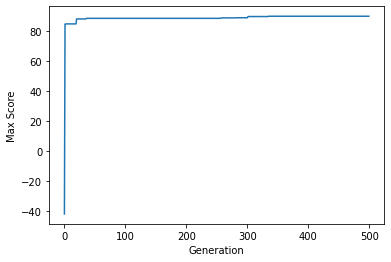

In [53]:
x = []
y = []
for i in range(500):
    x.append(i)
for score in allScores:
    y.append(score[1])
plt.xlabel('Generation')
plt.ylabel('Max Score')
plt.plot(x, y)
plt.show()

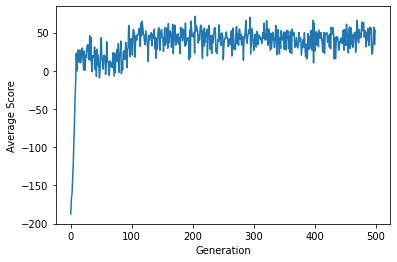

In [54]:
x = []
y = []
for i in range(500):
    x.append(i)

for score in allScores:
    y.append(score[2])
plt.xlabel('Generation')
plt.ylabel('Average Score')
plt.plot(x, y)
plt.show()